**last update: 08/20/2024**  

This notebook is for Bayesian Gaussian process regression test.

Dataset: 2*2 spatial average in latitude (4,6) longitude (36,38). CMIP6 annually, 1850 -2100. 13 models. Short-term oscillations(<10years) & mid-term oscillations(~30years). Consider long-term trend with KGCM.

Goal: Select proper kernel structures for CMIP6 data.

Design: Test different kernel structures with CMIP6 annual data and give evaluations(log marginal likelihood, recorded in the markdown cell) for some specific kernels(using methods to control the evolving amplitude, periods and noise), considering the evolving uncertainty with more observation years.

Note: In this notebook, there is cross validation(leave-one-out) for 2 rounds(one for kernel structure's selection, one for hyperparameter tuning(not included in this notebook)). Use the mean value of other models as prior, one model as the virtual observation and plot. Each model will be taken as the virtual observation once(1 round), and the total lml for all the models(all rounds) is used as the evaluation.

# Package

In [1]:
import numpy as np
from sklearn.model_selection import GridSearchCV
from tqdm import tqdm
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, WhiteKernel, ExpSineSquared, ConstantKernel as C
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import RandomizedSearchCV, ParameterGrid
from scipy.optimize import minimize
from pyswarm import pso
from bayes_opt import BayesianOptimization
from scipy.linalg import cholesky, cho_solve,cho_factor,solve_triangular
from scipy.signal import periodogram, welch
from scipy.fft import fft
from statsmodels.tsa.stattools import acf
from sklearn.gaussian_process.kernels import Kernel, WhiteKernel, Matern, RationalQuadratic as RQ, ConstantKernel as C
from sklearn.preprocessing import PolynomialFeatures
from sklearn.gaussian_process import GaussianProcessRegressor
import pywt
from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C, Matern, RationalQuadratic, DotProduct
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from statsmodels.graphics.tsaplots import plot_acf
from bayes_opt import BayesianOptimization, UtilityFunction
from properscoring import crps_gaussian
from sklearn.preprocessing import StandardScaler
from sklearn.gaussian_process.kernels import RBF, WhiteKernel

# Data

In [6]:
rainfall = pd.read_csv('../data/CMIP5_sl/sl_annual_pr_1850-2099.csv')
rainfall = rainfall.set_index('years',drop=True)
rainfall.columns = [i+1 for i in range(rainfall.shape[1])]

In [7]:
rainfall_yearly = rainfall.copy()

for column in rainfall.columns:
    # Filter data before 1950
    historical_data = rainfall.loc[rainfall.index < 1950, column]
    
    # Calculate mean and std
    mean_value = historical_data.mean()
    std_value = historical_data.std()
    
    # Standardize the column using mean and std
    rainfall_yearly[column] = (rainfall[column] - mean_value) / std_value

# Save the standardized data to a new CSV file
# export_path = "../data/CMIP5_s/scaled_s_annual_pr_1850-2100.csv"
# rainfall_yearly.to_csv(export_path)

In [8]:
rainfall_yearly

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
years,,,,,,,,,,,,,,,,
1850,0.086345,0.542221,-0.141828,1.146047,-0.658061,0.421431,-1.701934,0.673893,-0.895340,-0.767157,-0.333772,-0.631533,-0.492528,0.638093,-0.388789,1.690828
1851,1.985922,-0.252222,0.451223,0.843989,-0.497116,0.190266,0.763562,0.855894,0.981897,-1.457419,-0.392156,1.036684,0.230683,-1.597849,1.947468,0.628230
1852,2.602910,1.179266,-0.596296,0.077971,-0.194518,0.574358,0.330422,1.944879,0.789533,-1.116613,-0.584602,1.420573,-0.075533,0.701084,0.781540,-0.438114
1853,1.985626,-1.249917,-0.348417,2.703393,-0.110570,0.458620,1.664110,-1.061454,-0.292365,0.903706,-0.284351,2.084175,-1.312943,-1.135932,1.157961,-0.324394
1854,-1.965990,-1.310694,-0.892867,0.834310,-0.807035,-0.033678,0.668977,0.559163,-0.470500,-0.710528,-1.003196,-0.989713,-0.945519,1.009698,1.933684,-1.370892
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2095,1.379288,-0.435256,2.993433,0.497349,8.876866,5.154503,0.474004,2.175901,1.026607,1.957597,-2.250458,0.074354,0.570307,-1.923996,-0.847526,0.395387
2096,2.033525,0.304036,1.355121,1.906137,2.736184,3.643896,-1.597353,-0.545395,2.584028,0.754505,-1.250567,2.009336,1.495377,-0.975265,-1.267502,-0.509443
2097,2.782337,-0.858553,2.408544,2.698819,5.009915,1.995328,0.000910,3.763284,4.474386,-0.483986,0.492938,2.063464,2.899322,0.996662,-1.641450,1.104590


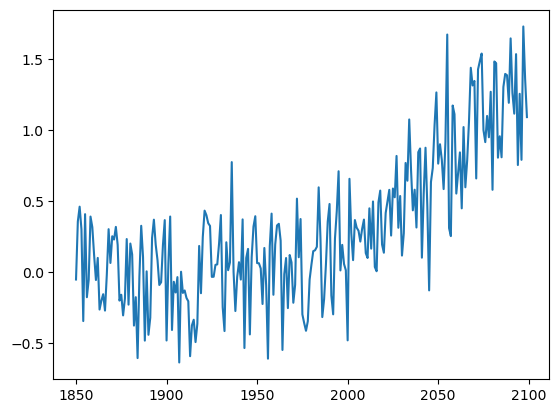

In [9]:
plt.plot(rainfall_yearly.T.mean())

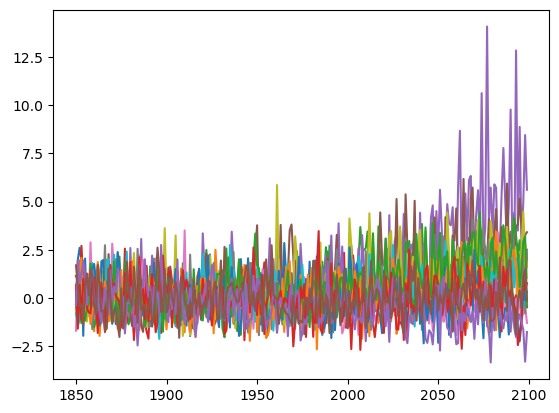

In [10]:
plt.plot(rainfall_yearly)

In [11]:
mod_ids = range(0, rainfall_yearly.shape[1])
Nobs = 166 # 1850-2015
year = np.array(rainfall_yearly.index)

# Periodic Analysis

In [12]:
# Function to plot and return the top 3 periodicities for each method
def analyze_periodicity(data):
    results = {}
    
    # Convert data to numpy array for FFT
    data = np.asarray(data)
    
    # Fourier Transform
    N = len(data)
    T = 1.0
    yf = fft(data)
    xf = np.fft.fftfreq(N, T)[:N//2]
    fft_amplitudes = 2.0/N * np.abs(yf[0:N//2])
    
    # Avoid division by zero
    non_zero_freqs = xf != 0
    xf = xf[non_zero_freqs]
    fft_amplitudes = fft_amplitudes[non_zero_freqs]
    
    fft_peaks = np.argsort(fft_amplitudes)[-3:]
    fft_periods = 1 / xf[fft_peaks]
    results['FFT'] = fft_periods
    
    # Wavelet Transform
    widths = np.arange(1, 31)
    cwt_matr = pywt.cwt(data, widths, 'mexh')[0]
    wavelet_power = np.sum(cwt_matr**2, axis=1)
    wavelet_peaks = np.argsort(wavelet_power)[-3:]
    wavelet_periods = widths[wavelet_peaks]
    results['Wavelet'] = wavelet_periods
    
    # Autocorrelation
    autocorr = acf(data, nlags=N//2)
    autocorr_peaks = np.argsort(autocorr)[-3:]
    results['Autocorrelation'] = autocorr_peaks
    
    # Power Spectral Density
    freqs, psd = periodogram(data)
    non_zero_freqs = freqs != 0
    freqs = freqs[non_zero_freqs]
    psd = psd[non_zero_freqs]
    
    psd_peaks = np.argsort(psd)[-3:]
    psd_periods = 1 / freqs[psd_peaks]
    results['PSD'] = psd_periods
    
    return results

# Perform the analysis for each of the 16 models
all_results = []
for col in rainfall_yearly.columns:
    data = rainfall_yearly[col]
    results = analyze_periodicity(data)
    all_results.append(results)

# Aggregate and print the results
for method in ['FFT', 'Wavelet', 'Autocorrelation', 'PSD']:
    print(f"Top 3 periodicities for {method}:")
    for i, result in enumerate(all_results):
        print(f"Model {i+1}: {result[method]}")
    print("\n")

Top 3 periodicities for FFT:
Model 1: [  2.03252033 125.         250.        ]
Model 2: [3.57142857 3.125      4.90196078]
Model 3: [  2.29357798  41.66666667 250.        ]
Model 4: [  2.10084034   7.8125     250.        ]
Model 5: [ 83.33333333 125.         250.        ]
Model 6: [  5. 125. 250.]
Model 7: [  2.27272727 125.         250.        ]
Model 8: [  2.63157895 125.         250.        ]
Model 9: [  2.94117647   5.20833333 250.        ]
Model 10: [  3.08641975   2.3364486  250.        ]
Model 11: [35.71428571  4.16666667  8.92857143]
Model 12: [  4.62962963   4.80769231 250.        ]
Model 13: [  5.43478261 125.         250.        ]
Model 14: [2.90697674 5.         5.43478261]
Model 15: [  4.71698113  17.85714286 250.        ]
Model 16: [6.94444444 3.08641975 3.42465753]


Top 3 periodicities for Wavelet:
Model 1: [28 29 30]
Model 2: [12 29 30]
Model 3: [28 29 30]
Model 4: [28 29 30]
Model 5: [28 29 30]
Model 6: [28 29 30]
Model 7: [28 29 30]
Model 8: [28 29 30]
Model 9: [28 2

# Function

In [13]:
def log_marginal_likelihood_manual(kernel, y_train):
    L = np.linalg.cholesky(kernel)
    alpha = cho_solve((L, True), y_train)
    log_likelihood = -0.5 * np.dot(y_train.T, alpha)
    log_likelihood -= np.sum(np.log(np.diag(L)))
    log_likelihood -= len(y_train) / 2 * np.log(2 * np.pi)
    return log_likelihood

def Choleskey_trick(A, diff, K_os):
    L = np.linalg.cholesky(A)
    alpha = np.linalg.solve(L.T, np.linalg.solve(L, diff))
    v = np.linalg.solve(L, K_os)
    return alpha, v, L

def compute_prior_and_posterior(K_full, y_train, y_test, Nobs):
    N_all = Nobs * 2 
    
    K_o = K_full[:Nobs, :Nobs] 
    K_s = K_full[Nobs:, Nobs:] 
    K_os = K_full[:Nobs, Nobs:] 

    tmp = np.vstack((y_train.iloc[:Nobs, :], y_train))
    smoothedMean = np.mean(tmp, axis=1)
    mu = smoothedMean[:Nobs] 
    mu_s = smoothedMean[Nobs:]  

    y = y_test[:Nobs].values
    diff = y - mu
    if diff.ndim == 1:
        diff = diff[:, np.newaxis]

    A = K_o + 1e-6 * np.eye(K_o.shape[0])
    eigenvalues = np.linalg.eigvalsh(A)
    assert np.all(eigenvalues >= 0)
    
    alpha, v, L = Choleskey_trick(A, diff, K_os)
    
    f = mu_s + np.dot(K_os.T, alpha).ravel()  
    
    Sigma_s = K_s - np.dot(v.T, v)
    
    y_test_part = y_test[Nobs:].values
    mu_test_part = mu_s[-len(y_test_part):]
    diff_test = y_test_part - mu_test_part  
    if diff_test.ndim == 1:
        diff_test = diff_test[:, np.newaxis]

    K_test = K_full[N_all:, N_all:] 

    A_test = K_test + 1e-6 * np.eye(K_test.shape[0])

    K_test_os = K_full[N_all:, :Nobs]
    alpha_test, v_test, L_test = Choleskey_trick(A_test, diff_test, K_test_os)

    lml = -0.5 * (np.dot(diff_test.T, alpha_test) + 2 * np.sum(np.log(np.diag(L_test)))).item()
    prior_mu = mu_s
    prior_cov = K_s
    post_mu = f
    post_cov = Sigma_s

    return prior_mu, prior_cov, post_mu, post_cov, lml



In [14]:
def kernel_selection(mod_ids, Nobs, data, pbounds, kernel_func):
    np.float = np.float64

    def compute_KGCM(training_data, Nobs):
        tmp = np.vstack((training_data.iloc[:Nobs, :], training_data))
        smoothedCov = np.cov(tmp, rowvar=True)
        KGCM = (16 / 15) * smoothedCov
        return KGCM

    def gp_target(train_data, KGCM, current_mod_ids, **params):
        total_lml = 0.0
        kernel = kernel_func(params)
        for mod_id in current_mod_ids:
            if mod_id >= train_data.shape[1]:
                print(f"mod_id {mod_id} is out of bounds for train_data with {train_data.shape[1]} columns.")
                continue
            try:
                oos_gcm = train_data.iloc[:, mod_id].values
            except IndexError as e:
                print(f"IndexError for mod_id {mod_id}: {e}")
                continue

            X_train = np.arange(Nobs).reshape(-1, 1)
            y_train = oos_gcm[:Nobs]

            try:
                K_kernel = kernel(X_train, X_train)
                K_combined = K_kernel + KGCM + 1e-6 * np.eye(K_kernel.shape[0])
                lml = log_marginal_likelihood_manual(K_combined, y_train)
                
                if np.isreal(lml):
                    total_lml += lml
                else:
                    total_lml -= np.inf
            except (TypeError, np.linalg.LinAlgError) as e:
                print("Error in kernel construction or GP fitting:", e)
                total_lml -= np.inf

        return total_lml

    total_lml_sum = 0.0
    
    for i in range(len(mod_ids)):
        print(f"Starting iteration {i+1} out of {len(mod_ids)}")
        
        train_mod_ids = [mod_id for idx, mod_id in enumerate(mod_ids) if idx != i]
        test_mod_id = mod_ids[i]
        
        if test_mod_id >= len(data.columns):
            print(f"Test mod_id {test_mod_id} is out of bounds for data with {len(data.columns)} columns.")
            continue
        
        train_data = data.iloc[:, train_mod_ids]
        test_data = data.iloc[:, test_mod_id]
        KGCM = compute_KGCM(train_data, Nobs)
        KGCM_o = KGCM[:Nobs, :Nobs]
        
        optimizer = BayesianOptimization(
            f=lambda **params: gp_target(train_data, KGCM_o, list(range(len(train_mod_ids))), **params), 
            pbounds=pbounds, 
            random_state=90
        )

        init_points = 50
        n_iter = 50

        best_params = None

        with tqdm(total=init_points + n_iter, desc=f"Optimization Progress (iteration {i+1})") as pbar:
            try:
                optimizer.maximize(init_points=init_points, n_iter=n_iter)
                pbar.update(init_points + n_iter)
            except Exception as e:
                print("An error occurred during optimization:", e)
                if 'params' in optimizer.max:
                    best_params = optimizer.max['params']
                    kernel = kernel_func(best_params)
                else:
                    best_params = None

                    
        print(f"Iteration {i+1} - Best objective function value: {optimizer.max['target']}")
        
        if best_params is not None:
            try:
                kernel = kernel_func(best_params)
                print("Best kernel is:", kernel)

                X_full = np.arange(data.shape[0]+Nobs).reshape(-1, 1)
                K_full = kernel(X_full, X_full)
                prior_mu, prior_cov, post_mu, post_cov, lml_all = compute_prior_and_posterior(K_full, train_data, test_data, Nobs)

                if np.isreal(lml_all):
                    total_lml_sum += lml_all
                    print(f"Iteration {i+1} - test lml: {lml_all}")
                else:
                    total_lml_sum -= np.inf

                plot_prior_posterior(year, test_data, prior_mu, prior_cov, post_mu, post_cov)

            except KeyError:
                print("No valid parameters found after the optimization process.")
                continue
            
    print(f"Total log marginal likelihood sum for the kernel structure: {total_lml_sum}")
    return total_lml_sum


In [15]:
def plot_prior_posterior(X, obs, prior_mu, prior_cov, post_mu, post_cov):
    std_prior = np.sqrt(np.diag(prior_cov))
    std_post = np.sqrt(np.diag(post_cov))
    
    def rgb_to_normalized(rgb):
        return [x / 255.0 for x in rgb]
    
    plt.figure(figsize=(10, 6))
    plt.fill_between(X.flatten(), post_mu - 1.96*std_post, post_mu + 1.96*std_post, alpha=0.2, color=rgb_to_normalized((164, 81, 79)), label='Posterior 95% CI')
    plt.plot(X, obs, color=rgb_to_normalized((191, 177, 208)), label='Virtual Observation')
    plt.plot(X, prior_mu, color=rgb_to_normalized((255, 235, 173)), label='Prior Mean')
    # plt.fill_between(X.flatten(), prior_mu - 1.96*std_prior, prior_mu + 1.96*std_prior, alpha=0.2, color='blue', label='Prior 95% CI')
    plt.plot(X, post_mu, color=rgb_to_normalized((164, 81, 79)), label='Posterior Mean')
    plt.axvline(x=year[Nobs], color='grey', linestyle='--', label='Historical/Future Split')
    plt.title('Prior vs Posterior')
    plt.xlabel('X')
    plt.ylabel('y')
    plt.legend()
    plt.show()



# Kernel Selection

Test different kernels. Note that '_' means the sum of kernel, and kernel1kernel2 means kernel1*kernel2. Number means how many kernels we use of the same structure.

With other kernels to be implementation. Such as some kernels to make an addition or product.

## poly with narrow uncertainty

Starting iteration 1 out of 16


Optimization Progress (iteration 1):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.789e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.537e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.973e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.712e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.969e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.724e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 1):   0%|          | 0/100 [00:01<?, ?it/s]

|  47       | -8.723e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.598e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -8.355e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.117e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 1 - Best objective function value: -2686.190499351296
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)


Iteration 1 - test lml: -56.49978720491643


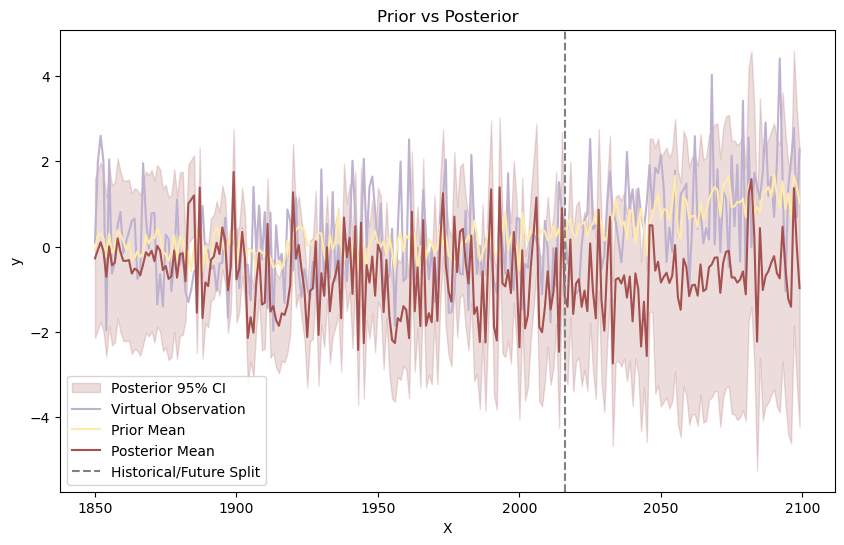

Starting iteration 2 out of 16


Optimization Progress (iteration 2):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.637e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.395e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.936e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.613e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.992e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.596e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 2):   0%|          | 0/100 [00:01<?, ?it/s]

Iteration 2 - Best objective function value: -2687.9048074416305
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)
Iteration 2 - test lml: -69.45276806657913


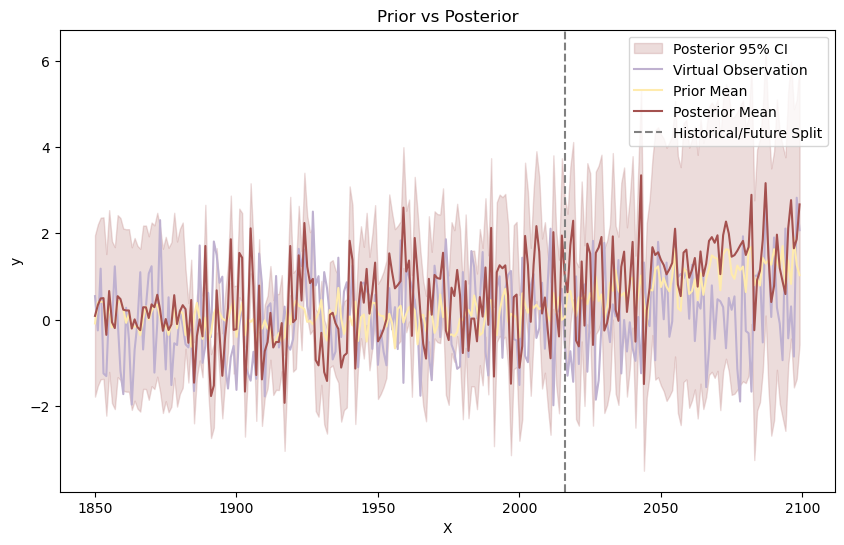

Starting iteration 3 out of 16


Optimization Progress (iteration 3):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -9.056e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.876e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.395e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -9.079e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.398e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -9.02e+07 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 3):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -8.793e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.321e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 3 - Best objective function value: -2689.971787640749
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)


Iteration 3 - test lml: -61.809405261514726


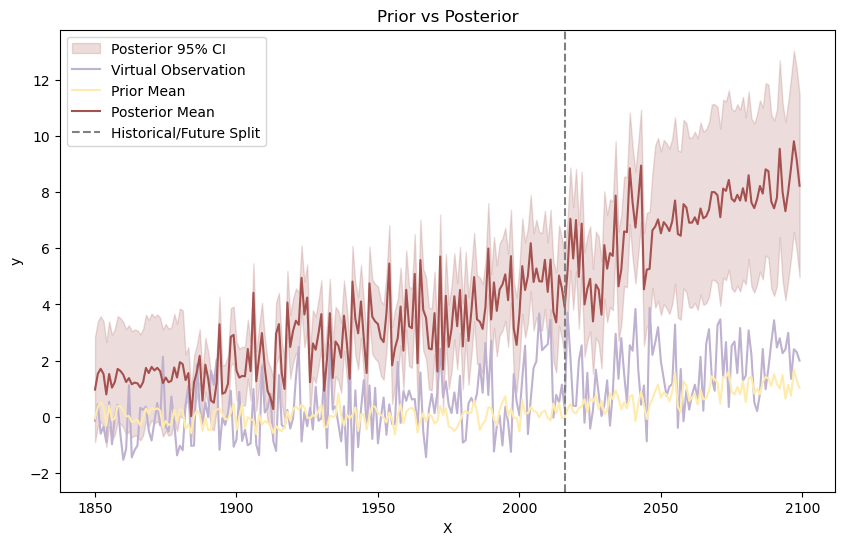

Starting iteration 4 out of 16


Optimization Progress (iteration 4):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.697e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.48e+07 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.151e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.816e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.226e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.429e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 4):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -8.727e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.176e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 4 - Best objective function value: -2685.614736285837
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)
Iteration 4 - test lml: -45.708958509294895


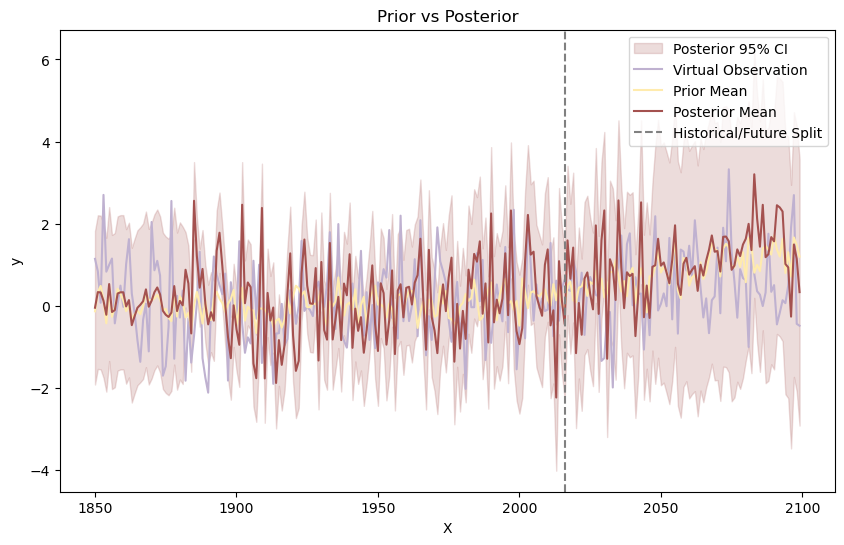

Starting iteration 5 out of 16


Optimization Progress (iteration 5):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.335e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.181e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.778e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.562e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.801e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.414e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 5):   0%|          | 0/100 [00:01<?, ?it/s]

|  50       | -8.848e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 5 - Best objective function value: -2683.394553682626
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)


Iteration 5 - test lml: -343.9702946035202


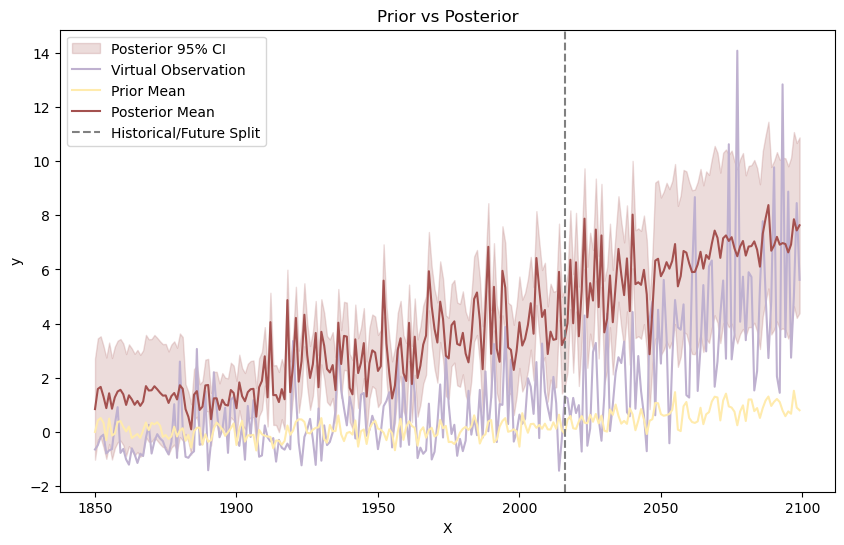

Starting iteration 6 out of 16


Optimization Progress (iteration 6):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.754e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.835e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.353e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.998e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.124e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.809e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 6):   0%|          | 0/100 [00:01<?, ?it/s]

|  47       | -8.923e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.779e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -8.63e+07 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.202e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 6 - Best objective function value: -2686.7635046540818
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)


Iteration 6 - test lml: -134.0836518621101


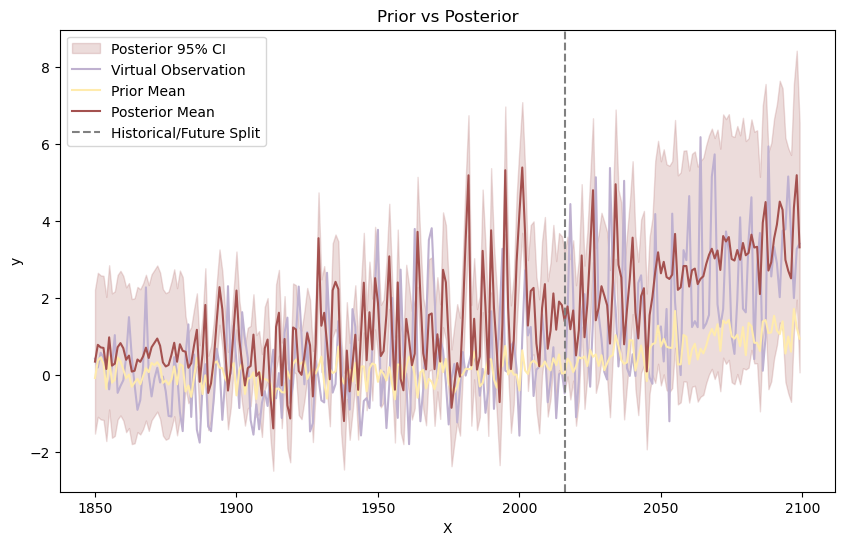

Starting iteration 7 out of 16


Optimization Progress (iteration 7):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -9.013e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -9.165e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.361e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -9.465e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.336e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -9.081e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 7):   0%|          | 0/100 [00:01<?, ?it/s]

|  48       | -6.744e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -8.629e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.632e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 7 - Best objective function value: -2692.7706039788477
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)


Iteration 7 - test lml: -40.07285584543456


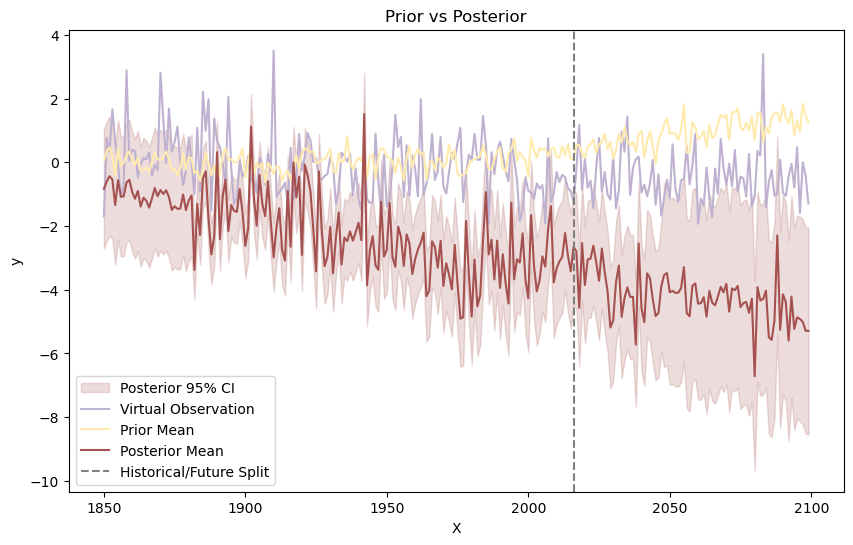

Starting iteration 8 out of 16


Optimization Progress (iteration 8):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -9.715e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -9.354e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.995e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -9.635e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.713e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -9.68e+07 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 8):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -8.968e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.97e+07 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 8 - Best objective function value: -2693.857974406957
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)


Iteration 8 - test lml: -81.0310281324633


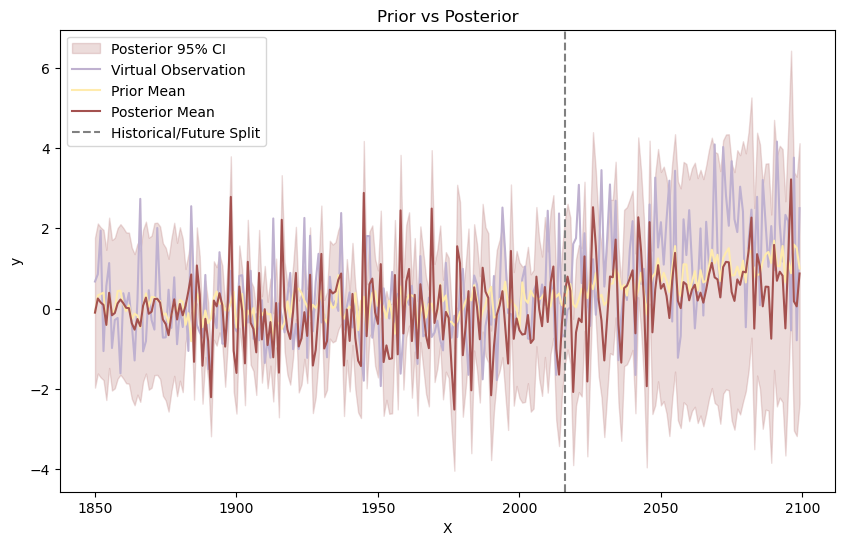

Starting iteration 9 out of 16


Optimization Progress (iteration 9):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.439e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.244e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.768e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.587e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.956e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.512e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 9):   0%|          | 0/100 [00:01<?, ?it/s]

|  48       | -6.39e+07 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -8.299e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -8.931e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 9 - Best objective function value: -2681.4145068789276
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)


Iteration 9 - test lml: -84.01850563342066


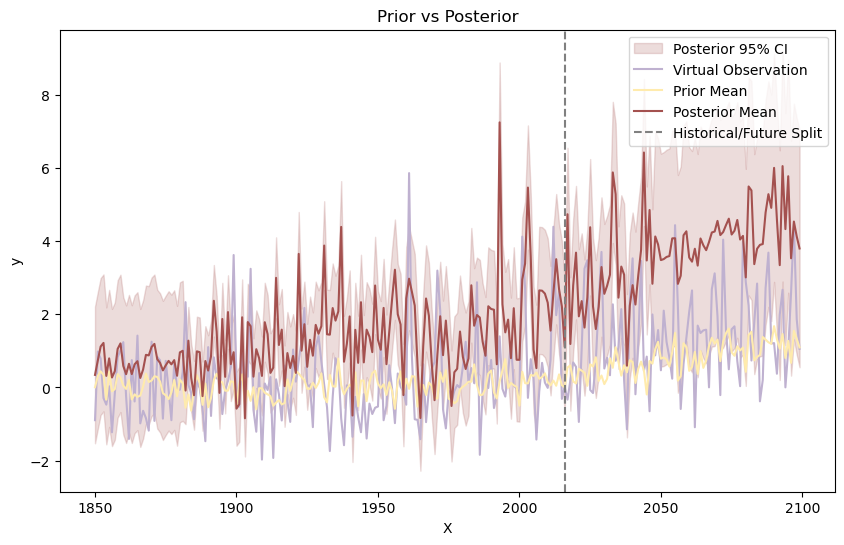

Starting iteration 10 out of 16


Optimization Progress (iteration 10):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.418e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.264e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.793e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.557e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.974e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.387e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 10):   0%|          | 0/100 [00:01<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 10 - Best objective function value: -2683.4763825491773
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)
Iteration 10 - test lml: -51.191213433587365


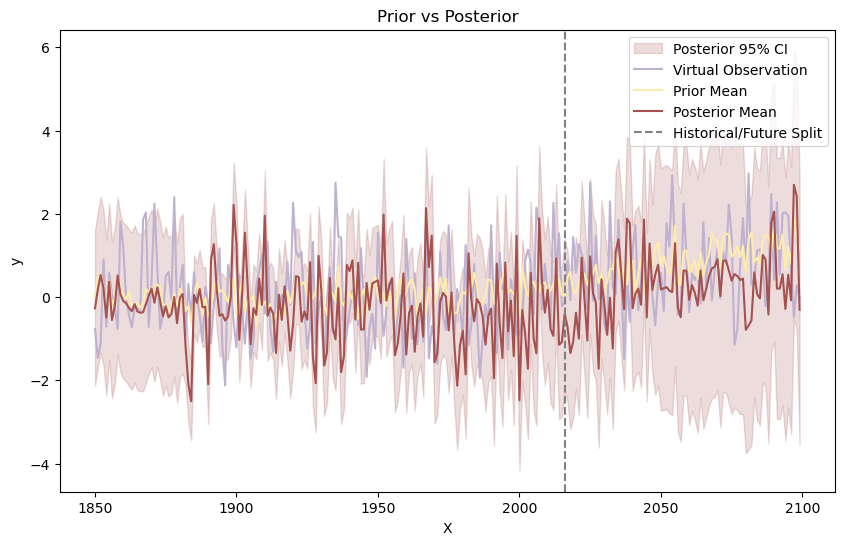

Starting iteration 11 out of 16


Optimization Progress (iteration 11):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.782e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.481e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.207e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.743e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.226e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.701e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 11):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -8.686e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.136e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 11 - Best objective function value: -2685.785034863516
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)


Iteration 11 - test lml: -56.86191970867993


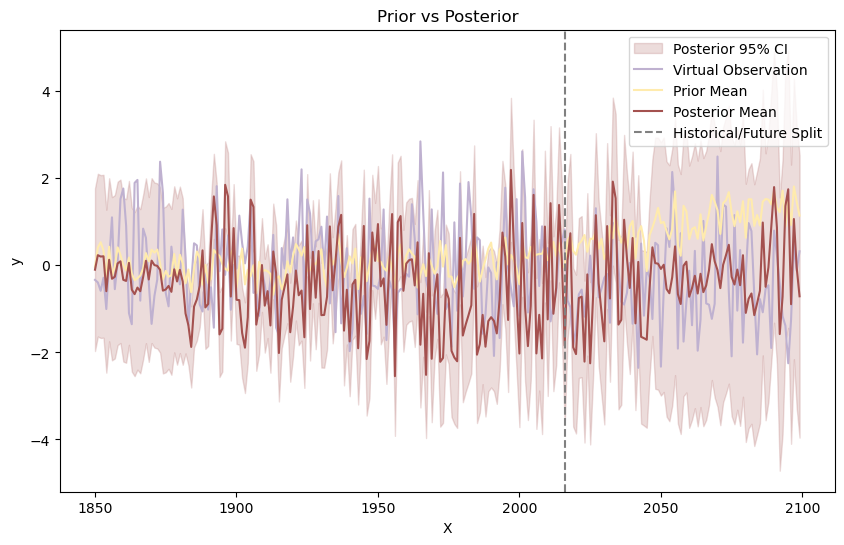

Starting iteration 12 out of 16


Optimization Progress (iteration 12):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.641e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.904e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.152e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.873e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.06e+07 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.657e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 12):   0%|          | 0/100 [00:01<?, ?it/s]

|  50       | -9.14e+07 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 12 - Best objective function value: -2687.0076096272833
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)


Iteration 12 - test lml: -35.38955249826827


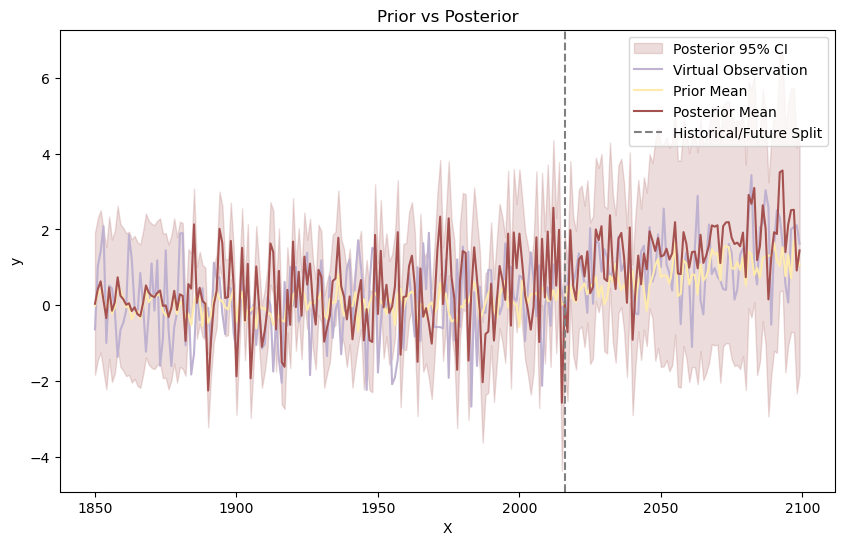

Starting iteration 13 out of 16


Optimization Progress (iteration 13):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.743e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.401e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.073e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.735e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.149e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.665e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 13):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -8.413e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.147e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 13 - Best objective function value: -2687.700305918336
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)


Iteration 13 - test lml: -60.50181846697472


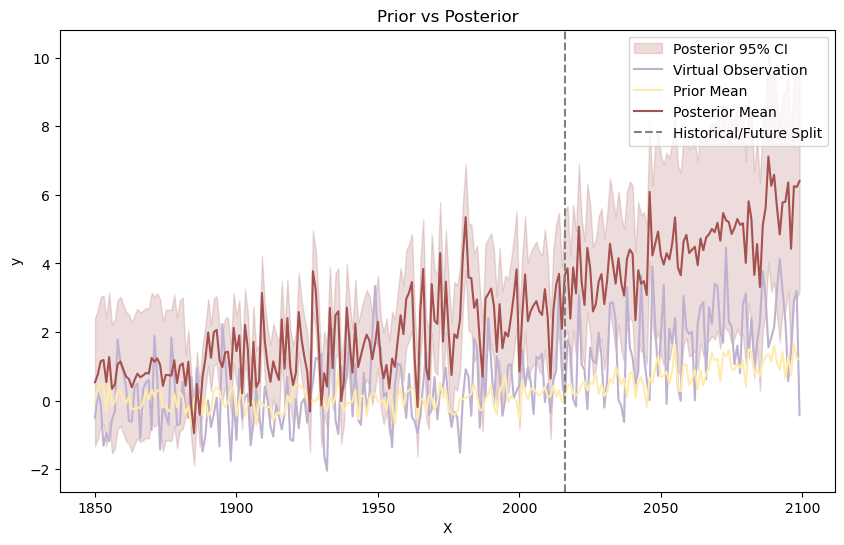

Starting iteration 14 out of 16


Optimization Progress (iteration 14):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.552e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.583e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.083e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.922e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.285e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.521e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 14):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -8.739e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.254e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 14 - Best objective function value: -2687.6660128042754
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)


Iteration 14 - test lml: -53.42731155015017


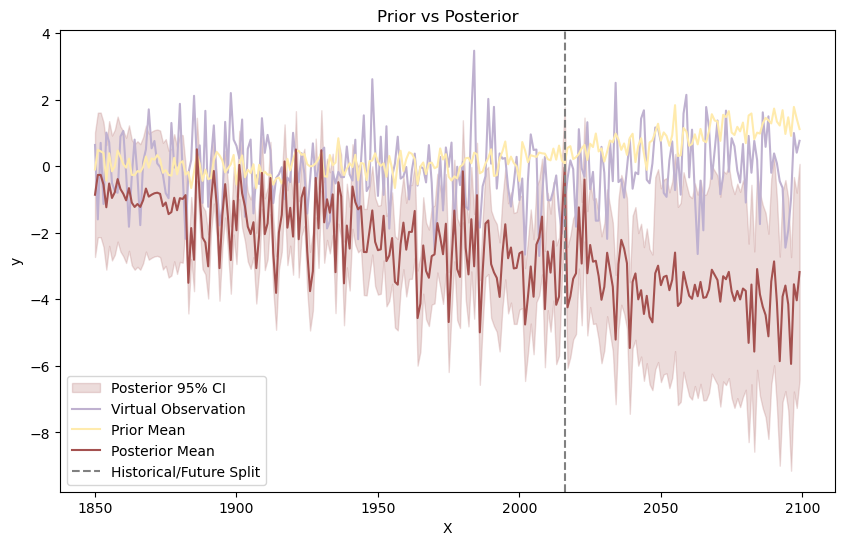

Starting iteration 15 out of 16


Optimization Progress (iteration 15):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.511e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.281e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.905e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.608e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.009e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.611e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 15):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -8.262e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.101e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 15 - Best objective function value: -2686.167137042636
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)
Iteration 15 - test lml: -65.20179958788997


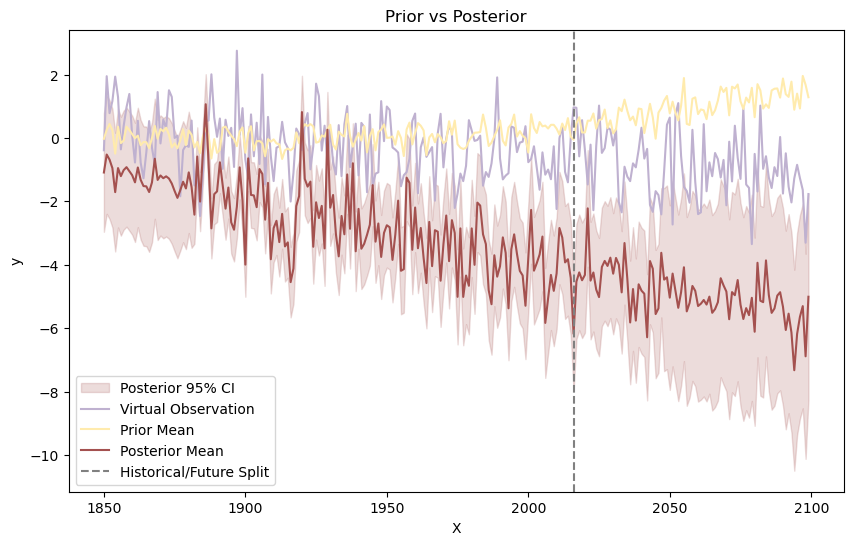

Starting iteration 16 out of 16


Optimization Progress (iteration 16):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -9.171e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -9.069e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.232e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -9.243e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.63e+07 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -9.278e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 16):   0%|          | 0/100 [00:01<?, ?it/s]

|  48       | -7.155e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -9.078e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.629e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 16 - Best objective function value: -2692.7215685658557
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)


Iteration 16 - test lml: -44.37457720759268


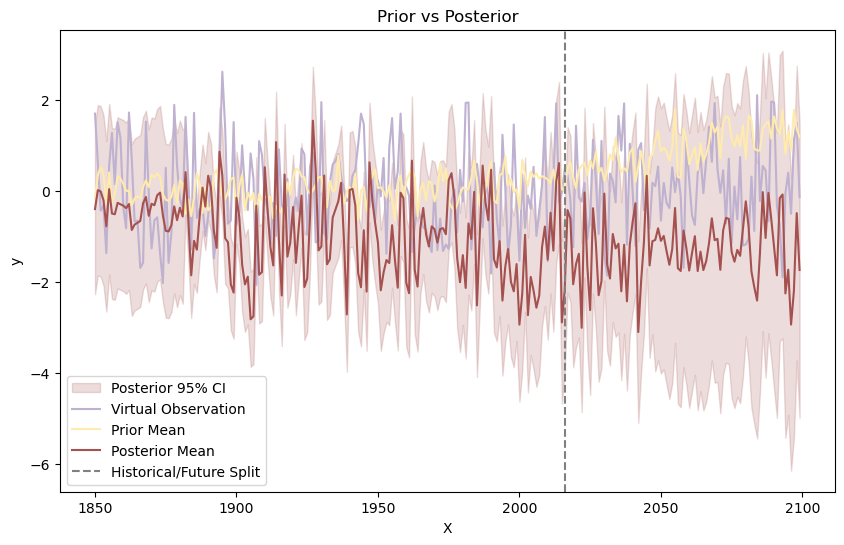

Total log marginal likelihood sum for the kernel structure: -1283.5954475723972


-1283.5954475723972

In [16]:
def time_dependent_noise(t, base_noise=1e-5, growth_rate=1e-4):
    return base_noise + growth_rate * t

def pe2_poly_growing_noise(best_params, Nobs=166):
    t = np.linspace(0, Nobs, Nobs)  
    noise_level = time_dependent_noise(t)
    kernel = (
        0.01 * C(best_params['c1']) * (DotProduct(sigma_0=best_params['dp_sigma_0']) ** 2) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        WhiteKernel(noise_level=noise_level.mean())
    )
    return kernel

pbounds = {
    'c1': (0.0000001, 0.000001),
    'c2': (0.1, 1),
    'c3': (0.1, 1),
    'ls1': (1e-2, 1e1),
    'per1': (3, 7),
    'ls2': (1e-2, 1e1),
    'per2': (3, 7),
    'noise': (1e-6, 1),  
    'dp_sigma_0': (1e-3, 10),
}

kernel_selection(mod_ids, Nobs, rainfall_yearly, pbounds, pe2_poly_growing_noise)


-1283.5954475723972

Starting iteration 1 out of 16


Optimization Progress (iteration 1):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.789e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.537e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.973e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.712e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.969e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.724e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 1):   0%|          | 0/100 [00:01<?, ?it/s]

 'x0' must only have one dimension.
Iteration 1 - Best objective function value: -2762.5244151122893
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 1 - test lml: -60.93014166883099


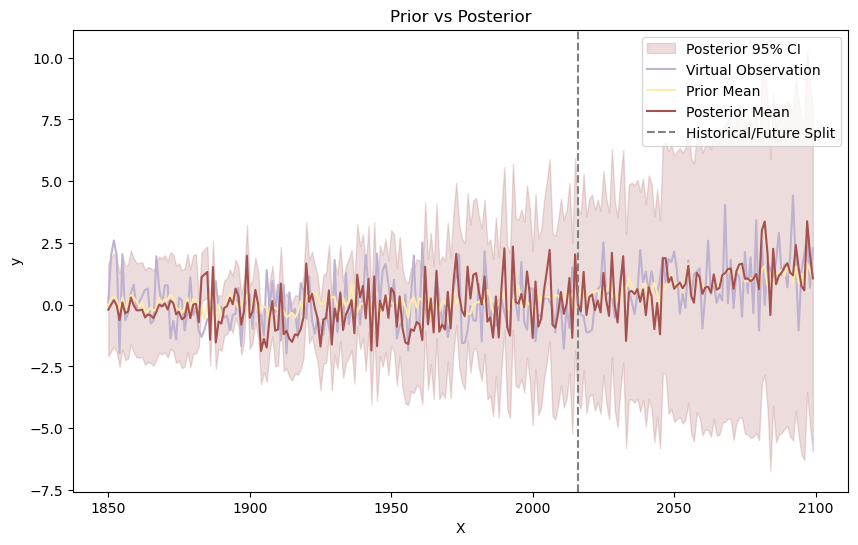

Starting iteration 2 out of 16


Optimization Progress (iteration 2):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.637e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.395e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.936e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.613e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.992e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.596e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 2):   0%|          | 0/100 [00:01<?, ?it/s]

|  50       | -9.046e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 2 - Best objective function value: -2762.890043915335
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 2 - test lml: -74.55434748231595


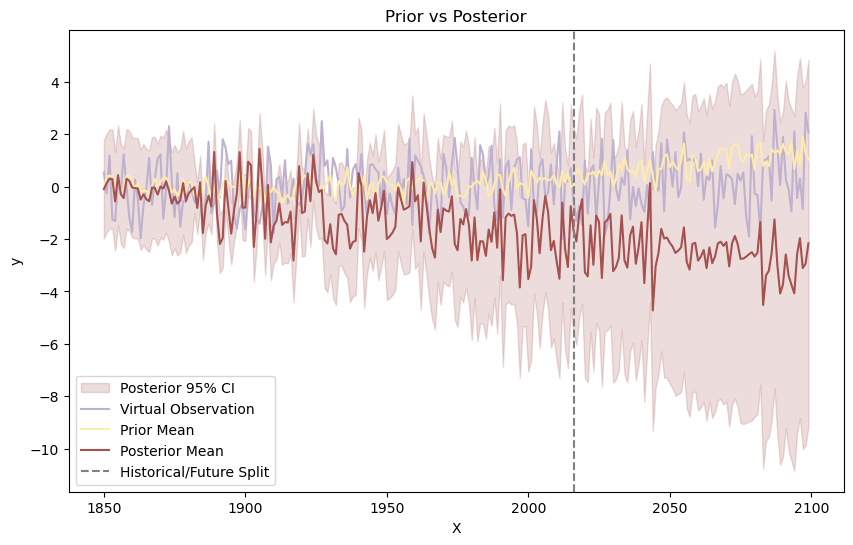

Starting iteration 3 out of 16


Optimization Progress (iteration 3):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -9.056e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.876e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.395e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -9.079e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.398e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -9.02e+07 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 3):   0%|          | 0/100 [00:01<?, ?it/s]

|  50       | -9.32e+07 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 3 - Best objective function value: -2766.14268424934
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 3 - test lml: -66.79825565229599


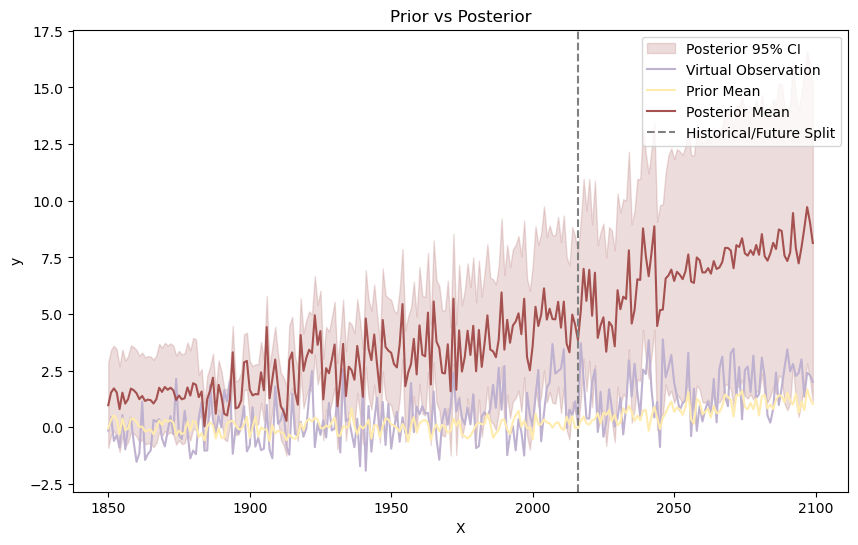

Starting iteration 4 out of 16


Optimization Progress (iteration 4):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.697e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.48e+07 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.15e+07 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.816e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.226e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.429e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 4):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -8.727e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.175e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 4 - Best objective function value: -2762.311926709976
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 4 - test lml: -50.14820927942468


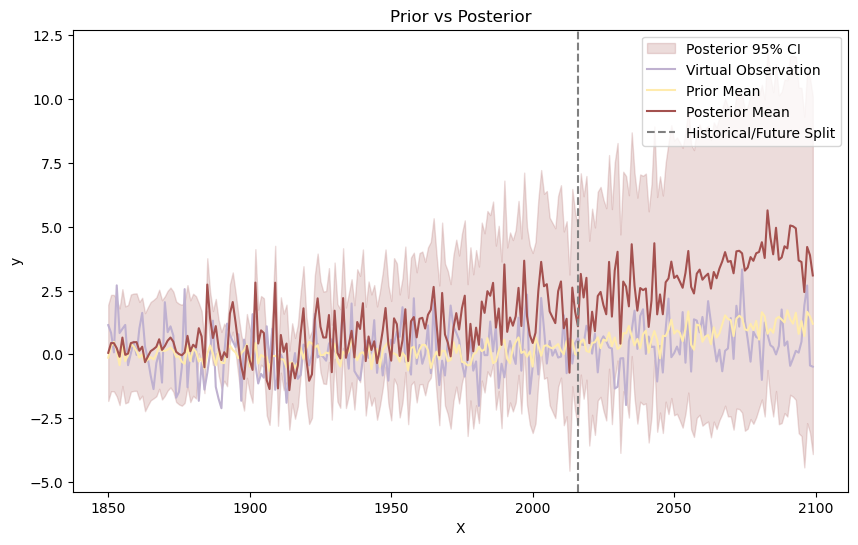

Starting iteration 5 out of 16


Optimization Progress (iteration 5):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.335e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.181e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.778e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.562e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.801e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.414e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 5):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -8.209e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -8.847e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 5 - Best objective function value: -2759.007834884451
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 5 - test lml: -304.609813465789


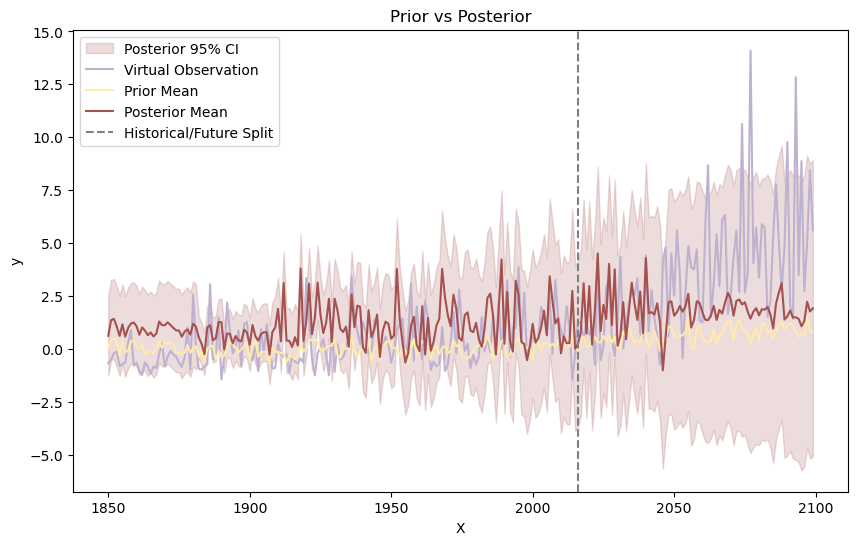

Starting iteration 6 out of 16


Optimization Progress (iteration 6):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.754e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.835e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.353e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.998e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.124e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.809e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 6):   0%|          | 0/100 [00:01<?, ?it/s]

|  50       | -9.201e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 6 - Best objective function value: -2762.0892431024968
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 6 - test lml: -137.70661014638932

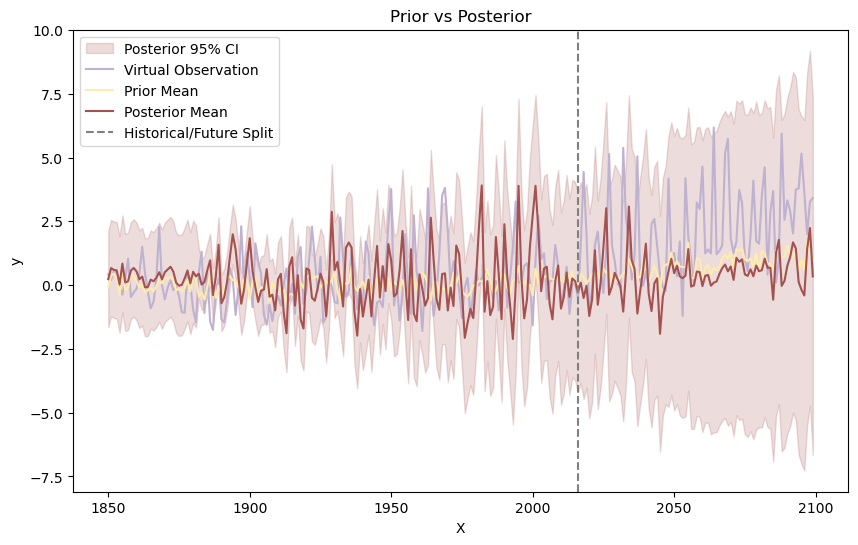

Starting iteration 7 out of 16


Optimization Progress (iteration 7):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -9.013e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -9.165e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.361e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -9.465e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.336e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -9.081e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 7):   0%|          | 0/100 [00:01<?, ?it/s]

|  48       | -6.744e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -8.629e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.631e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 7 - Best objective function value: -2768.6192926549497
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 7 - test lml: -44.45213387449494


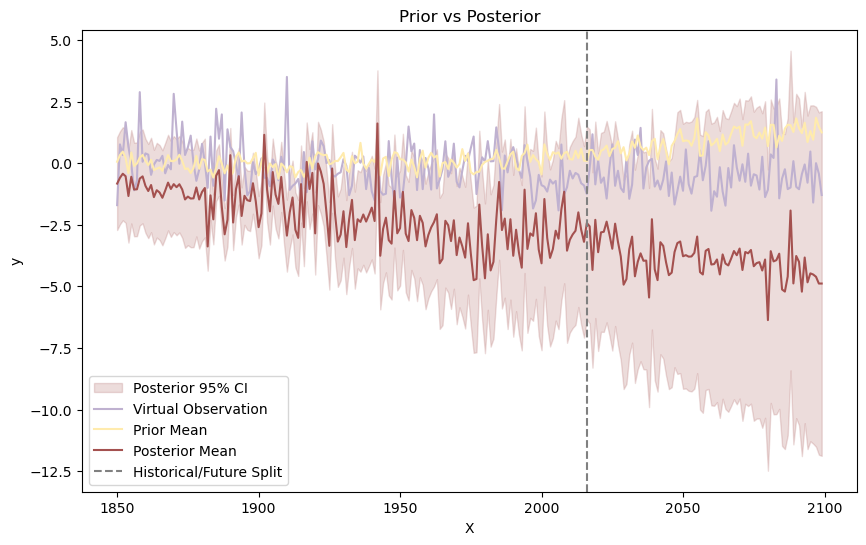

Starting iteration 8 out of 16


Optimization Progress (iteration 8):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -9.715e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -9.354e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.995e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -9.635e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.713e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -9.68e+07 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 8):   0%|          | 0/100 [00:01<?, ?it/s]

|  45       | -9.627e+0 |  1.8e-07  |  0.43     |  0.6646   |  3.652    |  9.409    |  5.716    |  0.2459   |  6.844    |  3.049    |
|  46       | -9.732e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -9.712e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -7.444e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -8.968e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.97e+07 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 8 - Best objective function value: -2770.772335218144
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0

Iteration 8 - test lml: -86.31660268609043


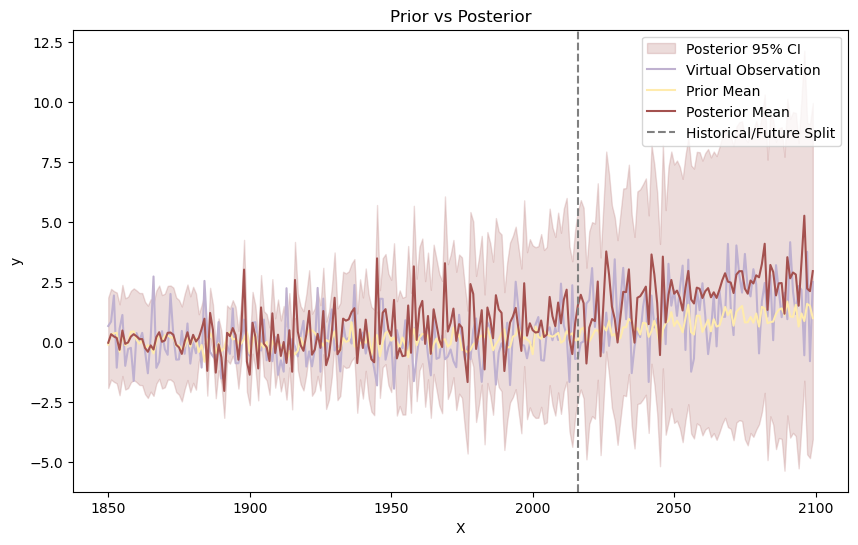

Starting iteration 9 out of 16


Optimization Progress (iteration 9):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.439e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.244e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.768e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.587e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.956e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.512e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 9):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -8.299e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -8.93e+07 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 9 - Best objective function value: -2757.7243309509113
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 9 - test lml: -89.1461916796702


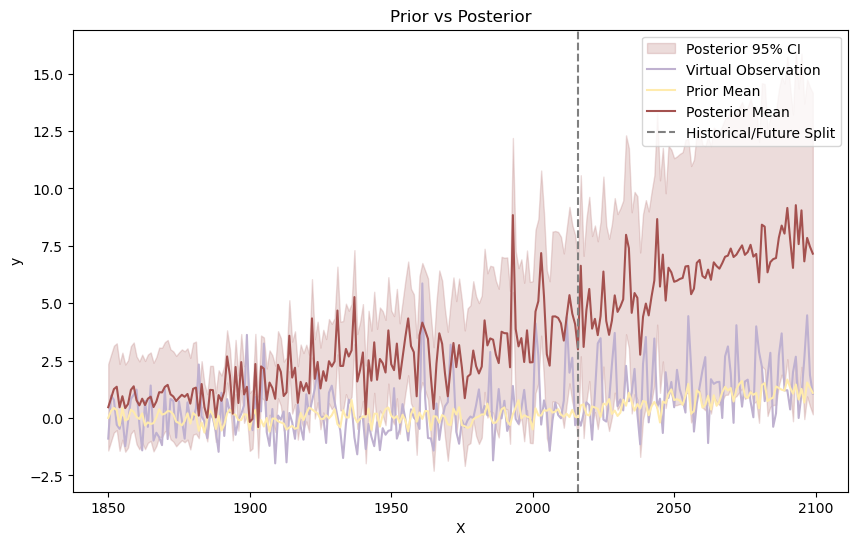

Starting iteration 10 out of 16


Optimization Progress (iteration 10):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.418e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.264e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.793e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.557e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.973e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.387e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 10):   0%|          | 0/100 [00:01<?, ?it/s]

|  50       | -8.962e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 10 - Best objective function value: -2759.9227635484435
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 10 - test lml: -55.71280707004222


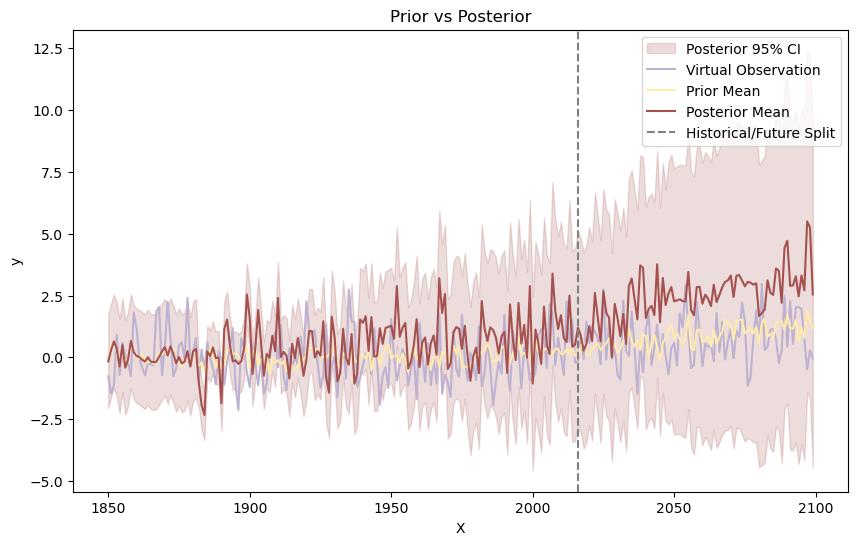

Starting iteration 11 out of 16


Optimization Progress (iteration 11):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.782e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.481e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.207e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.743e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.226e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.701e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 11):   0%|          | 0/100 [00:01<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 11 - Best objective function value: -2761.8458460131
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 11 - test lml: -61.275467642935844


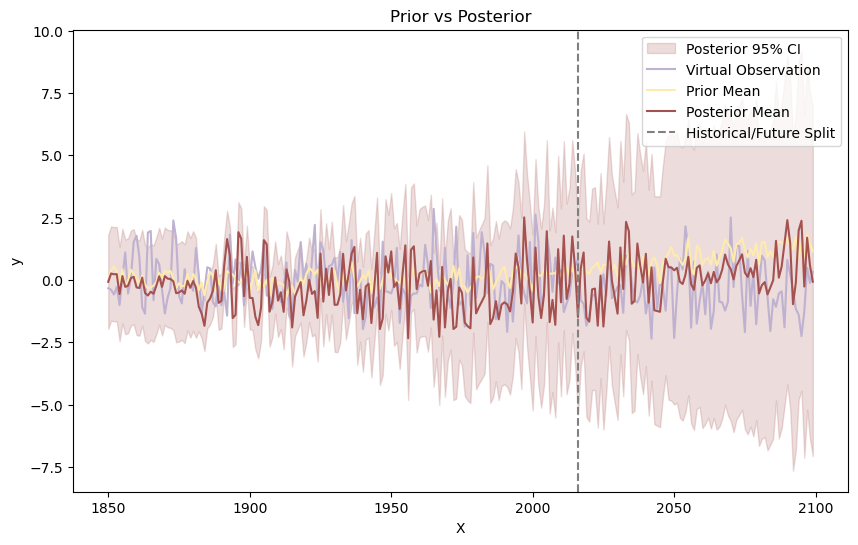

Starting iteration 12 out of 16


Optimization Progress (iteration 12):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.641e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.903e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.152e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.873e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.06e+07 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.657e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 12):   0%|          | 0/100 [00:01<?, ?it/s]

|  47       | -8.711e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.949e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -8.592e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.14e+07 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 12 - Best objective function value: -2763.489585944104
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 12 - test lml: -40.48180479335487


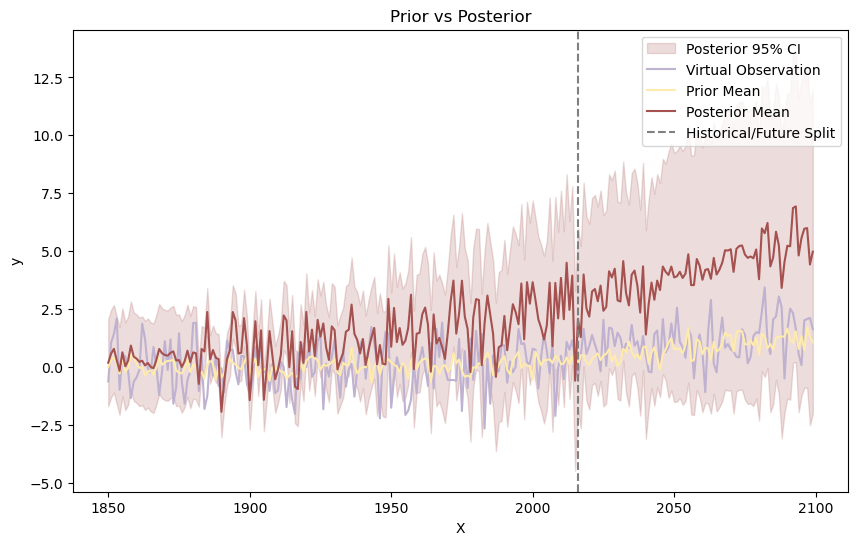

Starting iteration 13 out of 16


Optimization Progress (iteration 13):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.743e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.401e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.073e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.735e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.149e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.665e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 13):   0%|          | 0/100 [00:01<?, ?it/s]

|  48       | -6.671e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -8.413e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.146e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 13 - Best objective function value: -2763.763472642545
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 13 - test lml: -65.76868330115485


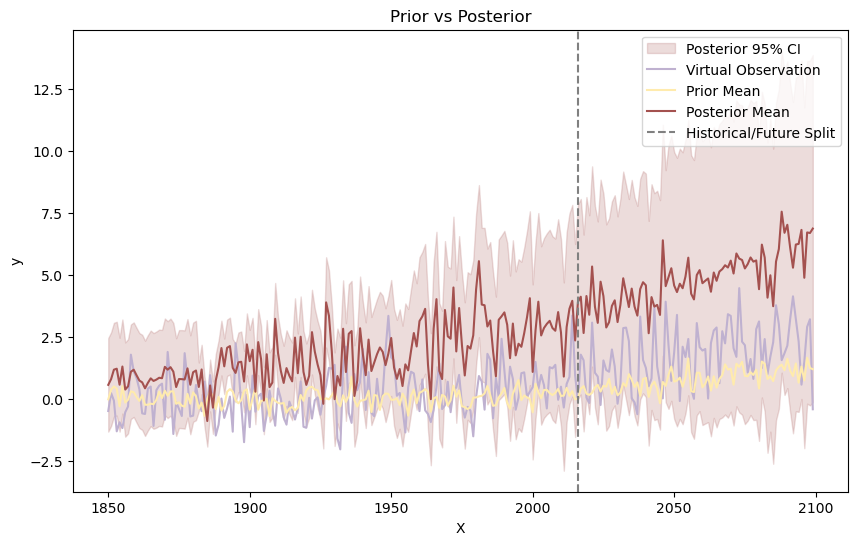

Starting iteration 14 out of 16


Optimization Progress (iteration 14):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.552e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.583e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.083e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.922e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.285e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.521e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 14):   0%|          | 0/100 [00:01<?, ?it/s]

|  48       | -6.707e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -8.739e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.253e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 14 - Best objective function value: -2763.111400151284
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 14 - test lml: -57.95799019558833


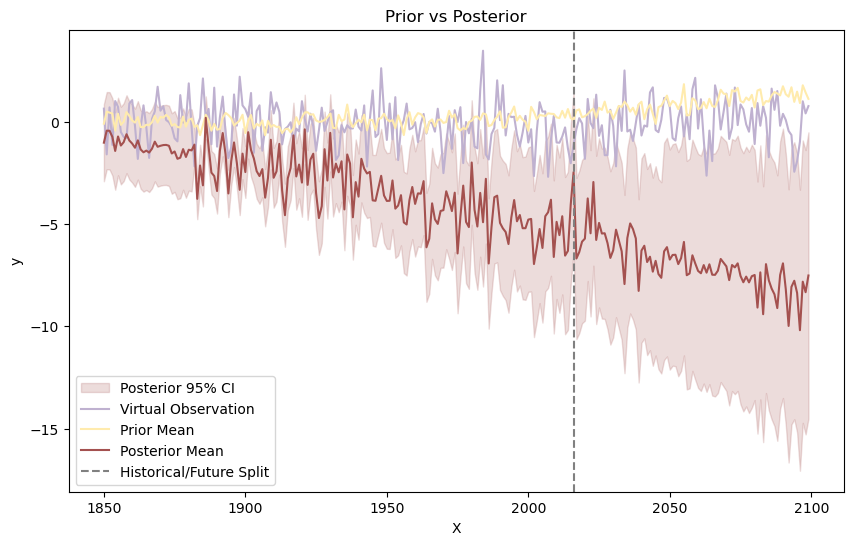

Starting iteration 15 out of 16


Optimization Progress (iteration 15):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.511e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.281e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.905e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.608e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.009e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.611e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 15):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -8.262e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.1e+07  |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 15 - Best objective function value: -2762.418510424725
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 15 - test lml: -64.3204866521808


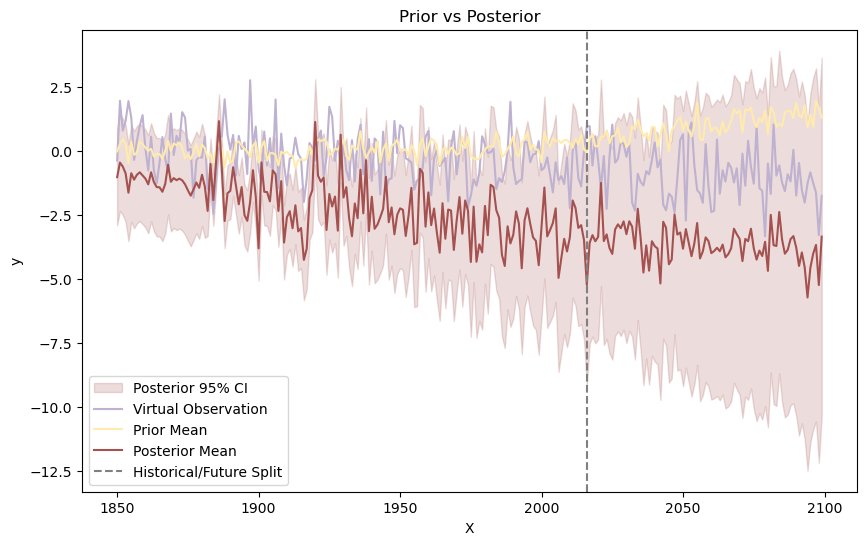

Starting iteration 16 out of 16


Optimization Progress (iteration 16):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -9.171e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -9.069e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.232e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -9.243e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.63e+07 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -9.278e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 16):   0%|          | 0/100 [00:01<?, ?it/s]

|  47       | -9.026e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -7.155e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -9.078e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.628e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 16 - Best objective function value: -2768.0413823030676
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 16 - test lml: -48.790900772546216


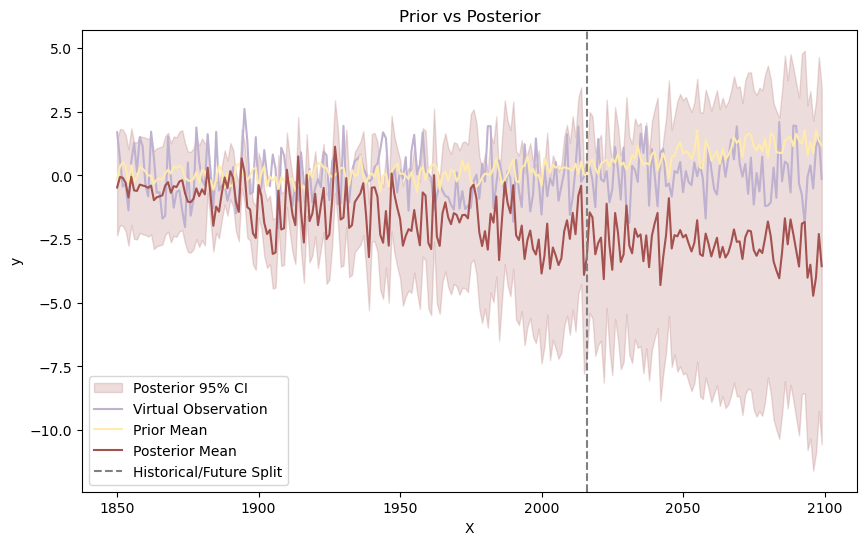

Total log marginal likelihood sum for the kernel structure: -1308.9704463631047


-1308.9704463631047

In [17]:
def pe2_poly(best_params, Nobs=166):
    t = np.linspace(0, Nobs, Nobs)
    weight_factor = 0.1  
    time_weight = 1 + weight_factor * t.mean()
    
    kernel = (
        time_weight * C(best_params['c1']) * (DotProduct(sigma_0=best_params['dp_sigma_0']) ** 2) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c1': (0.0000001, 0.000001),
    'c2': (0.1, 1),
    'c3': (0.1, 1),
    'ls1': (1e-2, 1e1),
    'per1': (3, 7),
    'ls2': (1e-2, 1e1),
    'per2': (3, 7),
    'noise': (1e-6, 1),
    'dp_sigma_0': (1e-3, 10),
}

kernel_selection(mod_ids, Nobs, rainfall_yearly, pbounds, pe2_poly)


-1308.9704463631047

Starting iteration 1 out of 16


Optimization Progress (iteration 1):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.792e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.546e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.979e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.714e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.974e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.726e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 1):   0%|          | 0/100 [00:02<?, ?it/s]

|  50       | -9.168e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 1 - Best objective function value: -2661.04360552045
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 1 - test lml: -54.26658867792725


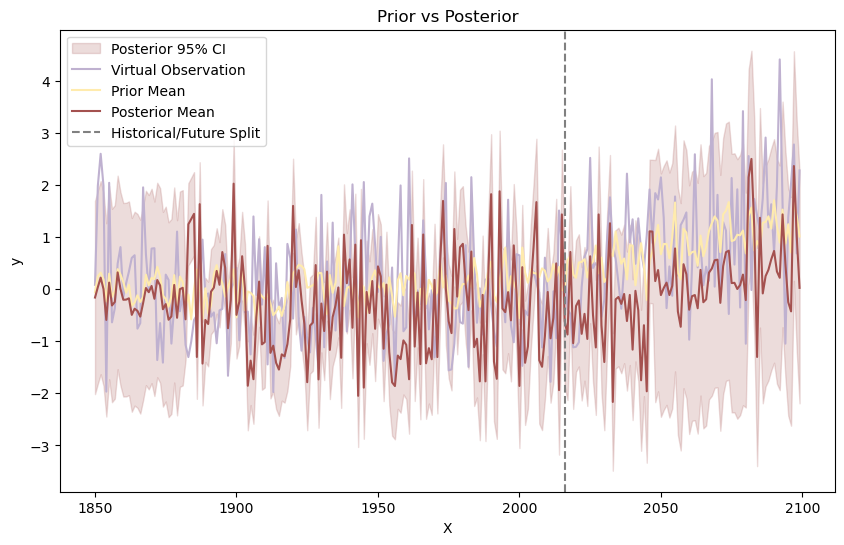

Starting iteration 2 out of 16


Optimization Progress (iteration 2):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.643e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.41e+07 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.945e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.615e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.999e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.6e+07  |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 2):   0%|          | 0/100 [00:01<?, ?it/s]

|  47       | -8.637e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.717e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -8.494e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.131e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 2 - Best objective function value: -2662.9030951981485
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 2 - test lml: -67.29957174717543


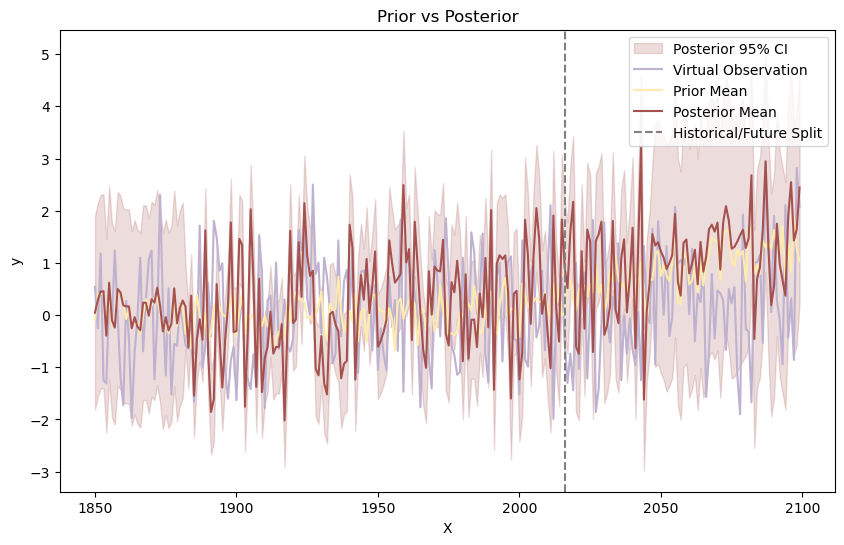

Starting iteration 3 out of 16


Optimization Progress (iteration 3):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -9.06e+07 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.89e+07 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.402e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -9.08e+07 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.402e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -9.023e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 3):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -8.794e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.377e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 3 - Best objective function value: -2663.2932269690327
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 3 - test lml: -59.73467773597947


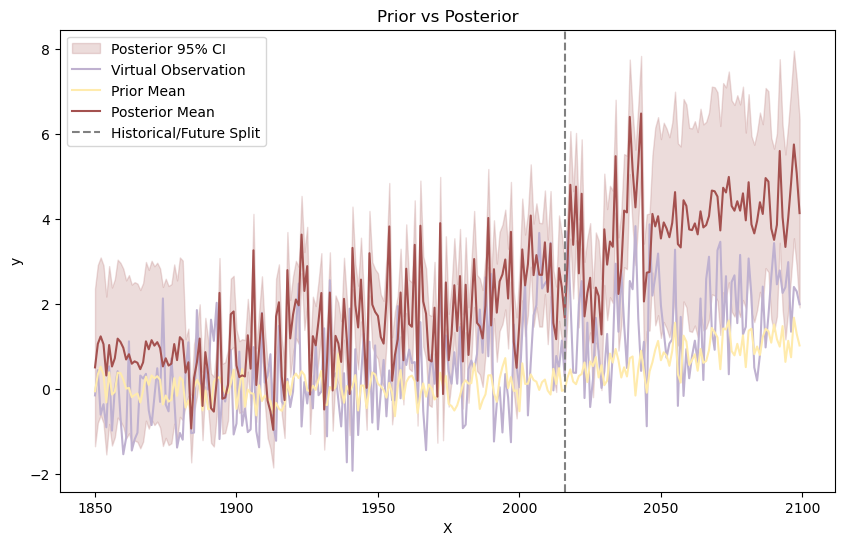

Starting iteration 4 out of 16


Optimization Progress (iteration 4):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.7e+07  |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.488e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.155e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.817e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.229e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.432e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 4):   0%|          | 0/100 [00:02<?, ?it/s]

|  49       | -8.728e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.217e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 4 - Best objective function value: -2660.4278220805672
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 4 - test lml: -43.54948579612024


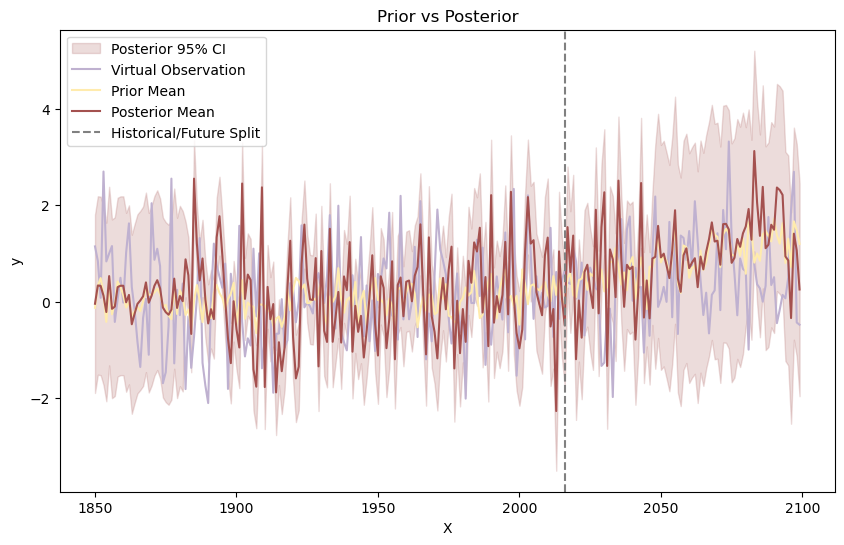

Starting iteration 5 out of 16


Optimization Progress (iteration 5):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.34e+07 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.194e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.786e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.563e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.807e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.417e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 5):   0%|          | 0/100 [00:02<?, ?it/s]

|  46       | -8.575e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -8.435e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.353e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -8.211e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -8.918e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.


Iteration 5 - Best objective function value: -2657.0149247065206
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 5 - test lml: -349.23175221078714


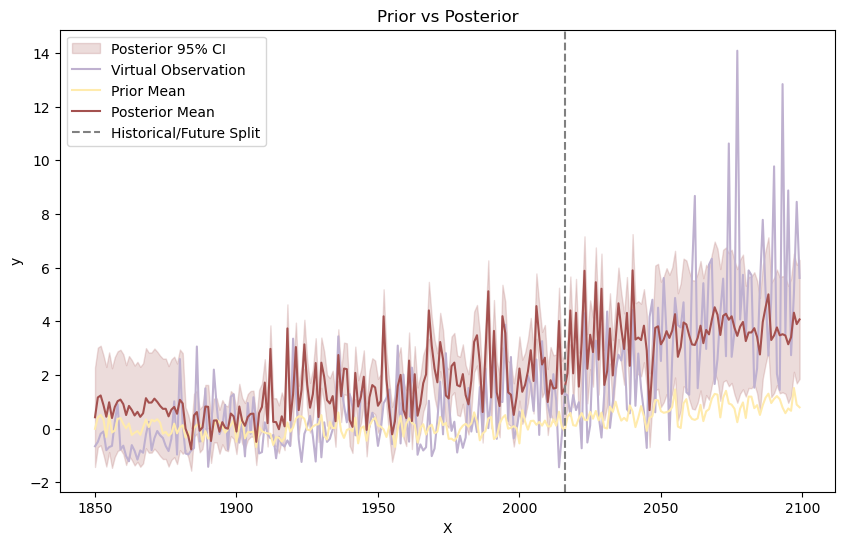

Starting iteration 6 out of 16


Optimization Progress (iteration 6):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.759e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.849e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.363e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -9e+07    |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.13e+07 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.813e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 6):   0%|          | 0/100 [00:01<?, ?it/s]

|  46       | -8.886e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -8.925e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.788e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -8.632e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.28e+07 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 6 - Best objective function value: -2660.715086256181
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicit

Iteration 6 - test lml: -132.68950166712983


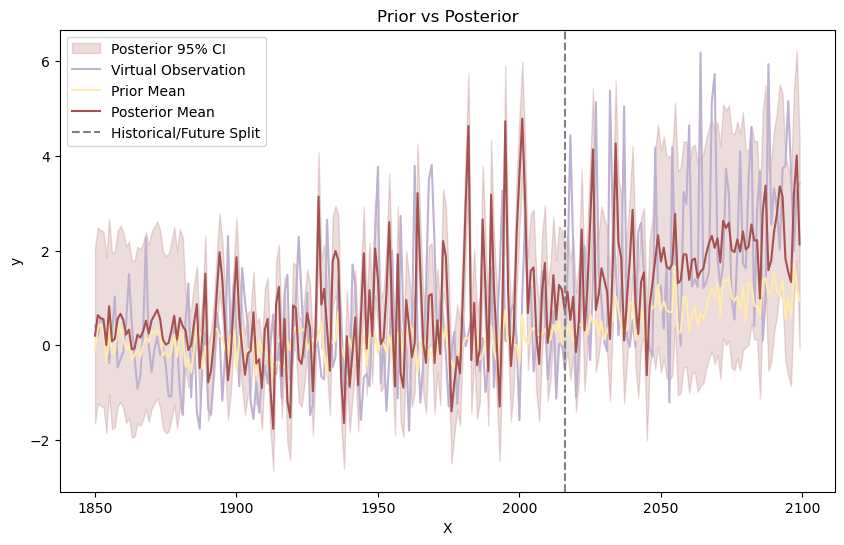

Starting iteration 7 out of 16


Optimization Progress (iteration 7):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -9.017e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -9.177e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.367e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -9.467e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.341e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -9.084e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 7):   0%|          | 0/100 [00:01<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 7 - Best objective function value: -2668.9370373213083
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 7 - test lml: -38.69384018782142


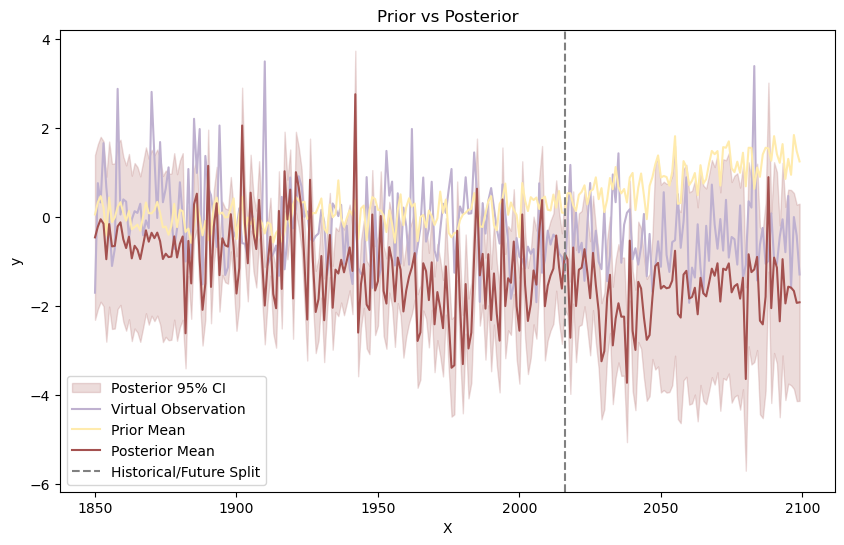

Starting iteration 8 out of 16


Optimization Progress (iteration 8):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -9.718e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -9.363e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.999e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -9.636e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.716e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -9.682e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 8):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -8.969e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -1.001e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 8 - Best objective function value: -2668.867124812851
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 8 - test lml: -78.87027720958457


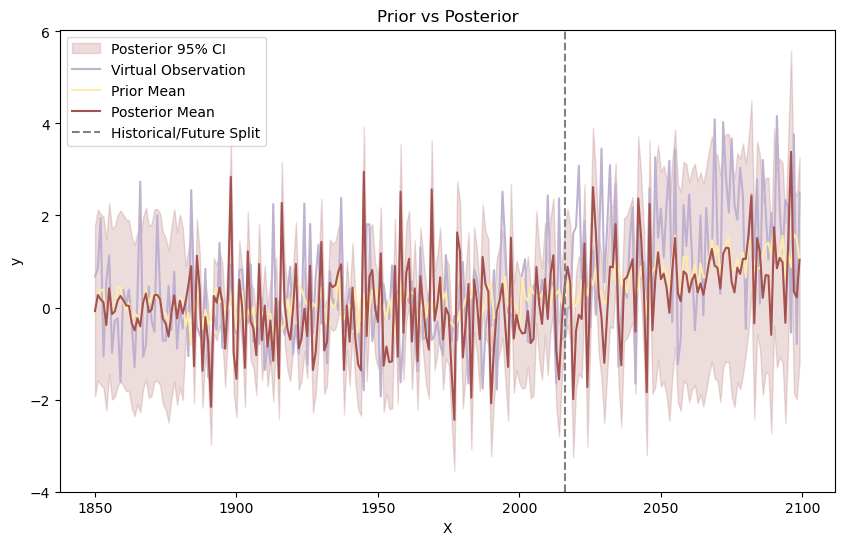

Starting iteration 9 out of 16


Optimization Progress (iteration 9):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.443e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.256e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.774e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.588e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.96e+07 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.515e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 9):   0%|          | 0/100 [00:01<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 9 - Best objective function value: -2655.6922734360023
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 9 - test lml: -81.82656722405964


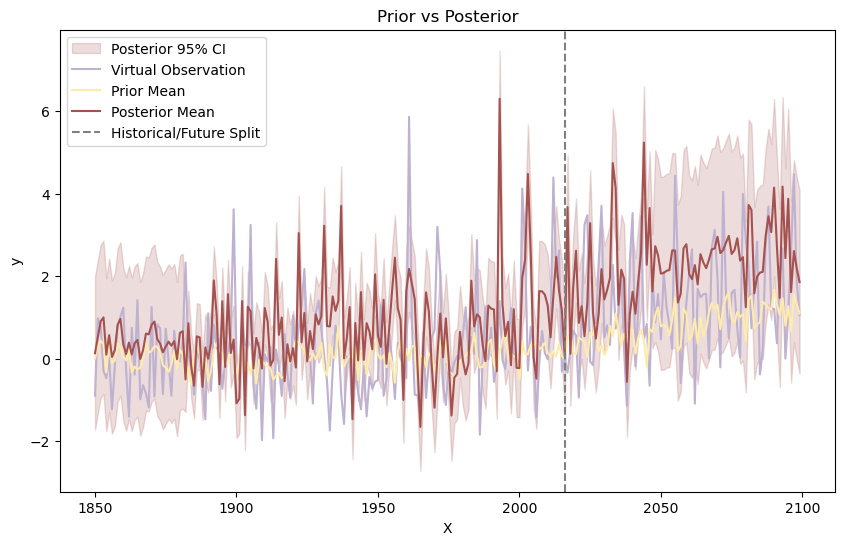

Starting iteration 10 out of 16


Optimization Progress (iteration 10):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.422e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.276e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.798e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.558e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.978e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.39e+07 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 10):   0%|          | 0/100 [00:01<?, ?it/s]

|  44       | -7.649e+0 |  6.892e-0 |  0.8403   |  0.4828   |  9.377    |  0.8097   |  3.894    |  0.6565   |  6.41     |  4.8      |
|  45       | -8.544e+0 |  1.8e-09  |  0.43     |  0.6646   |  3.652    |  9.409    |  5.716    |  0.2459   |  6.844    |  3.049    |
|  46       | -8.573e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -8.432e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.535e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -8.254e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.011e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one

Iteration 10 - Best objective function value: -2658.3937694317733
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 10 - test lml: -48.964452887070166


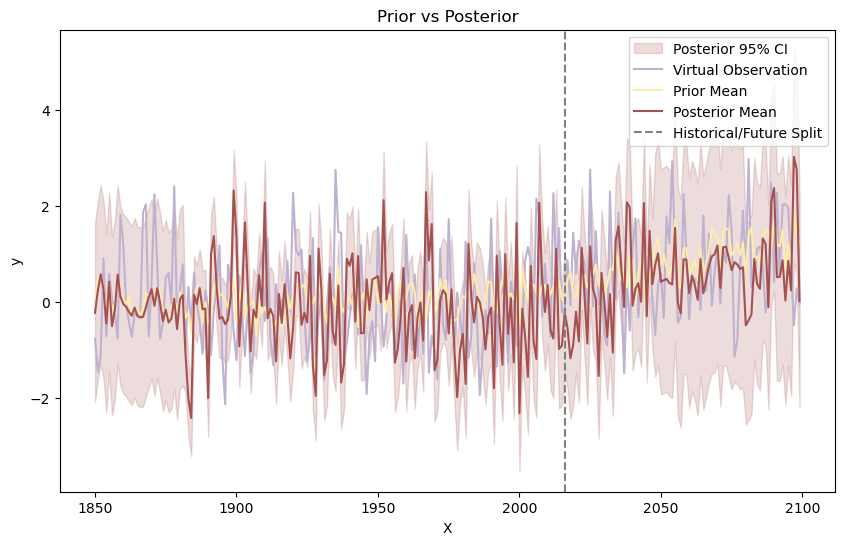

Starting iteration 11 out of 16


Optimization Progress (iteration 11):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.786e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.493e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.214e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.745e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.23e+07 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.704e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 11):   0%|          | 0/100 [00:01<?, ?it/s]

|  44       | -7.996e+0 |  6.892e-0 |  0.8403   |  0.4828   |  9.377    |  0.8097   |  3.894    |  0.6565   |  6.41     |  4.8      |
|  45       | -8.693e+0 |  1.8e-09  |  0.43     |  0.6646   |  3.652    |  9.409    |  5.716    |  0.2459   |  6.844    |  3.049    |
|  46       | -8.814e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -8.724e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.676e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -8.688e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.192e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one

Iteration 11 - Best objective function value: -2660.796332146716
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 11 - test lml: -55.40931886740652


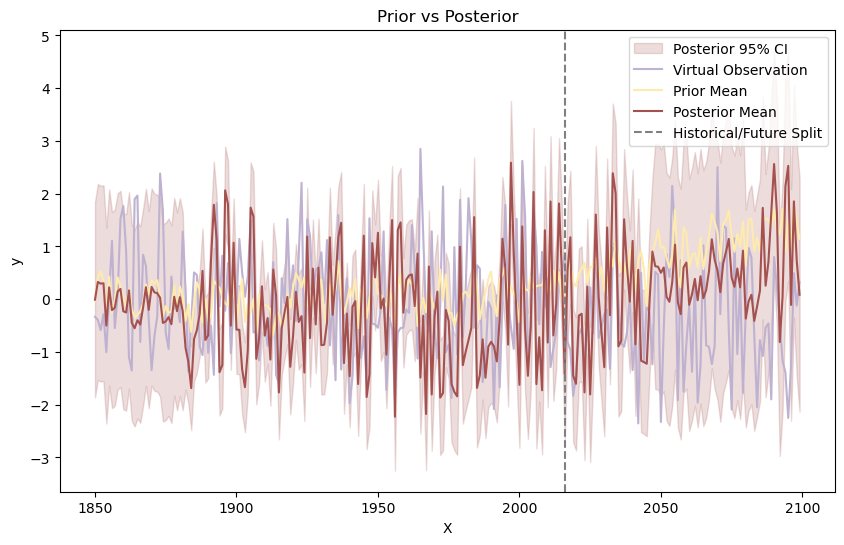

Starting iteration 12 out of 16


Optimization Progress (iteration 12):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.645e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.915e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.158e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.875e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.065e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.66e+07 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 12):   0%|          | 0/100 [00:01<?, ?it/s]

|  47       | -8.712e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.955e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -8.594e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.192e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 12 - Best objective function value: -2661.4571770229454
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 12 - test lml: -33.12027992219199


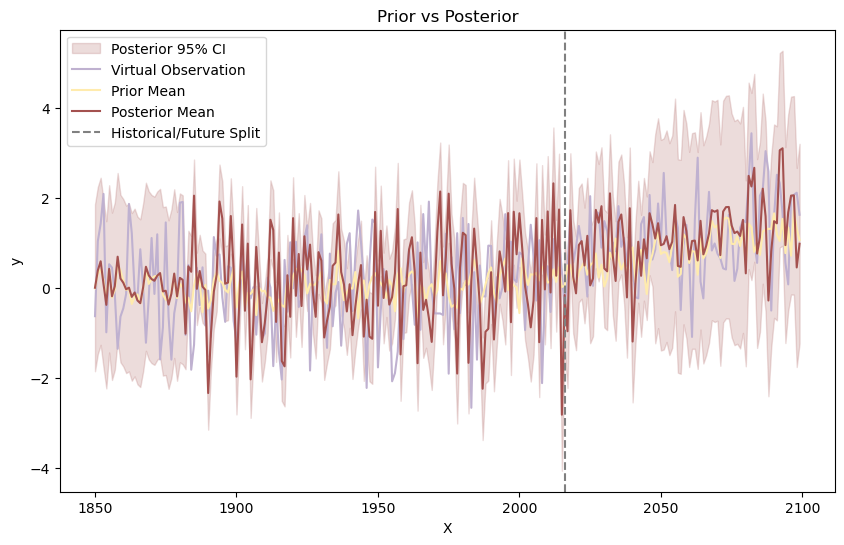

Starting iteration 13 out of 16


Optimization Progress (iteration 13):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.748e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.413e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.079e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.736e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.153e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.668e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 13):   0%|          | 0/100 [00:01<?, ?it/s]

|  44       | -8.09e+07 |  6.892e-0 |  0.8403   |  0.4828   |  9.377    |  0.8097   |  3.894    |  0.6565   |  6.41     |  4.8      |
|  45       | -8.933e+0 |  1.8e-09  |  0.43     |  0.6646   |  3.652    |  9.409    |  5.716    |  0.2459   |  6.844    |  3.049    |
|  46       | -8.855e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -8.543e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.678e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -8.415e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.208e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one

Iteration 13 - Best objective function value: -2661.5841474762597
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 13 - test lml: -58.565429564423304


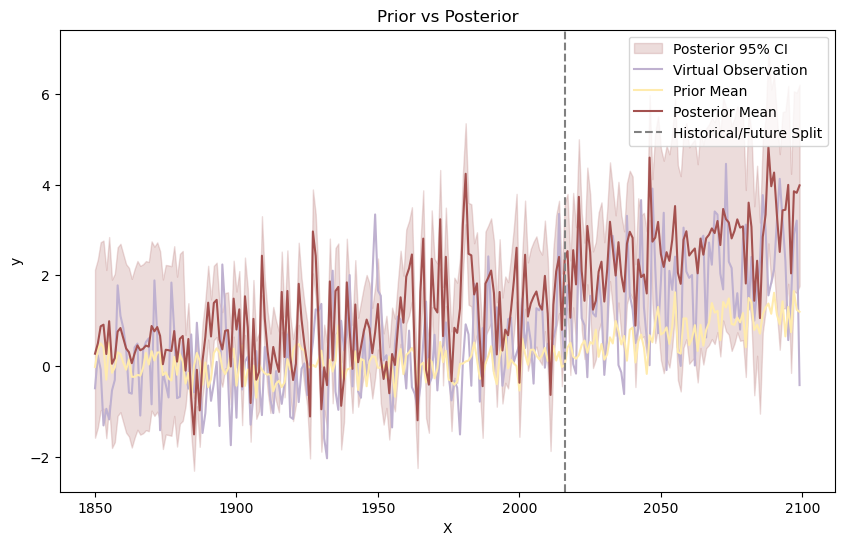

Starting iteration 14 out of 16


Optimization Progress (iteration 14):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.557e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.597e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.091e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.924e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.291e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.524e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 14):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -8.74e+07 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.325e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 14 - Best objective function value: -2663.516744535096
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 14 - test lml: -51.55409163734521


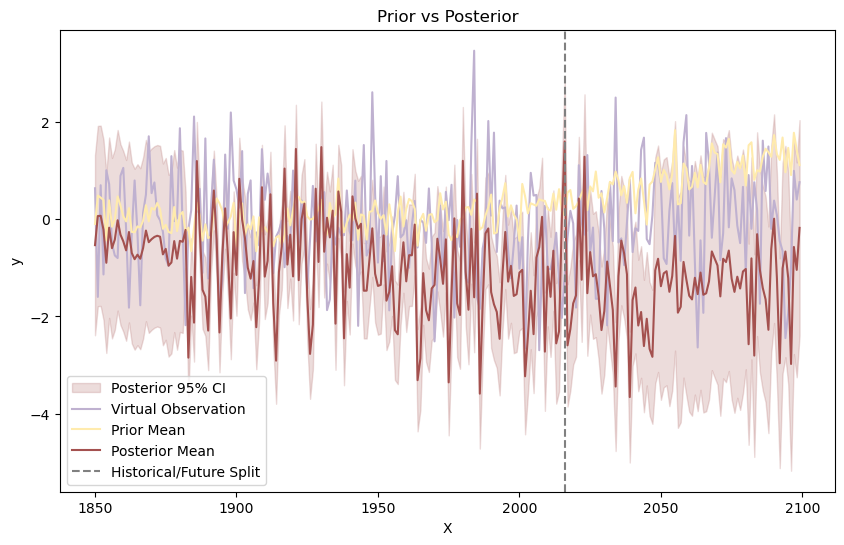

Starting iteration 15 out of 16


Optimization Progress (iteration 15):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.515e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.292e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.91e+07 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.609e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.013e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.614e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 15):   0%|          | 0/100 [00:01<?, ?it/s]

|  45       | -8.688e+0 |  1.8e-09  |  0.43     |  0.6646   |  3.652    |  9.409    |  5.716    |  0.2459   |  6.844    |  3.049    |
|  46       | -8.746e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -8.448e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.561e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -8.263e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.152e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.


Iteration 15 - Best objective function value: -2661.956530826449
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 15 - test lml: -65.04739896691135


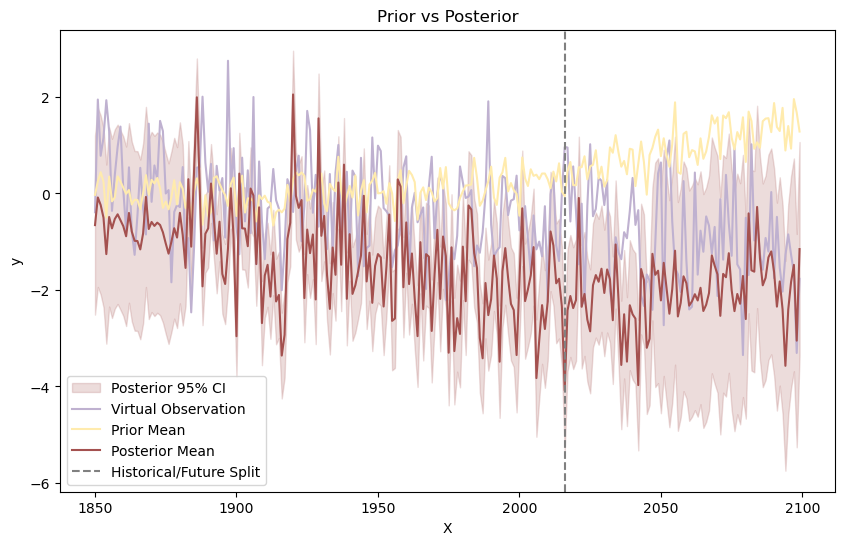

Starting iteration 16 out of 16


Optimization Progress (iteration 16):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -9.176e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -9.083e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -8.241e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -9.245e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -9.636e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -9.282e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 16):   0%|          | 0/100 [00:01<?, ?it/s]

|  47       | -9.027e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -7.163e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -9.08e+07 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -9.703e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 16 - Best objective function value: -2668.52726173051
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 16 - test lml: -42.45581524281953


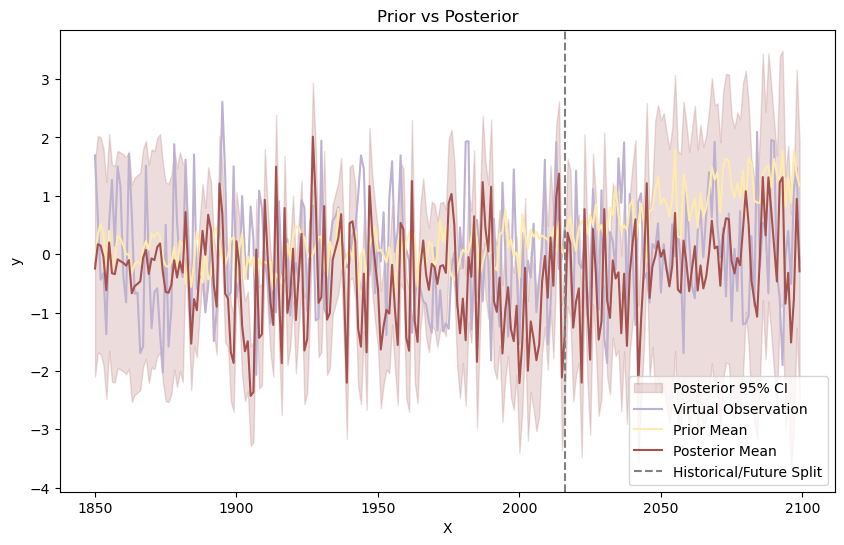

Total log marginal likelihood sum for the kernel structure: -1261.279049544753


-1261.279049544753

In [24]:
def pe2_poly(best_params):
    kernel = (
        0.01* C(best_params['c1']) * (DotProduct(sigma_0=best_params['dp_sigma_0']) ** 2) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c1': (0.000000001, 0.00000001),
    'c2': (0.1, 1),
    'c3': (0.1, 1),
    'ls1': (1e-2, 1e1),
    'per1': (3, 7),
    'ls2': (1e-2, 1e1),
    'per2': (3, 7),
    'noise': (1e-6, 1),
    'dp_sigma_0': (1e-3, 10),
}
kernel_selection(mod_ids, Nobs, rainfall_yearly, pbounds, pe2_poly)

-1261.279049544753

## rbf*pe

Starting iteration 1 out of 16


Optimization Progress (iteration 1):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.579e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  31.45    |  25.15    |  6.356    |  5.802    |
|  2        | -3.888e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  31.88    |  75.96    |  6.427    |  3.856    |
|  3        | -4.298e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  33.2     |  68.99    |  6.236    |  5.996    |
|  4        | -4.241e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  33.13    |  60.69    |  6.355    |  4.173    |
|  5        | -4.971e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 1):   0%|          | 0/100 [00:04<?, ?it/s]

|  50       | -4.438e+0 |  1.917    |  1.813    |  0.7142   |  16.73    |  9.17     |  0.2025   |  5.548    |  27.04    |  61.02    |  6.432    |  6.743    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 1 - Best objective function value: -1682.618705492566
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=33.2) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)


Iteration 1 - test lml: -183.36507340781895


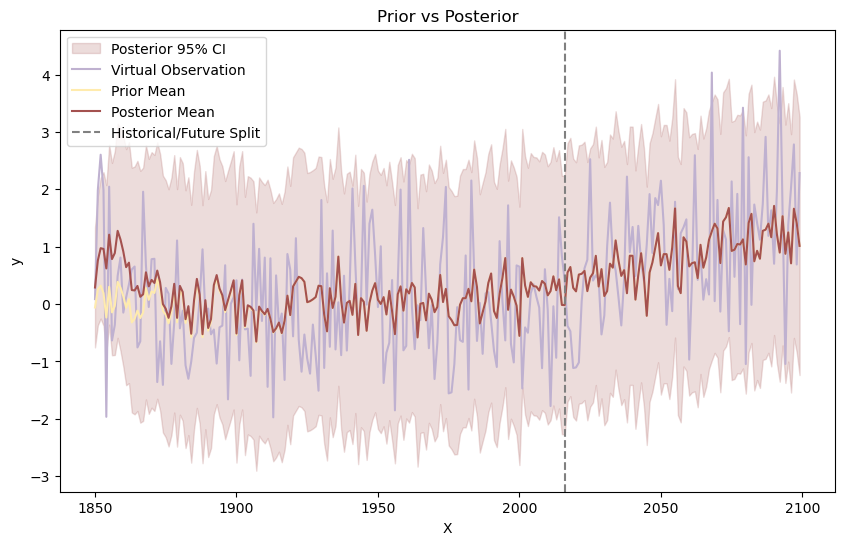

Starting iteration 2 out of 16


Optimization Progress (iteration 2):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.367e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  31.45    |  25.15    |  6.356    |  5.802    |
|  2        | -3.654e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  31.88    |  75.96    |  6.427    |  3.856    |
|  3        | -4.517e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  33.2     |  68.99    |  6.236    |  5.996    |
|  4        | -4.056e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  33.13    |  60.69    |  6.355    |  4.173    |
|  5        | -5.088e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 2):   0%|          | 0/100 [00:03<?, ?it/s]

|  50       | -4.258e+0 |  1.917    |  1.813    |  0.7142   |  16.73    |  9.17     |  0.2025   |  5.548    |  27.04    |  61.02    |  6.432    |  6.743    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 2 - Best objective function value: -1692.1773048198706
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=33.2) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)


Iteration 2 - test lml: -222.05617187885298


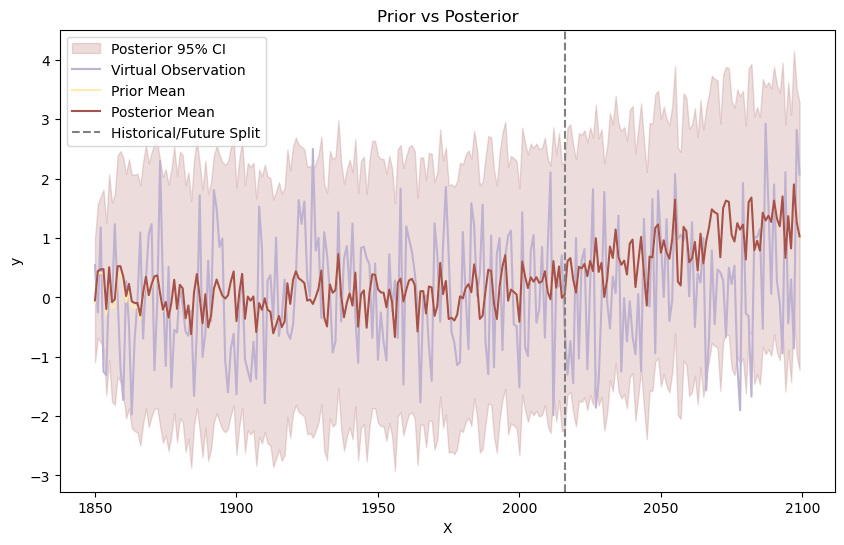

Starting iteration 3 out of 16


Optimization Progress (iteration 3):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.28e+07 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  31.45    |  25.15    |  6.356    |  5.802    |
|  2        | -3.544e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  31.88    |  75.96    |  6.427    |  3.856    |
|  3        | -4.081e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  33.2     |  68.99    |  6.236    |  5.996    |
|  4        | -3.928e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  33.13    |  60.69    |  6.355    |  4.173    |
|  5        | -4.772e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 3):   0%|          | 0/100 [00:03<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 3 - Best objective function value: -1693.438273424193
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=33.2) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)
Iteration 3 - test lml: -180.91094537714025


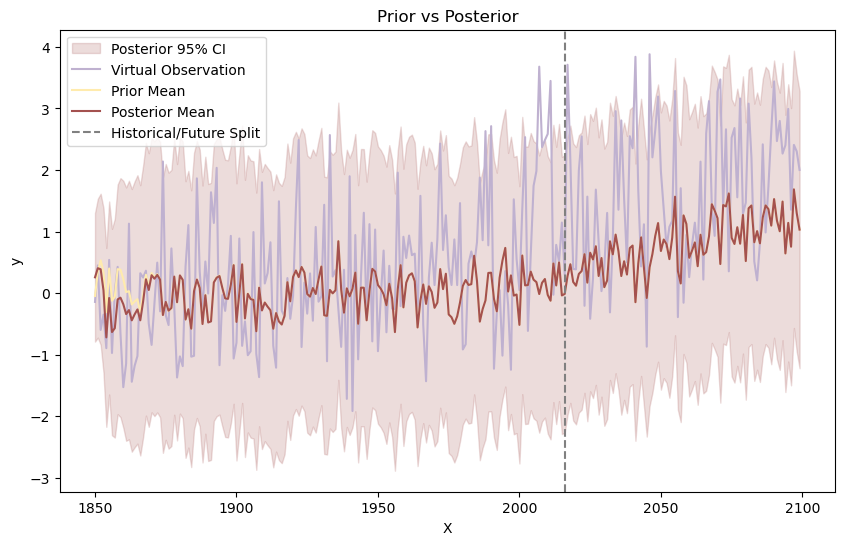

Starting iteration 4 out of 16


Optimization Progress (iteration 4):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.485e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  31.45    |  25.15    |  6.356    |  5.802    |
|  2        | -3.712e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  31.88    |  75.96    |  6.427    |  3.856    |
|  3        | -4.269e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  33.2     |  68.99    |  6.236    |  5.996    |
|  4        | -4.144e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  33.13    |  60.69    |  6.355    |  4.173    |
|  5        | -5.071e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 4):   0%|          | 0/100 [00:03<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 4 - Best objective function value: -1698.023661498015
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=33.2) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)
Iteration 4 - test lml: -125.07558210419056


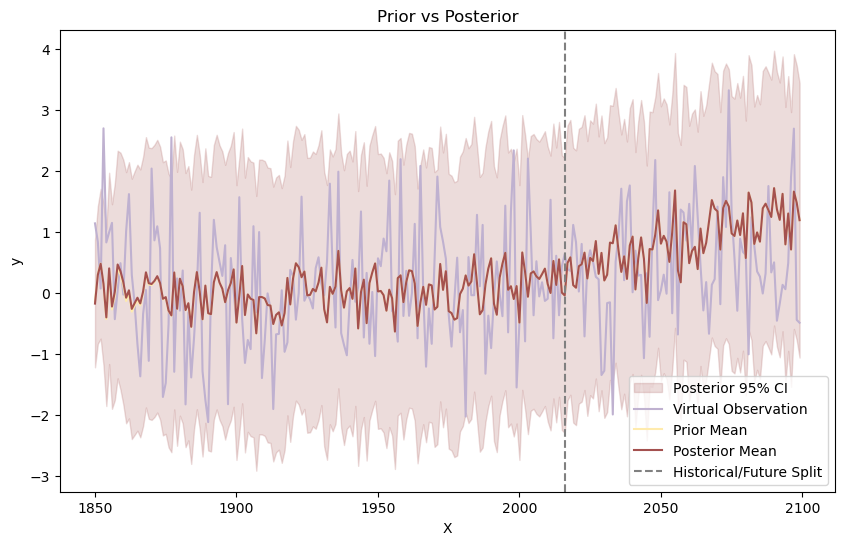

Starting iteration 5 out of 16


Optimization Progress (iteration 5):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.347e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  31.45    |  25.15    |  6.356    |  5.802    |
|  2        | -3.634e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  31.88    |  75.96    |  6.427    |  3.856    |
|  3        | -4.245e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  33.2     |  68.99    |  6.236    |  5.996    |
|  4        | -3.974e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  33.13    |  60.69    |  6.355    |  4.173    |
|  5        | -4.989e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 5):   0%|          | 0/100 [00:03<?, ?it/s]

|  48       | -2.018e+0 |  0.4859   |  0.9585   |  0.1009   |  85.67    |  3.941    |  0.1542   |  6.286    |  29.34    |  3.061    |  6.576    |  5.269    |
|  49       | -2.868e+0 |  0.6844   |  2.994    |  1.41     |  1.314    |  1.836    |  0.7449   |  5.335    |  28.96    |  1.519    |  2.364    |  5.848    |
|  50       | -4.118e+0 |  1.917    |  1.813    |  0.7142   |  16.73    |  9.17     |  0.2025   |  5.548    |  27.04    |  61.02    |  6.432    |  6.743    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 5 - Best objective function value: -1672.6532392610322
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=33.2) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)


Iteration 5 - test lml: -1274.7243756475857


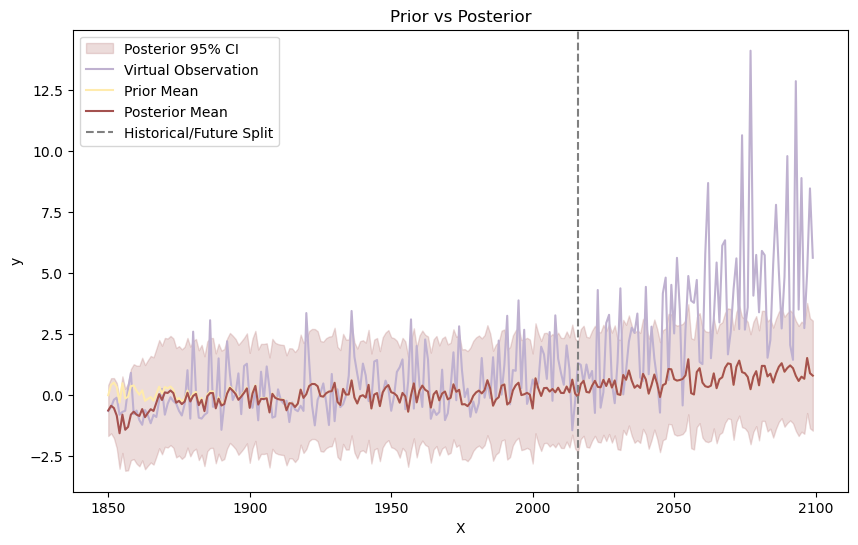

Starting iteration 6 out of 16


Optimization Progress (iteration 6):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.548e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  31.45    |  25.15    |  6.356    |  5.802    |
|  2        | -3.758e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  31.88    |  75.96    |  6.427    |  3.856    |
|  3        | -4.148e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  33.2     |  68.99    |  6.236    |  5.996    |
|  4        | -4.169e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  33.13    |  60.69    |  6.355    |  4.173    |
|  5        | -5.021e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 6):   0%|          | 0/100 [00:02<?, ?it/s]

|  48       | -2.113e+0 |  0.4859   |  0.9585   |  0.1009   |  85.67    |  3.941    |  0.1542   |  6.286    |  29.34    |  3.061    |  6.576    |  5.269    |
|  49       | -2.882e+0 |  0.6844   |  2.994    |  1.41     |  1.314    |  1.836    |  0.7449   |  5.335    |  28.96    |  1.519    |  2.364    |  5.848    |
|  50       | -4.176e+0 |  1.917    |  1.813    |  0.7142   |  16.73    |  9.17     |  0.2025   |  5.548    |  27.04    |  61.02    |  6.432    |  6.743    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 6 - Best objective function value: -1693.5835197443093
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=33.2) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)


Iteration 6 - test lml: -524.7605135599317


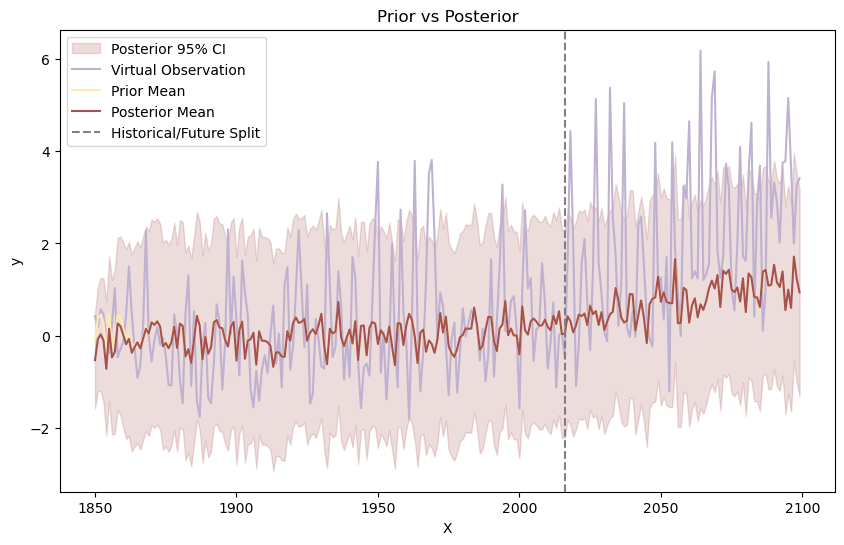

Starting iteration 7 out of 16


Optimization Progress (iteration 7):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.693e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  31.45    |  25.15    |  6.356    |  5.802    |
|  2        | -3.959e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  31.88    |  75.96    |  6.427    |  3.856    |
|  3        | -4.35e+07 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  33.2     |  68.99    |  6.236    |  5.996    |
|  4        | -4.257e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  33.13    |  60.69    |  6.355    |  4.173    |
|  5        | -5.342e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 7):   0%|          | 0/100 [00:02<?, ?it/s]

|  49       | -2.881e+0 |  0.6844   |  2.994    |  1.41     |  1.314    |  1.836    |  0.7449   |  5.335    |  28.96    |  1.519    |  2.364    |  5.848    |
|  50       | -4.298e+0 |  1.917    |  1.813    |  0.7142   |  16.73    |  9.17     |  0.2025   |  5.548    |  27.04    |  61.02    |  6.432    |  6.743    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 7 - Best objective function value: -1695.0467768753374
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=33.2) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)


Iteration 7 - test lml: -115.7696816417235


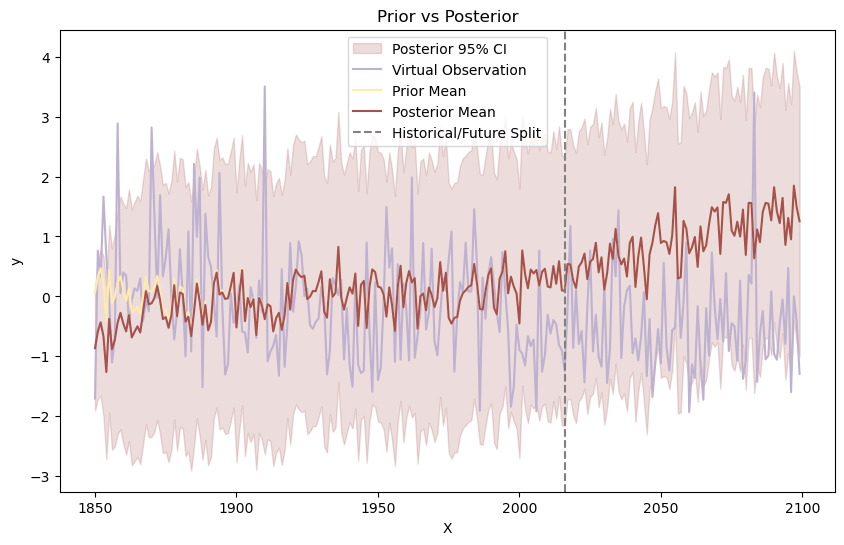

Starting iteration 8 out of 16


Optimization Progress (iteration 8):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -4.024e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  31.45    |  25.15    |  6.356    |  5.802    |
|  2        | -4.297e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  31.88    |  75.96    |  6.427    |  3.856    |
|  3        | -4.826e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  33.2     |  68.99    |  6.236    |  5.996    |
|  4        | -4.711e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  33.13    |  60.69    |  6.355    |  4.173    |
|  5        | -5.305e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 8):   0%|          | 0/100 [00:03<?, ?it/s]

|  47       | -1.735e+0 |  0.2012   |  0.9296   |  0.1888   |  80.88    |  3.846    |  0.2331   |  4.03     |  33.2     |  25.17    |  8.635    |  0.3206   |
|  48       | -2.547e+0 |  0.4859   |  0.9585   |  0.1009   |  85.67    |  3.941    |  0.1542   |  6.286    |  29.34    |  3.061    |  6.576    |  5.269    |
|  49       | -2.913e+0 |  0.6844   |  2.994    |  1.41     |  1.314    |  1.836    |  0.7449   |  5.335    |  28.96    |  1.519    |  2.364    |  5.848    |
|  50       | -4.772e+0 |  1.917    |  1.813    |  0.7142   |  16.73    |  9.17     |  0.2025   |  5.548    |  27.04    |  61.02    |  6.432    |  6.743    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 8 - Best objective function value: -1734.6087968069944
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=33.2) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321

Iteration 8 - test lml: -300.57738724476496


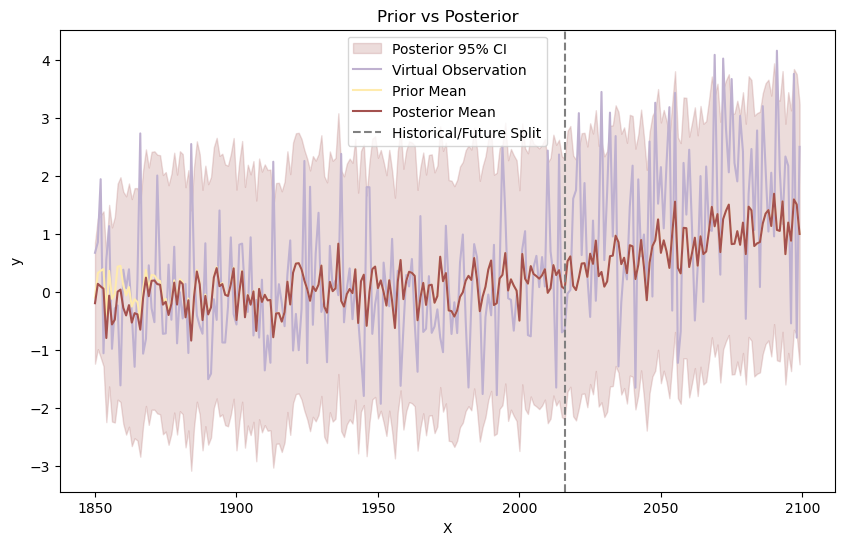

Starting iteration 9 out of 16


Optimization Progress (iteration 9):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.32e+07 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  31.45    |  25.15    |  6.356    |  5.802    |
|  2        | -3.598e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  31.88    |  75.96    |  6.427    |  3.856    |
|  3        | -4.08e+07 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  33.2     |  68.99    |  6.236    |  5.996    |
|  4        | -3.953e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  33.13    |  60.69    |  6.355    |  4.173    |
|  5        | -4.809e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 9):   0%|          | 0/100 [00:02<?, ?it/s]

|  47       | -1.672e+0 |  0.2012   |  0.9296   |  0.1888   |  80.88    |  3.846    |  0.2331   |  4.03     |  33.2     |  25.17    |  8.635    |  0.3206   |
|  48       | -2.084e+0 |  0.4859   |  0.9585   |  0.1009   |  85.67    |  3.941    |  0.1542   |  6.286    |  29.34    |  3.061    |  6.576    |  5.269    |
|  49       | -2.87e+03 |  0.6844   |  2.994    |  1.41     |  1.314    |  1.836    |  0.7449   |  5.335    |  28.96    |  1.519    |  2.364    |  5.848    |
|  50       | -3.953e+0 |  1.917    |  1.813    |  0.7142   |  16.73    |  9.17     |  0.2025   |  5.548    |  27.04    |  61.02    |  6.432    |  6.743    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 9 - Best objective function value: -1671.8045536668528
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=33.2) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321

Iteration 9 - test lml: -317.0470622080189


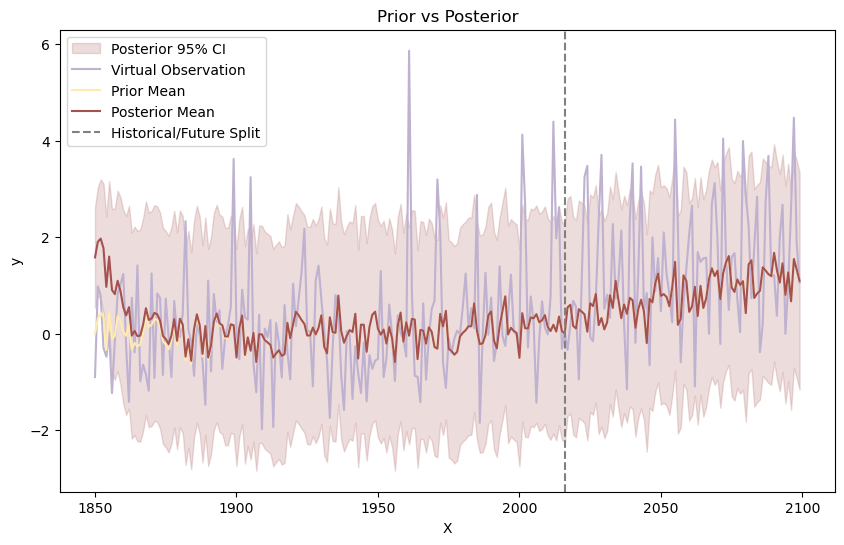

Starting iteration 10 out of 16


Optimization Progress (iteration 10):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.356e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  31.45    |  25.15    |  6.356    |  5.802    |
|  2        | -3.663e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  31.88    |  75.96    |  6.427    |  3.856    |
|  3        | -4.062e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  33.2     |  68.99    |  6.236    |  5.996    |
|  4        | -3.981e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  33.13    |  60.69    |  6.355    |  4.173    |
|  5        | -4.849e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 10):   0%|          | 0/100 [00:03<?, ?it/s]

|  47       | -1.672e+0 |  0.2012   |  0.9296   |  0.1888   |  80.88    |  3.846    |  0.2331   |  4.03     |  33.2     |  25.17    |  8.635    |  0.3206   |
|  48       | -2.009e+0 |  0.4859   |  0.9585   |  0.1009   |  85.67    |  3.941    |  0.1542   |  6.286    |  29.34    |  3.061    |  6.576    |  5.269    |
|  49       | -2.865e+0 |  0.6844   |  2.994    |  1.41     |  1.314    |  1.836    |  0.7449   |  5.335    |  28.96    |  1.519    |  2.364    |  5.848    |
|  50       | -4.01e+07 |  1.917    |  1.813    |  0.7142   |  16.73    |  9.17     |  0.2025   |  5.548    |  27.04    |  61.02    |  6.432    |  6.743    |
An error occurred during optimization: 'x0' must only have one dimension.


Iteration 10 - Best objective function value: -1671.7268057208191
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=33.2) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)
Iteration 10 - test lml: -162.4731666022907


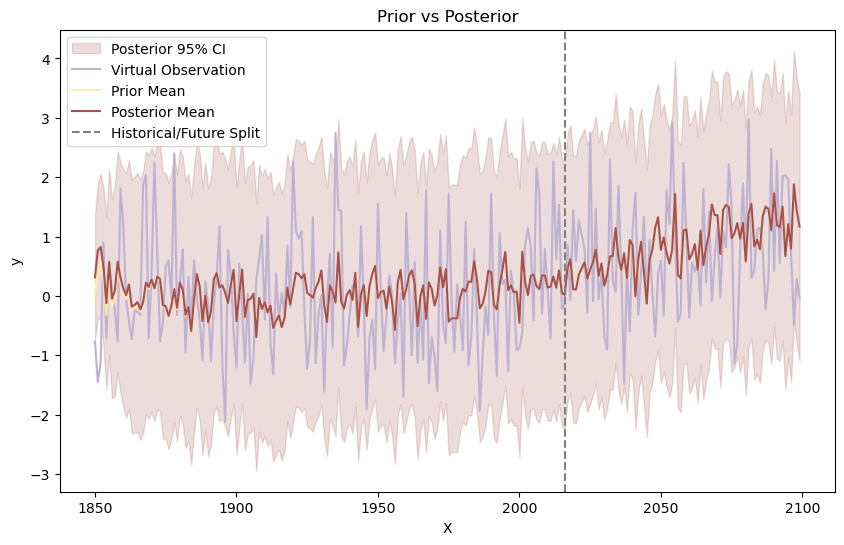

Starting iteration 11 out of 16


Optimization Progress (iteration 11):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.349e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  31.45    |  25.15    |  6.356    |  5.802    |
|  2        | -3.704e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  31.88    |  75.96    |  6.427    |  3.856    |
|  3        | -4.141e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  33.2     |  68.99    |  6.236    |  5.996    |
|  4        | -4.136e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  33.13    |  60.69    |  6.355    |  4.173    |
|  5        | -4.876e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 11):   0%|          | 0/100 [00:03<?, ?it/s]

|  48       | -2.06e+07 |  0.4859   |  0.9585   |  0.1009   |  85.67    |  3.941    |  0.1542   |  6.286    |  29.34    |  3.061    |  6.576    |  5.269    |
|  49       | -2.876e+0 |  0.6844   |  2.994    |  1.41     |  1.314    |  1.836    |  0.7449   |  5.335    |  28.96    |  1.519    |  2.364    |  5.848    |
|  50       | -4.31e+07 |  1.917    |  1.813    |  0.7142   |  16.73    |  9.17     |  0.2025   |  5.548    |  27.04    |  61.02    |  6.432    |  6.743    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 11 - Best objective function value: -1685.1127754806894
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=33.2) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)


Iteration 11 - test lml: -185.9616040143748


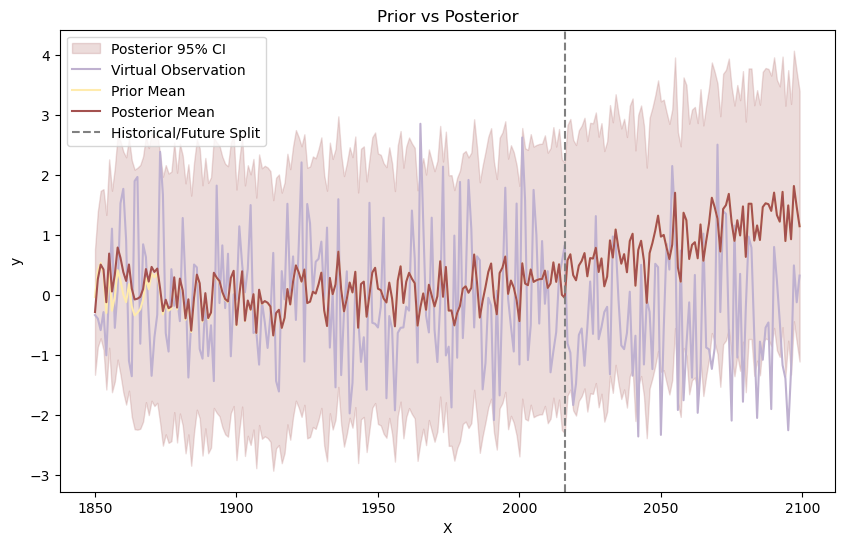

Starting iteration 12 out of 16


Optimization Progress (iteration 12):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.313e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  31.45    |  25.15    |  6.356    |  5.802    |
|  2        | -3.706e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  31.88    |  75.96    |  6.427    |  3.856    |
|  3        | -4.041e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  33.2     |  68.99    |  6.236    |  5.996    |
|  4        | -4.08e+07 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  33.13    |  60.69    |  6.355    |  4.173    |
|  5        | -4.83e+07 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 12):   0%|          | 0/100 [00:02<?, ?it/s]

|  47       | -1.689e+0 |  0.2012   |  0.9296   |  0.1888   |  80.88    |  3.846    |  0.2331   |  4.03     |  33.2     |  25.17    |  8.635    |  0.3206   |
|  48       | -2.039e+0 |  0.4859   |  0.9585   |  0.1009   |  85.67    |  3.941    |  0.1542   |  6.286    |  29.34    |  3.061    |  6.576    |  5.269    |
|  49       | -2.871e+0 |  0.6844   |  2.994    |  1.41     |  1.314    |  1.836    |  0.7449   |  5.335    |  28.96    |  1.519    |  2.364    |  5.848    |
|  50       | -4.238e+0 |  1.917    |  1.813    |  0.7142   |  16.73    |  9.17     |  0.2025   |  5.548    |  27.04    |  61.02    |  6.432    |  6.743    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 12 - Best objective function value: -1688.8443682673264
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=33.2) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.32

Iteration 12 - test lml: -89.56072870489238


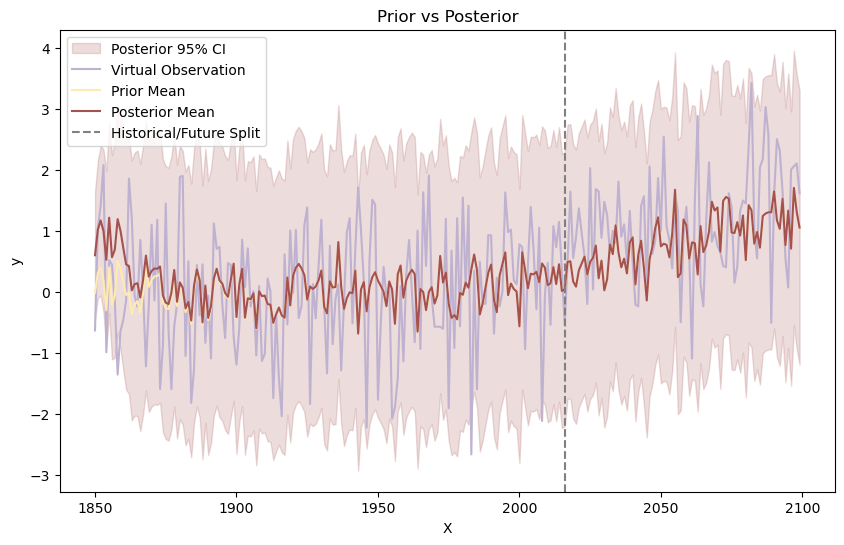

Starting iteration 13 out of 16


Optimization Progress (iteration 13):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.925e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  31.45    |  25.15    |  6.356    |  5.802    |
|  2        | -4.007e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  31.88    |  75.96    |  6.427    |  3.856    |
|  3        | -4.331e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  33.2     |  68.99    |  6.236    |  5.996    |
|  4        | -4.465e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  33.13    |  60.69    |  6.355    |  4.173    |
|  5        | -5.524e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 13):   0%|          | 0/100 [00:02<?, ?it/s]

|  48       | -2.279e+0 |  0.4859   |  0.9585   |  0.1009   |  85.67    |  3.941    |  0.1542   |  6.286    |  29.34    |  3.061    |  6.576    |  5.269    |
|  49       | -2.889e+0 |  0.6844   |  2.994    |  1.41     |  1.314    |  1.836    |  0.7449   |  5.335    |  28.96    |  1.519    |  2.364    |  5.848    |
|  50       | -4.274e+0 |  1.917    |  1.813    |  0.7142   |  16.73    |  9.17     |  0.2025   |  5.548    |  27.04    |  61.02    |  6.432    |  6.743    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 13 - Best objective function value: -1692.2843134902907
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=33.2) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)


Iteration 13 - test lml: -213.0941248265837


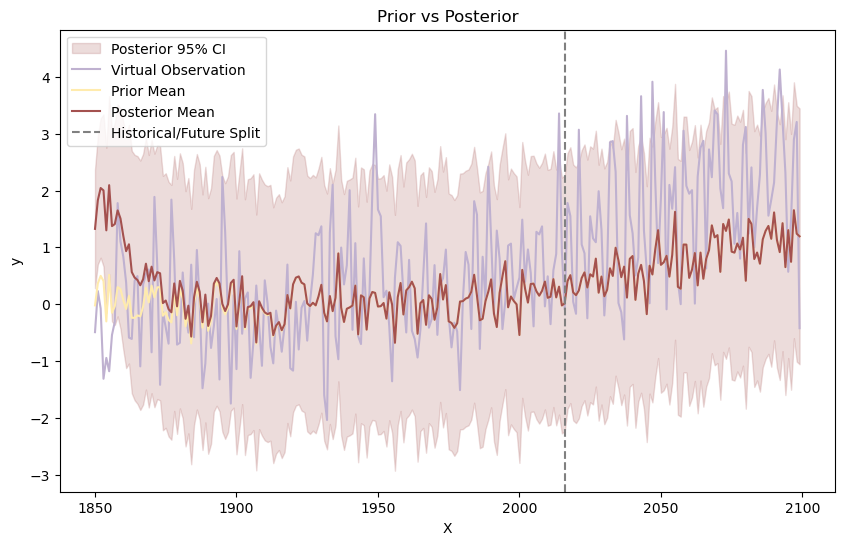

Starting iteration 14 out of 16


Optimization Progress (iteration 14):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.257e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  31.45    |  25.15    |  6.356    |  5.802    |
|  2        | -3.58e+07 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  31.88    |  75.96    |  6.427    |  3.856    |
|  3        | -4.069e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  33.2     |  68.99    |  6.236    |  5.996    |
|  4        | -4.012e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  33.13    |  60.69    |  6.355    |  4.173    |
|  5        | -4.81e+07 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 14):   0%|          | 0/100 [00:02<?, ?it/s]

|  48       | -2.055e+0 |  0.4859   |  0.9585   |  0.1009   |  85.67    |  3.941    |  0.1542   |  6.286    |  29.34    |  3.061    |  6.576    |  5.269    |
|  49       | -2.873e+0 |  0.6844   |  2.994    |  1.41     |  1.314    |  1.836    |  0.7449   |  5.335    |  28.96    |  1.519    |  2.364    |  5.848    |
|  50       | -3.992e+0 |  1.917    |  1.813    |  0.7142   |  16.73    |  9.17     |  0.2025   |  5.548    |  27.04    |  61.02    |  6.432    |  6.743    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 14 - Best objective function value: -1684.6818696595194
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=33.2) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)


Iteration 14 - test lml: -172.02885971660515


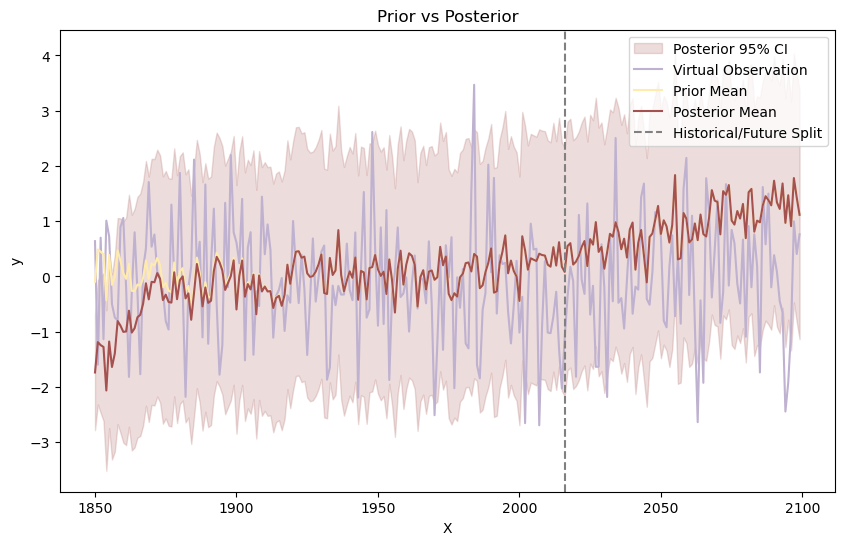

Starting iteration 15 out of 16


Optimization Progress (iteration 15):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.544e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  31.45    |  25.15    |  6.356    |  5.802    |
|  2        | -3.778e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  31.88    |  75.96    |  6.427    |  3.856    |
|  3        | -4.357e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  33.2     |  68.99    |  6.236    |  5.996    |
|  4        | -4.186e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  33.13    |  60.69    |  6.355    |  4.173    |
|  5        | -5.092e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 15):   0%|          | 0/100 [00:02<?, ?it/s]


Iteration 15 - Best objective function value: -1691.7223832654688
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=33.2) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)
Iteration 15 - test lml: -204.31532576852686


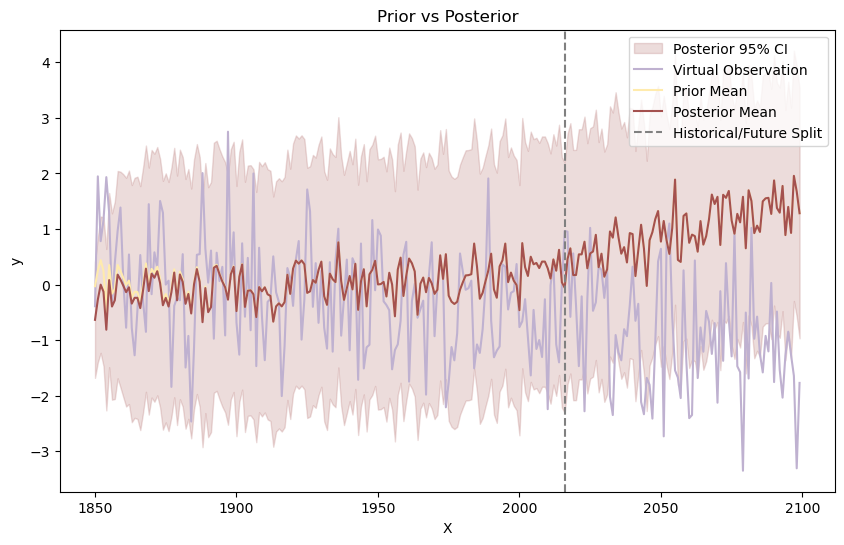

Starting iteration 16 out of 16


Optimization Progress (iteration 16):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.253e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  31.45    |  25.15    |  6.356    |  5.802    |
|  2        | -3.545e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  31.88    |  75.96    |  6.427    |  3.856    |
|  3        | -4.572e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  33.2     |  68.99    |  6.236    |  5.996    |
|  4        | -3.93e+07 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  33.13    |  60.69    |  6.355    |  4.173    |
|  5        | -5.13e+07 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 16):   0%|          | 0/100 [00:04<?, ?it/s]

|  49       | -2.872e+0 |  0.6844   |  2.994    |  1.41     |  1.314    |  1.836    |  0.7449   |  5.335    |  28.96    |  1.519    |  2.364    |  5.848    |
|  50       | -3.987e+0 |  1.917    |  1.813    |  0.7142   |  16.73    |  9.17     |  0.2025   |  5.548    |  27.04    |  61.02    |  6.432    |  6.743    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 16 - Best objective function value: -1708.643363469556
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=33.2) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)


Iteration 16 - test lml: -129.94070134309385


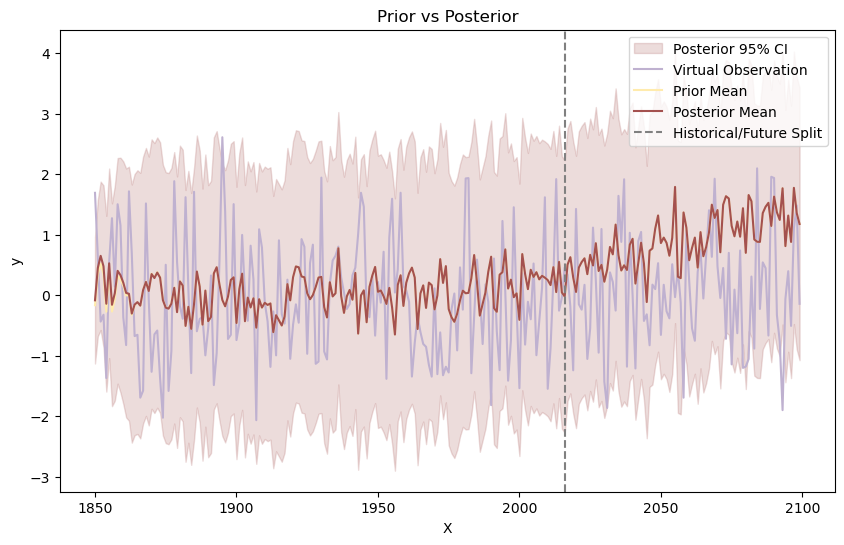

Total log marginal likelihood sum for the kernel structure: -4401.661304046394


-4401.661304046394

In [25]:
from sklearn.gaussian_process.kernels import RBF, ExpSineSquared, WhiteKernel, ConstantKernel as C

def rbfpe2_rbf(best_params):
    kernel = (
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) * RBF(length_scale=best_params['rbf_ls1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) * RBF(length_scale=best_params['rbf_ls2']) +
        C(best_params['c_rbf']) * RBF(length_scale=best_params['rbf_ls3']) +  # 新增的RBF核函数
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c2': (1e-1, 3),
    'c3': (1e-1, 3),
    'c_rbf': (1e-1, 3),    
    'ls1': (1e-2, 100),
    'per1': (3, 7),
    'ls2': (1e-2, 10),
    'per2': (25, 35),
    'rbf_ls1': (1e-2, 100),    
    'rbf_ls2': (1e-2, 10),  
    'rbf_ls3': (1e-2, 10),   
    'noise': (1e-6, 1),
}
kernel_selection(mod_ids, Nobs, rainfall_yearly, pbounds, rbfpe2_rbf)


3982.516321287962

## Poly(PE)

In [20]:
class CustomPolynomialKernel(Kernel):
    def __init__(self, degree=2, periods=[1, 1, 1], include_bias=False):
        self.degree = degree
        self.periods = periods if isinstance(periods, (list, np.ndarray)) else [periods]
        self.include_bias = include_bias
        self.poly = PolynomialFeatures(degree=self.degree, include_bias=self.include_bias)
    
    def periodic_transform(self, X):
        return np.hstack([np.cos(2 * np.pi * X / p) for p in self.periods] +
                         [np.sin(2 * np.pi * X / p) for p in self.periods])
    
    def __call__(self, X, Y=None, eval_gradient=False):
        X_transformed = self.periodic_transform(X)
        if Y is None:
            Y_transformed = X_transformed
        else:
            Y_transformed = self.periodic_transform(Y)
        
        K = self.poly.fit_transform(X_transformed).dot(self.poly.fit_transform(Y_transformed).T)
        
        if eval_gradient:
            K_gradient = np.zeros((X_transformed.shape[0], Y_transformed.shape[0], 0))
            return K, K_gradient
        else:
            return K
    
    def diag(self, X):
        return np.diag(self.__call__(X))
    
    def is_stationary(self):
        return False

### eye-bowling best

Starting iteration 1 out of 16


Optimization Progress (iteration 1):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.379e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.893e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -7.525e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -8.761e+0 |  0.6

Optimization Progress (iteration 1):   0%|          | 0/100 [00:13<?, ?it/s]

|  50       | -5.263e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 1 - Best objective function value: -2249.773668223272
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 1 - test lml: -1040.934617614857


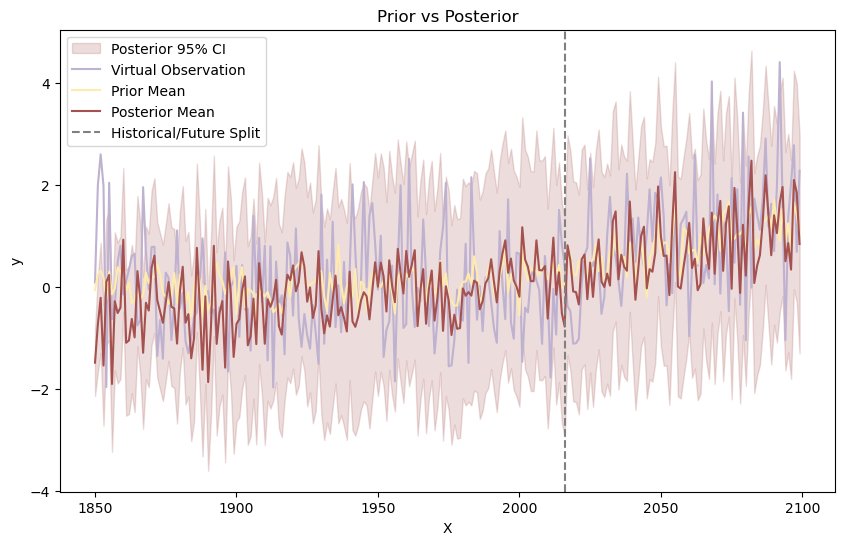

Starting iteration 2 out of 16


Optimization Progress (iteration 2):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.357e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.833e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -7.29e+06 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -8.325e+0 |  0.6

Optimization Progress (iteration 2):   0%|          | 0/100 [00:12<?, ?it/s]

|  50       | -5.331e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 2 - Best objective function value: -2235.9395029197294
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 2 - test lml: -1245.5402499749912


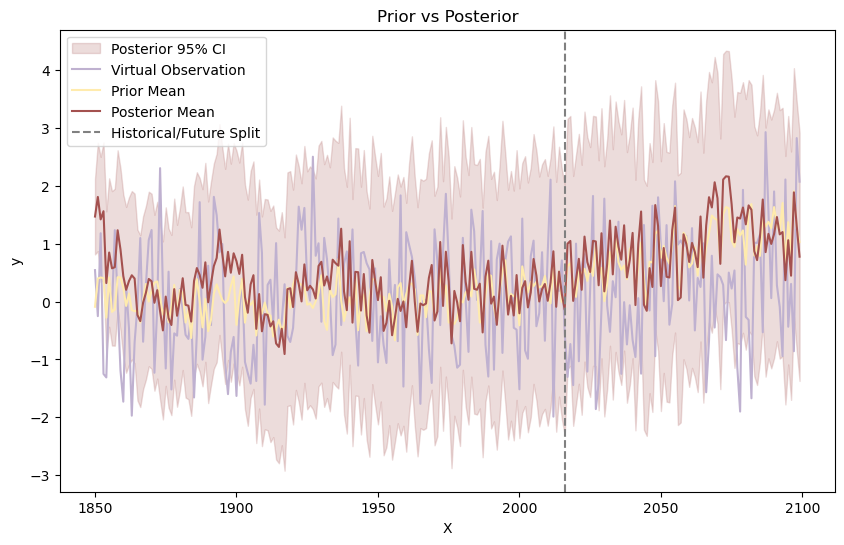

Starting iteration 3 out of 16


Optimization Progress (iteration 3):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.362e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.589e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -7.195e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -8.687e+0 |  0.6

Optimization Progress (iteration 3):   0%|          | 0/100 [00:12<?, ?it/s]

|  50       | -5.079e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 3 - Best objective function value: -2202.7494737981874
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 3 - test lml: -869.5707901725596


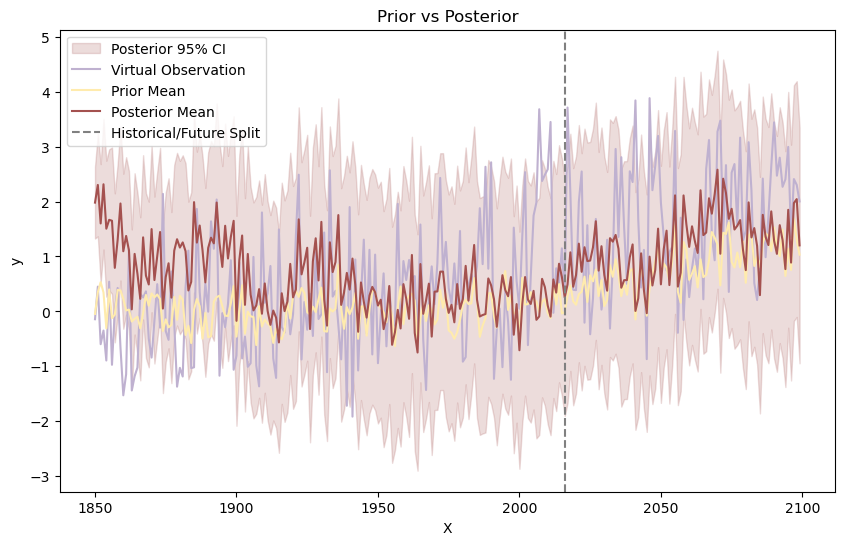

Starting iteration 4 out of 16


Optimization Progress (iteration 4):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.454e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.724e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -7.221e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -8.861e+0 |  0.6

Optimization Progress (iteration 4):   0%|          | 0/100 [00:13<?, ?it/s]

|  50       | -5.256e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 4 - Best objective function value: -2338.7218863240196
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 4 - test lml: -559.221777732377


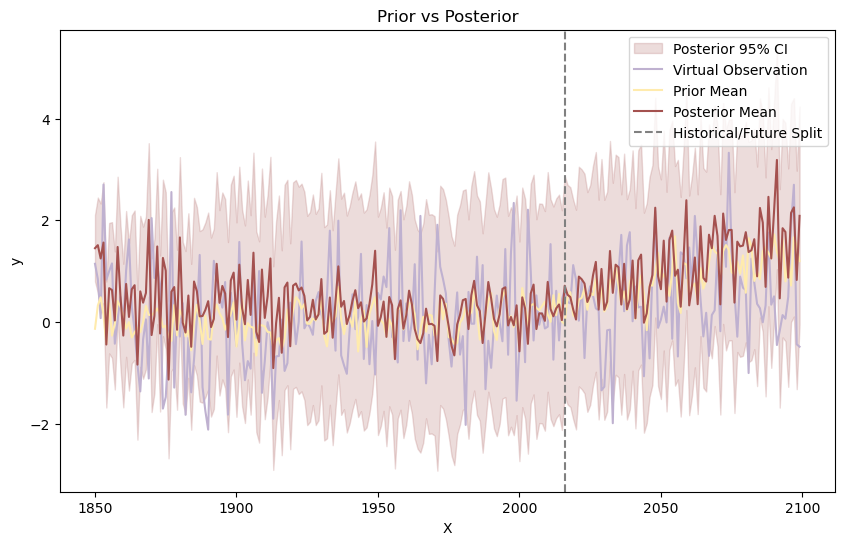

Starting iteration 5 out of 16


Optimization Progress (iteration 5):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.18e+06 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.649e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -7.065e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -8.188e+0 |  0.6

Optimization Progress (iteration 5):   0%|          | 0/100 [00:12<?, ?it/s]

|  50       | -5.204e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 5 - Best objective function value: -2213.475497719568
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 5 - test lml: -4314.866127270179


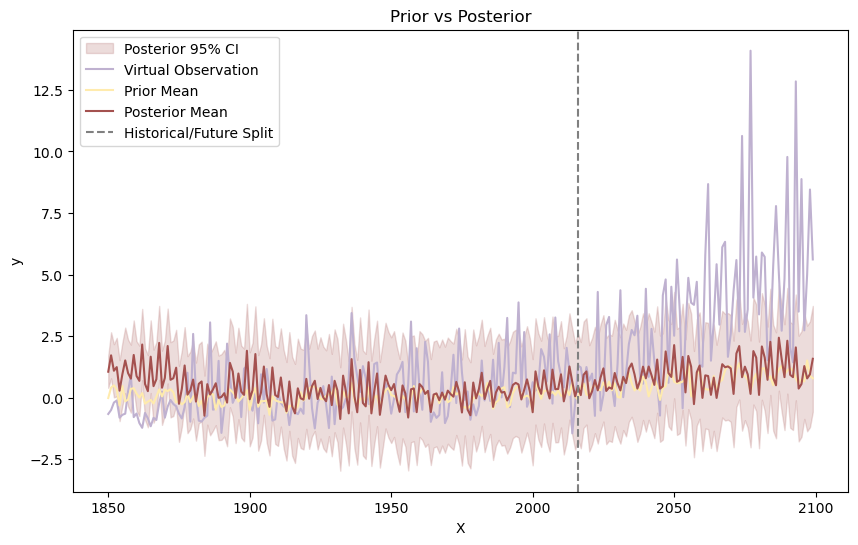

Starting iteration 6 out of 16


Optimization Progress (iteration 6):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.704e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.674e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -7.271e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -9.01e+06 |  0.6

Optimization Progress (iteration 6):   0%|          | 0/100 [00:13<?, ?it/s]

|  50       | -5.412e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 6 - Best objective function value: -2302.211772292958
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 6 - test lml: -1766.664474654752


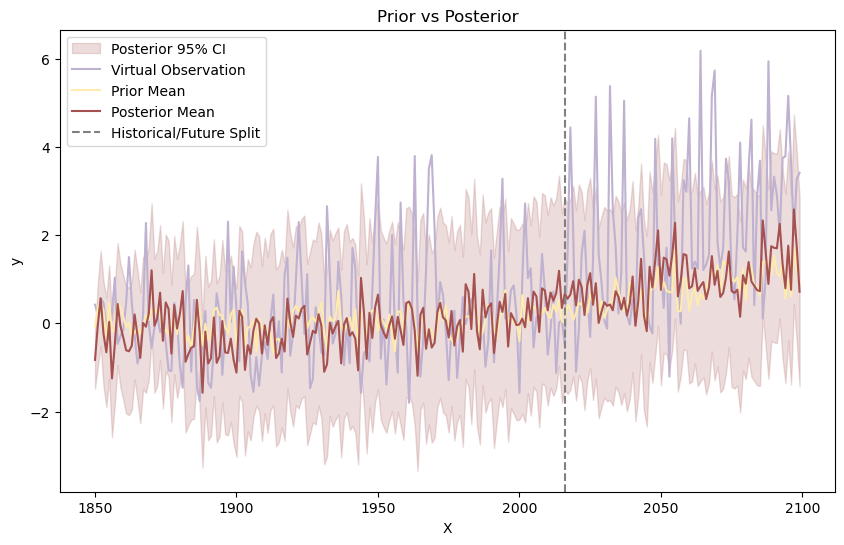

Starting iteration 7 out of 16


Optimization Progress (iteration 7):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.348e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.664e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -7.643e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -8.625e+0 |  0.6

Optimization Progress (iteration 7):   0%|          | 0/100 [00:14<?, ?it/s]

|  50       | -5.725e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 7 - Best objective function value: -2214.4374659943455
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 7 - test lml: -632.7895313139829


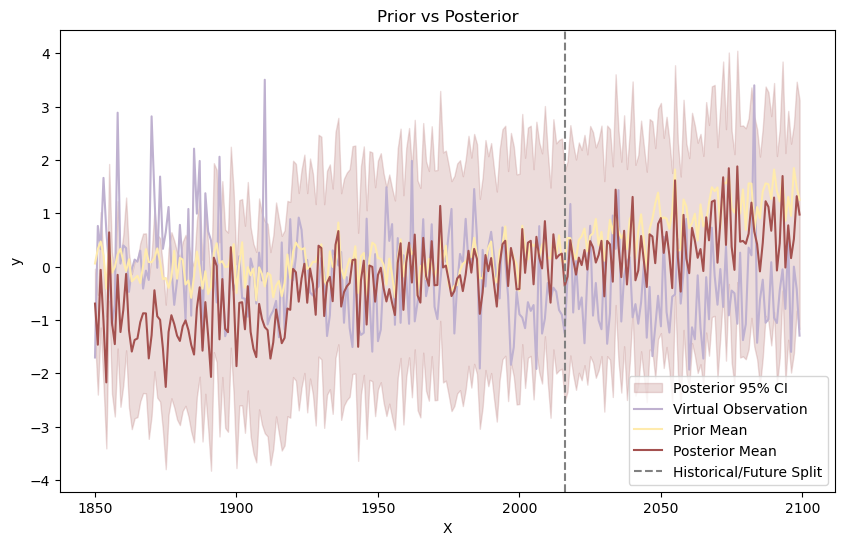

Starting iteration 8 out of 16


Optimization Progress (iteration 8):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.979e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -3.082e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -8.364e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -9.241e+0 |  0.6

Optimization Progress (iteration 8):   0%|          | 0/100 [00:14<?, ?it/s]

|  50       | -5.68e+07 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 8 - Best objective function value: -2416.630535140672
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 8 - test lml: -1017.9034672599156


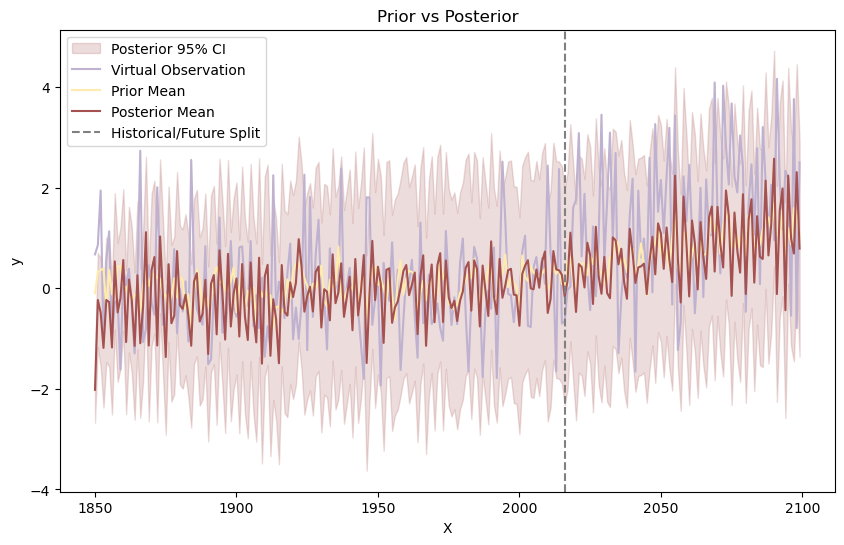

Starting iteration 9 out of 16


Optimization Progress (iteration 9):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.251e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.661e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -6.949e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -8.489e+0 |  0.6

Optimization Progress (iteration 9):   0%|          | 0/100 [00:14<?, ?it/s]

|  50       | -5.056e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 9 - Best objective function value: -2231.4459925707433
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 9 - test lml: -1235.2208693910472


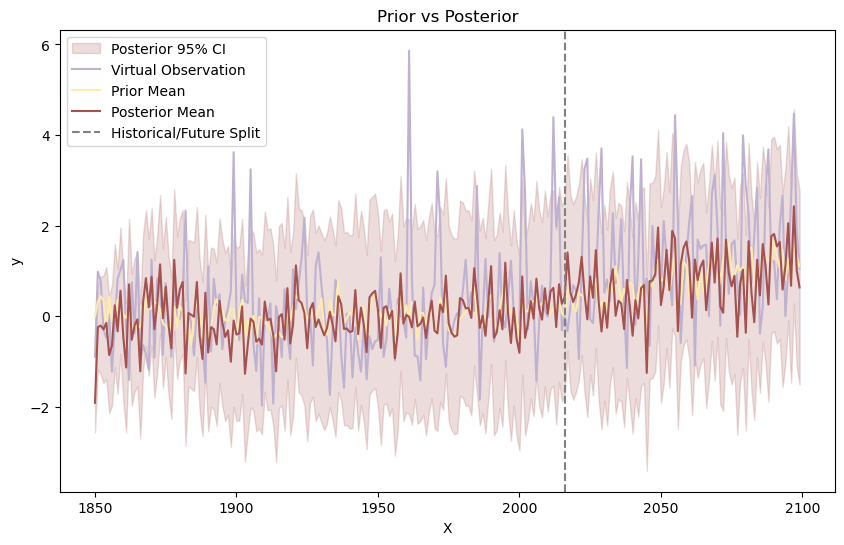

Starting iteration 10 out of 16


Optimization Progress (iteration 10):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.058e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.564e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -7.01e+06 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -8.07e+06 |  0.6

Optimization Progress (iteration 10):   0%|          | 0/100 [00:14<?, ?it/s]

|  50       | -5.016e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 10 - Best objective function value: -2178.2510760776586
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 10 - test lml: -693.207144253057


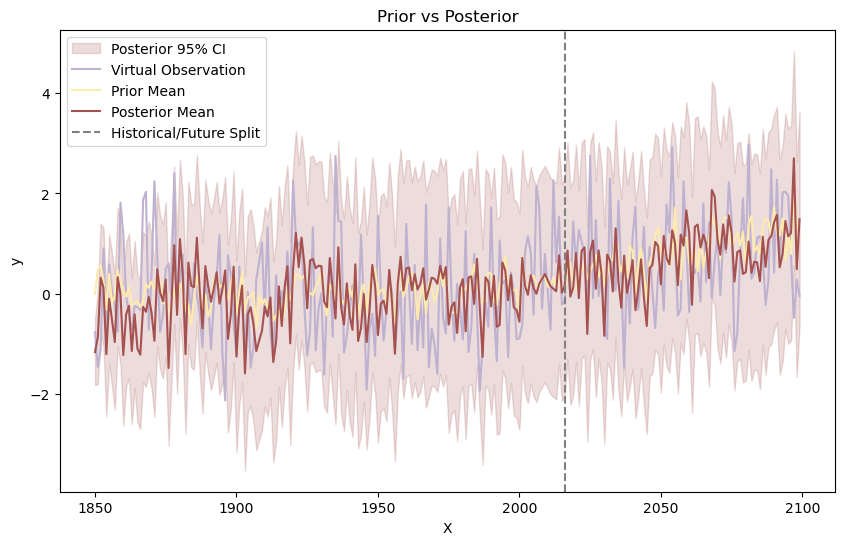

Starting iteration 11 out of 16


Optimization Progress (iteration 11):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.144e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.806e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -6.997e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -8.626e+0 |  0.6

Optimization Progress (iteration 11):   0%|          | 0/100 [00:15<?, ?it/s]

|  50       | -5.149e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 11 - Best objective function value: -2294.246941753421
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 11 - test lml: -635.9313848415215


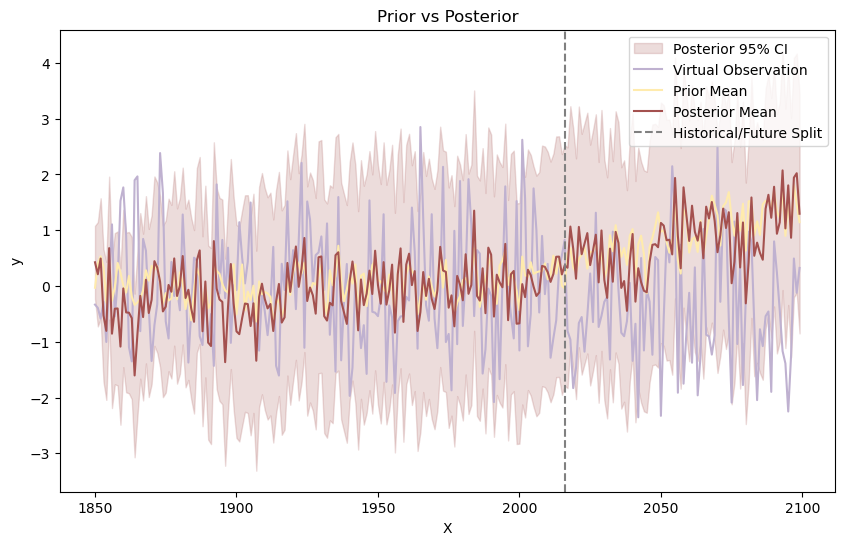

Starting iteration 12 out of 16


Optimization Progress (iteration 12):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.169e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.738e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -7.07e+06 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -8.326e+0 |  0.6

Optimization Progress (iteration 12):   0%|          | 0/100 [00:14<?, ?it/s]

|  50       | -5.242e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 12 - Best objective function value: -2247.3654088033
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 12 - test lml: -417.7216700596579


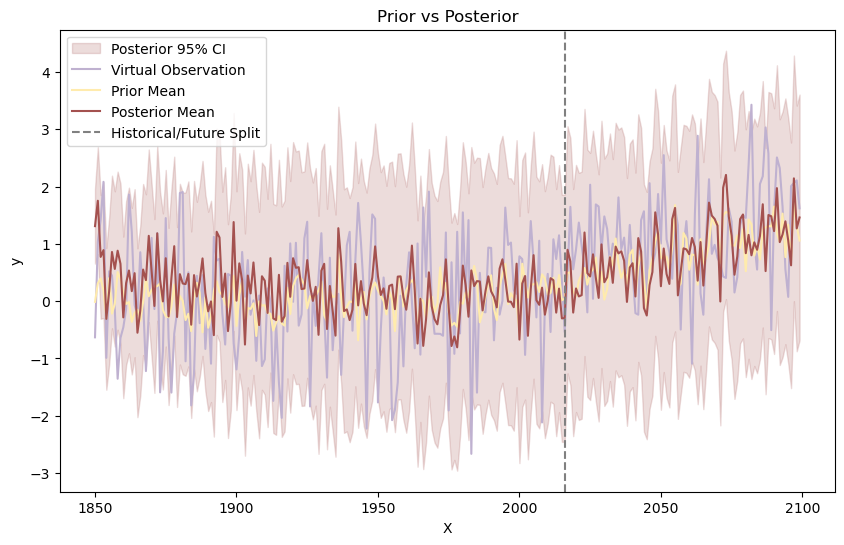

Starting iteration 13 out of 16


Optimization Progress (iteration 13):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.285e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.879e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -7.593e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -8.742e+0 |  0.6

Optimization Progress (iteration 13):   0%|          | 0/100 [00:14<?, ?it/s]

|  50       | -5.441e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 13 - Best objective function value: -2281.9332720333823
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 13 - test lml: -1090.4492398491084


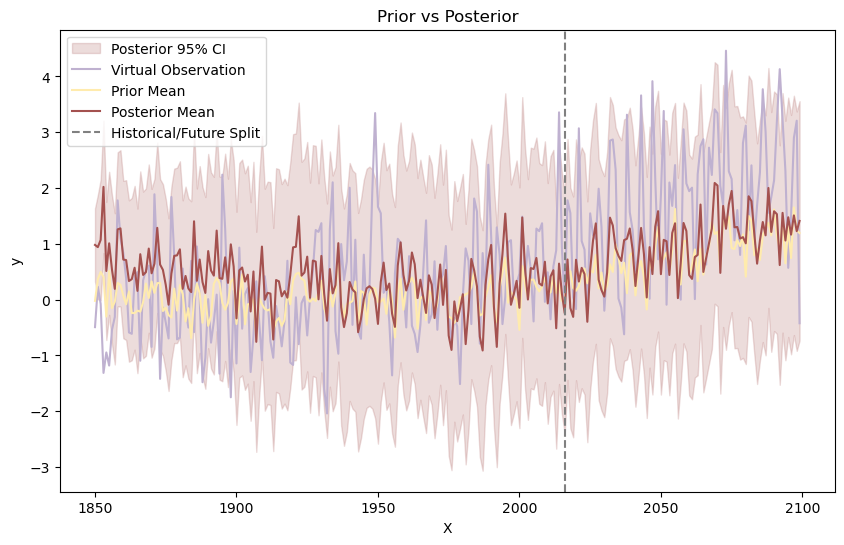

Starting iteration 14 out of 16


Optimization Progress (iteration 14):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.125e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.643e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -7.13e+06 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -8.575e+0 |  0.6

Optimization Progress (iteration 14):   0%|          | 0/100 [00:14<?, ?it/s]

|  50       | -5.22e+07 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 14 - Best objective function value: -2264.028967895604
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 14 - test lml: -680.8134977106198


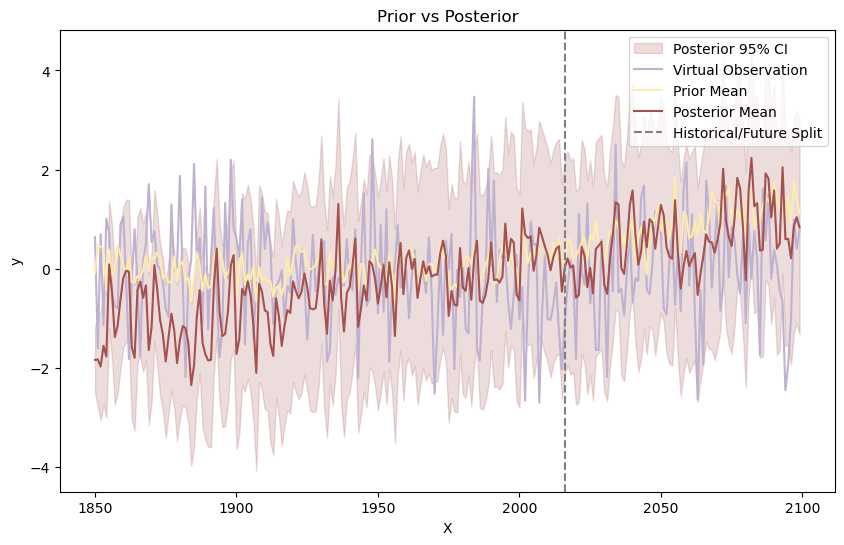

Starting iteration 15 out of 16


Optimization Progress (iteration 15):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.268e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.664e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -7.275e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -8.724e+0 |  0.6

Optimization Progress (iteration 15):   0%|          | 0/100 [00:14<?, ?it/s]

|  50       | -5.201e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 15 - Best objective function value: -2241.7721321590207
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 15 - test lml: -878.2948735488426


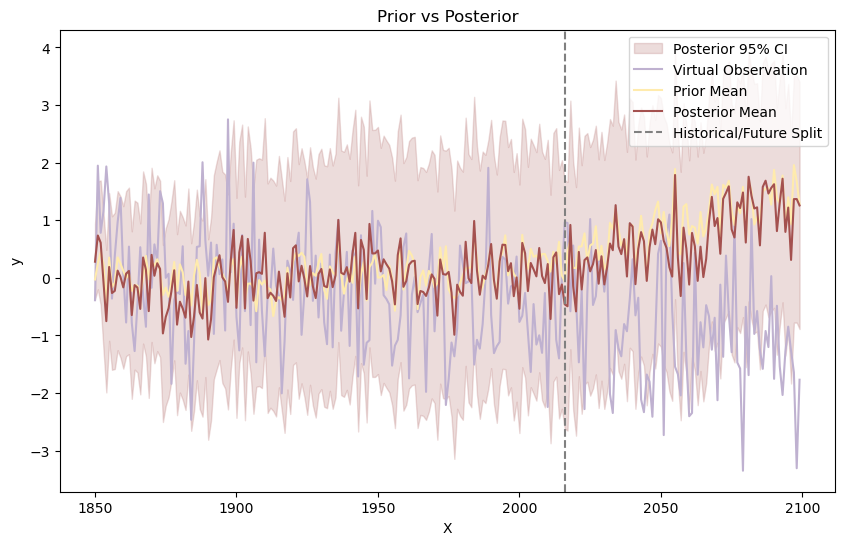

Starting iteration 16 out of 16


Optimization Progress (iteration 16):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.094e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.661e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -7.099e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -8.364e+0 |  0.6

Optimization Progress (iteration 16):   0%|          | 0/100 [00:14<?, ?it/s]

|  50       | -5.287e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 16 - Best objective function value: -2217.0392225571063
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 16 - test lml: -651.6481150715994


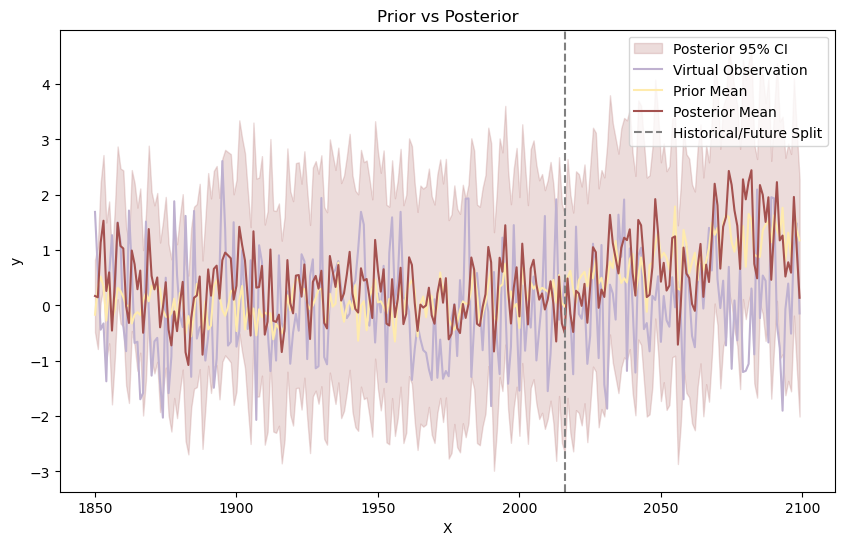

Total log marginal likelihood sum for the kernel structure: -17730.77783071907


-17730.77783071907

In [21]:
def polype3_rq_matern_rbf(best_params):
    custom_poly_kernel = C(best_params['constant1']) * CustomPolynomialKernel(degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']])
    original_kernel = (
        C(best_params['constant2']) * RQ(length_scale=best_params['rq_ls'], alpha=best_params['rq_alpha']) +
        C(best_params['constant3']) * Matern(length_scale=best_params['matern_length'], nu=best_params['nu']) +
        C(best_params['constant4']) * RBF(length_scale=best_params['rbf_length']) +
        WhiteKernel(noise_level=best_params['noise_level'])
    )
    return custom_poly_kernel + original_kernel

pbounds = {
    'period1': (3,7),
    'period2': (3,7),
    'period3': (3,7),
    'rq_alpha': (1e-2, 1e2),
    'matern_length': (1e0, 1e2),
    'noise_level': (1e-6, 1),
    'constant1': (1e-3, 1),
    'constant2': (1e-3, 1),
    'constant3': (1e-3, 1),
    'constant4': (1e-3, 1),
    'constant5': (1e-3, 1),
    'rbf_length': (1e-2, 1e2),
    'nu': (0.5, 2.5),
    'rq_ls': (1e-2, 1e2)
}

kernel_selection(mod_ids, Nobs, rainfall_yearly, pbounds, polype3_rq_matern_rbf)

-17730.77783071907

Starting iteration 1 out of 16


Optimization Progress (iteration 1):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.497e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.583e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -5.647e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 1):   0%|          | 0/100 [00:12<?, ?it/s]

|  50       | -9.551e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 1 - Best objective function value: -1887.1982972572114
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 1 - test lml: -456.0548905671995


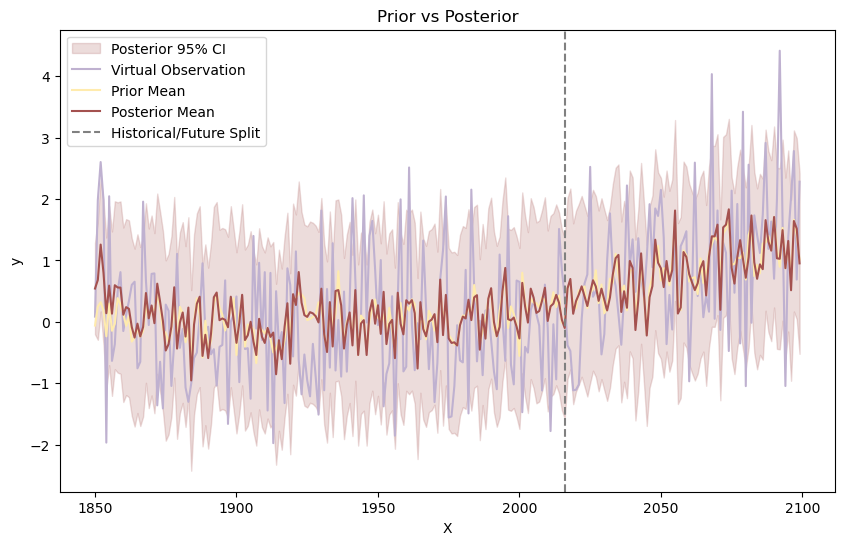

Starting iteration 2 out of 16


Optimization Progress (iteration 2):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.467e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.522e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -5.708e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 2):   0%|          | 0/100 [00:12<?, ?it/s]

|  50       | -9.034e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 2 - Best objective function value: -1865.4721497067671
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 2 - test lml: -532.3991144466997


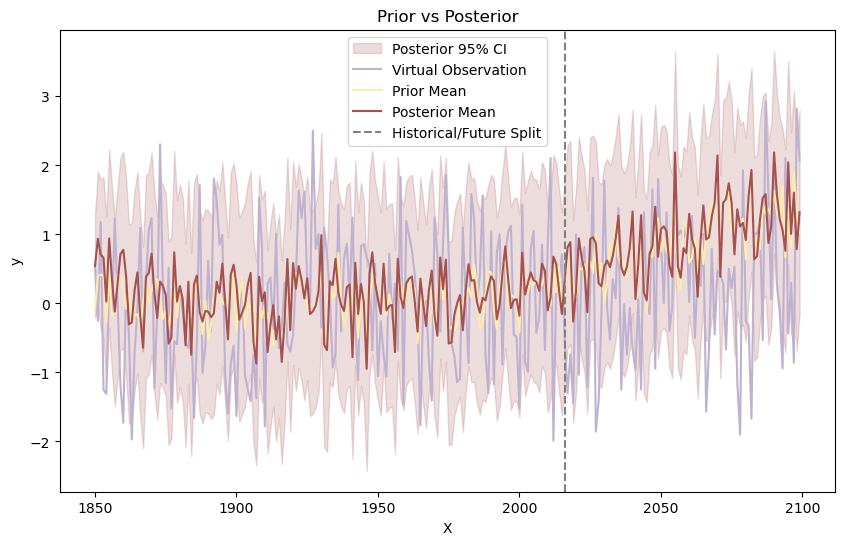

Starting iteration 3 out of 16


Optimization Progress (iteration 3):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.447e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.603e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -5.37e+03 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 3):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -9.512e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 3 - Best objective function value: -1851.916074303588
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 3 - test lml: -450.93615890611926


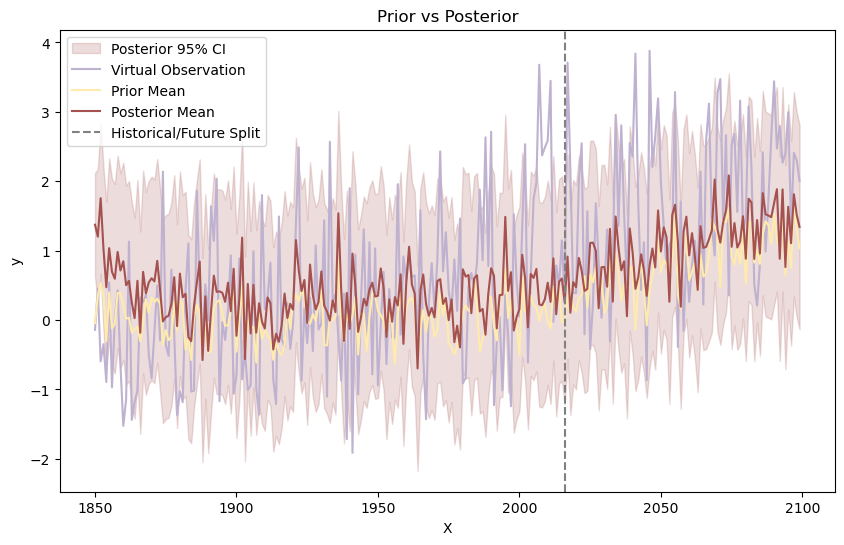

Starting iteration 4 out of 16


Optimization Progress (iteration 4):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.571e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.82e+04 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -5.511e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 4):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -9.633e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 4 - Best objective function value: -1896.8811131895993
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 4 - test lml: -322.4905258178584


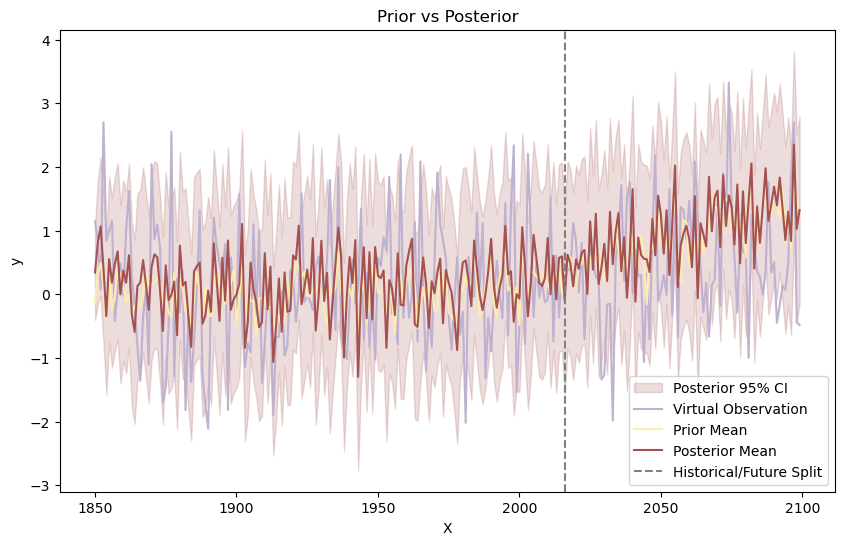

Starting iteration 5 out of 16


Optimization Progress (iteration 5):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.43e+03 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.318e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -5.138e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 5):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -8.753e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 5 - Best objective function value: -1840.7820423580729
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 5 - test lml: -3580.211088166213


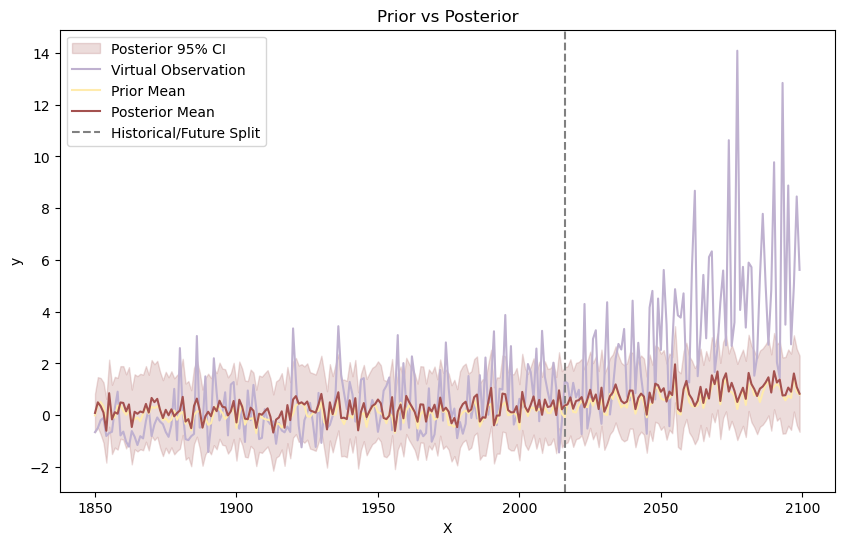

Starting iteration 6 out of 16


Optimization Progress (iteration 6):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.6e+03  |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.819e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -5.582e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 6):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -9.575e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 6 - Best objective function value: -1903.2382648184896
Best kernel is: 0.506**2 * CustomPolynomialKernel() + 0.516**2 * CustomPolynomialKernel() + 0.711**2 * CustomPolynomialKernel() + 0.516**2 * RationalQuadratic(alpha=0.184, length_scale=0.886) + 0.409**2 * Matern(length_scale=2.02, nu=0.76) + 0.527**2 * RBF(length_scale=9.89) + WhiteKernel(noise_level=0.163)


Iteration 6 - test lml: -597.8473909974858


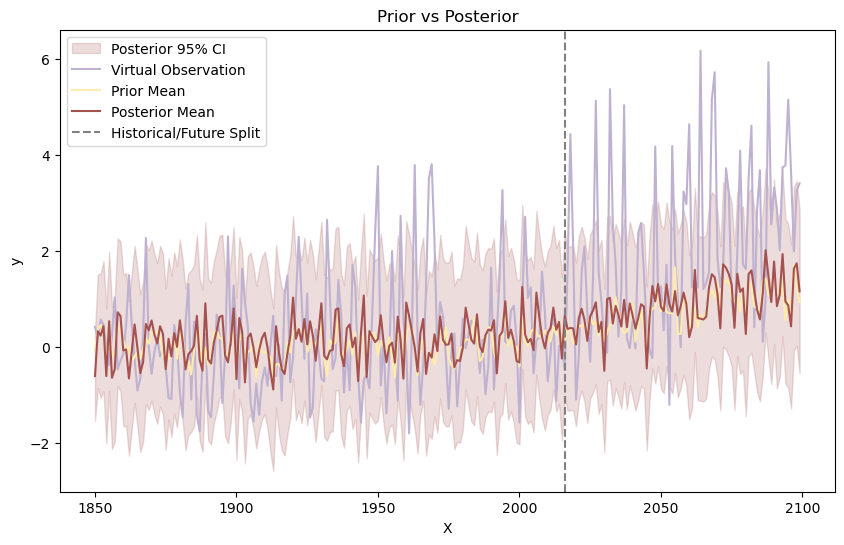

Starting iteration 7 out of 16


Optimization Progress (iteration 7):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.522e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.408e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -5.373e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 7):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -9.108e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 7 - Best objective function value: -1881.9860275700505
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 7 - test lml: -297.1394004762425


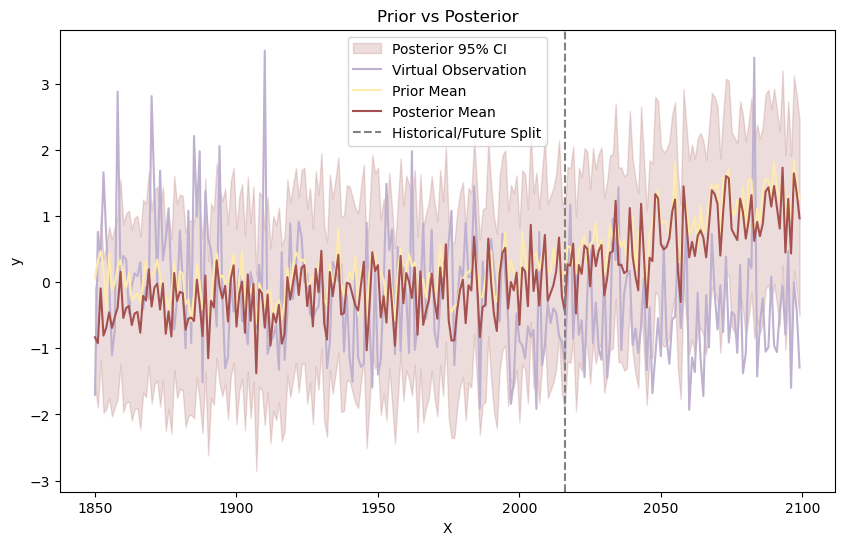

Starting iteration 8 out of 16


Optimization Progress (iteration 8):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.831e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -4.185e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -6.191e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 8):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -1.103e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 8 - Best objective function value: -1961.2453042479615
Best kernel is: 0.506**2 * CustomPolynomialKernel() + 0.516**2 * CustomPolynomialKernel() + 0.711**2 * CustomPolynomialKernel() + 0.516**2 * RationalQuadratic(alpha=0.184, length_scale=0.886) + 0.409**2 * Matern(length_scale=2.02, nu=0.76) + 0.527**2 * RBF(length_scale=9.89) + WhiteKernel(noise_level=0.163)


Iteration 8 - test lml: -541.8327753396093


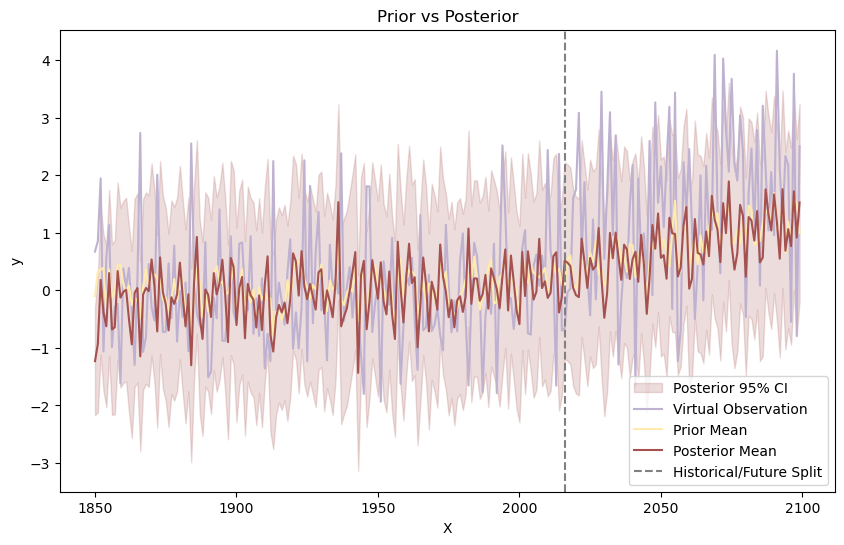

Starting iteration 9 out of 16


Optimization Progress (iteration 9):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.472e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.594e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -5.28e+03 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 9):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -9.331e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 9 - Best objective function value: -1832.863612975541
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 9 - test lml: -767.2912663193748


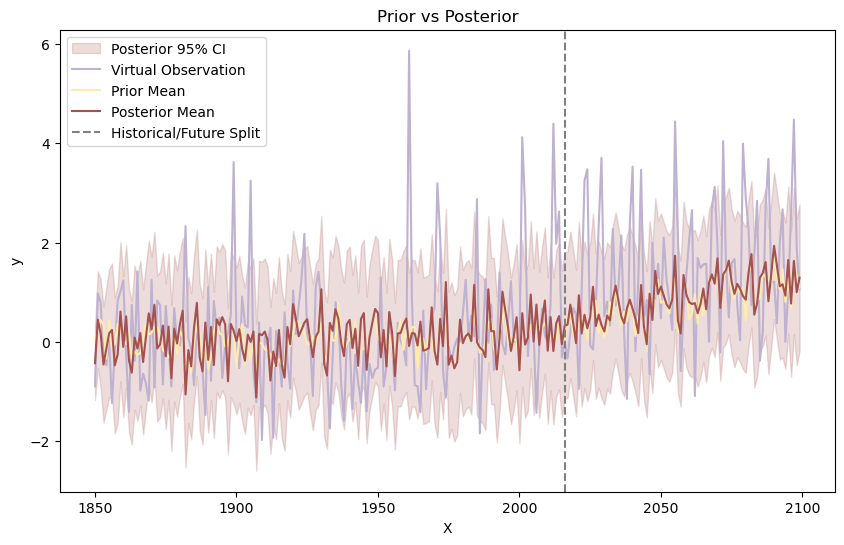

Starting iteration 10 out of 16


Optimization Progress (iteration 10):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.386e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.285e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -5.074e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 10):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -8.715e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 10 - Best objective function value: -1838.858691388097
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 10 - test lml: -440.92260573574555


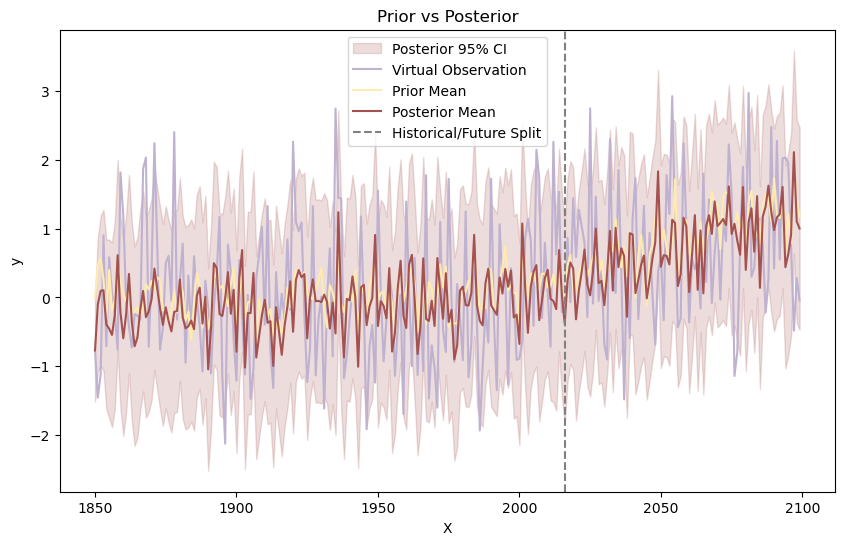

Starting iteration 11 out of 16


Optimization Progress (iteration 11):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.521e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.534e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -5.414e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 11):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -9.328e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 11 - Best objective function value: -1849.3219387848853
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 11 - test lml: -547.437222786416


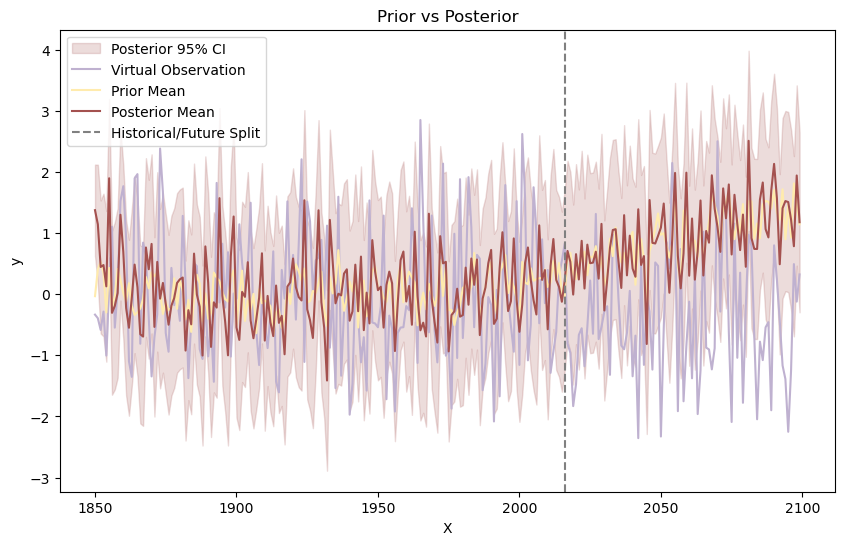

Starting iteration 12 out of 16


Optimization Progress (iteration 12):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.478e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.455e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -5.248e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 12):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -9.183e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 12 - Best objective function value: -1845.9796130921993
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 12 - test lml: -272.82930341667264


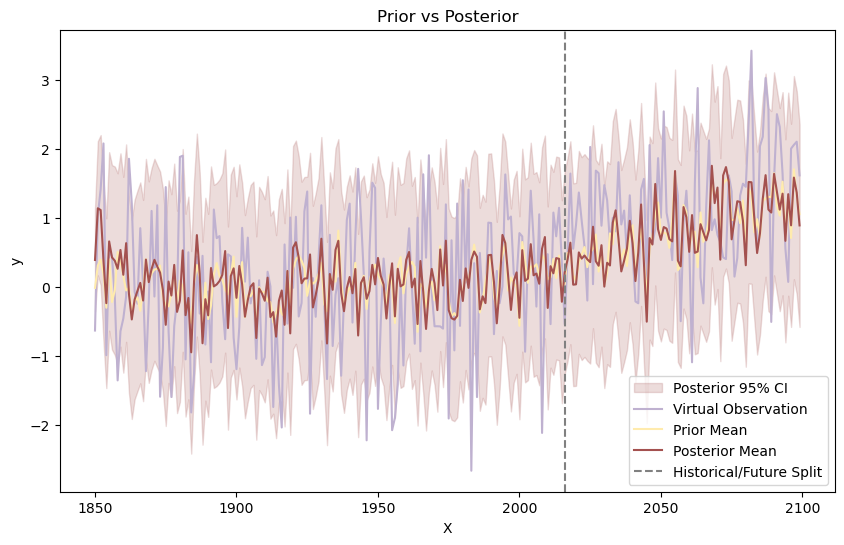

Starting iteration 13 out of 16


Optimization Progress (iteration 13):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.469e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.727e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -5.761e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 13):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -9.467e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 13 - Best objective function value: -1925.2046659736068
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 13 - test lml: -496.08686923148565


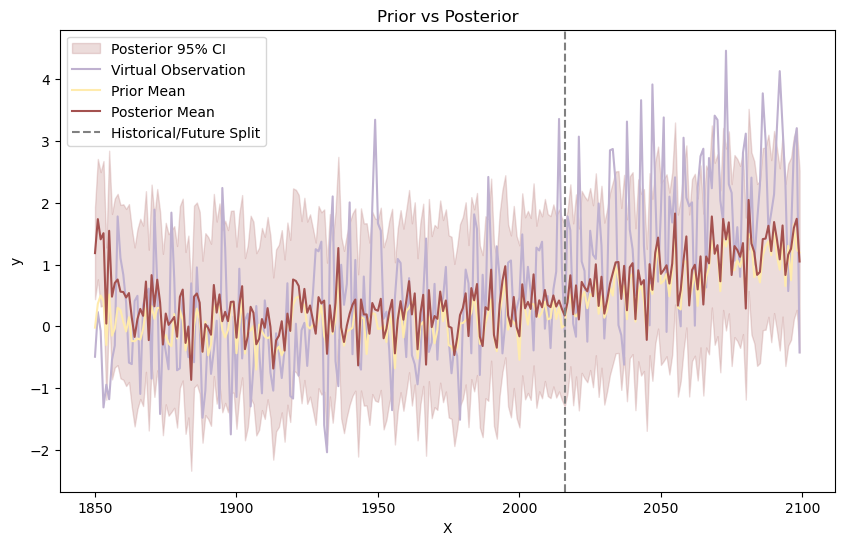

Starting iteration 14 out of 16


Optimization Progress (iteration 14):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.464e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.692e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -5.374e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 14):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -9.25e+04 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 14 - Best objective function value: -1850.7538560674827
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 14 - test lml: -339.76533190377444


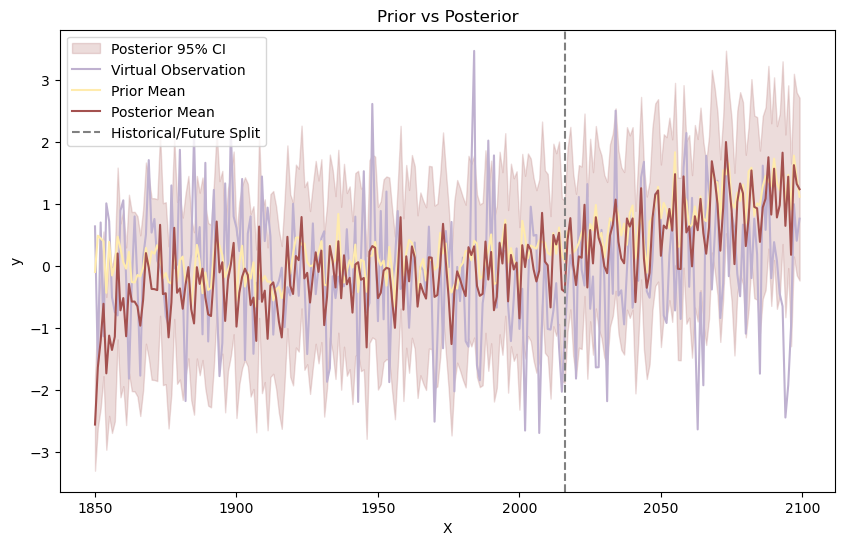

Starting iteration 15 out of 16


Optimization Progress (iteration 15):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.521e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.433e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -5.34e+03 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 15):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -9.19e+04 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 15 - Best objective function value: -1885.7482450107505
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 15 - test lml: -516.0409356443773


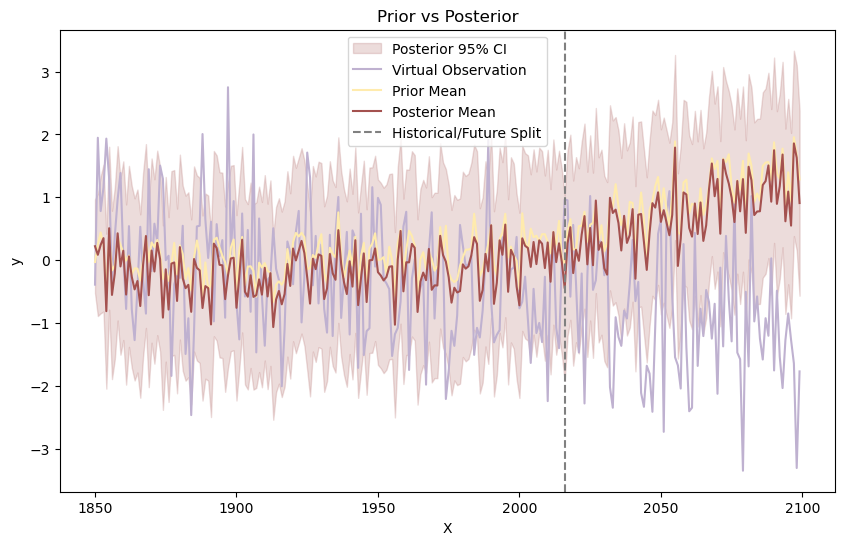

Starting iteration 16 out of 16


Optimization Progress (iteration 16):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.42e+03 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.365e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -5.186e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 16):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -8.845e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 16 - Best objective function value: -1852.1162871950007
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 16 - test lml: -358.78995555270524


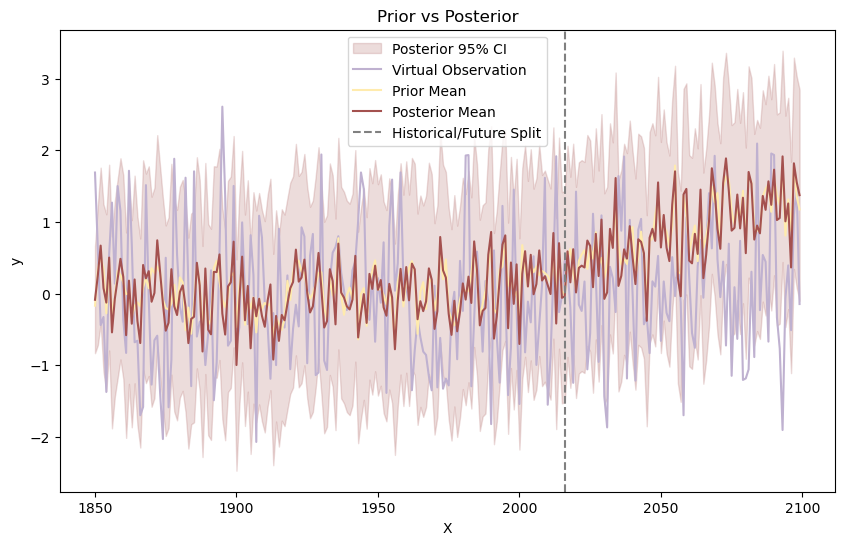

Total log marginal likelihood sum for the kernel structure: -10518.07483530798


-10518.07483530798

In [22]:
def polype3_rq_matern_rbf_true(best_params):
    custom_poly_kernel1 = C(best_params['constant1']) * CustomPolynomialKernel(degree=2, periods=best_params['period1'])
    custom_poly_kernel2 = C(best_params['constant2']) * CustomPolynomialKernel(degree=2, periods=best_params['period2'])
    custom_poly_kernel3 = C(best_params['constant3']) * CustomPolynomialKernel(degree=2, periods=best_params['period3'])
    
    original_kernel = (
        C(best_params['constant4']) * RQ(length_scale=best_params['rq_ls'], alpha=best_params['rq_alpha']) +
        C(best_params['constant5']) * Matern(length_scale=best_params['matern_length'], nu=best_params['nu']) +
        C(best_params['constant6']) * RBF(length_scale=best_params['rbf_length']) +
        WhiteKernel(noise_level=best_params['noise_level'])
    )
    
    return custom_poly_kernel1 + custom_poly_kernel2 + custom_poly_kernel3 + original_kernel

pbounds = {
    'period1':(3,7),
    'period2': (3,7),
    'period3': (3,7),
    'rq_alpha': (1e-2, 1),
    'matern_length': (1e0, 10),
    'noise_level': (1e-6, 1),
    'constant1': (1e-3, 1),
    'constant2': (1e-3, 1),
    'constant3': (1e-3, 1),
    'constant4': (1e-3, 0.5),
    'constant5': (1e-3, 0.5),
    'constant6': (1e-3, 0.5),
    'rbf_length': (1e-2, 10),
    'nu': (0.5, 2.5),
    'rq_ls': (1e-2, 10)
}

kernel_selection(mod_ids, Nobs, rainfall_yearly, pbounds, polype3_rq_matern_rbf_true)


-10518.07483530798

## original

Starting iteration 1 out of 16


Optimization Progress (iteration 1):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -7.208e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -2.198e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.993e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -5.828e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -4.392e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -5.113e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -5.989e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -6.645e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -5.622e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -6.623e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -5.677e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -4.787e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.704e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -5.784e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 1):   0%|          | 0/100 [00:00<?, ?it/s]

|  48       | -3.644e+0 |  0.2483   |  0.6635   |  3.333    |
|  49       | -1.21e+07 |  0.89     |  0.3875   |  2.336    |
|  50       | -6.585e+0 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 1 - Best objective function value: -2069.9955884179903
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 1 - test lml: -309.415056864927


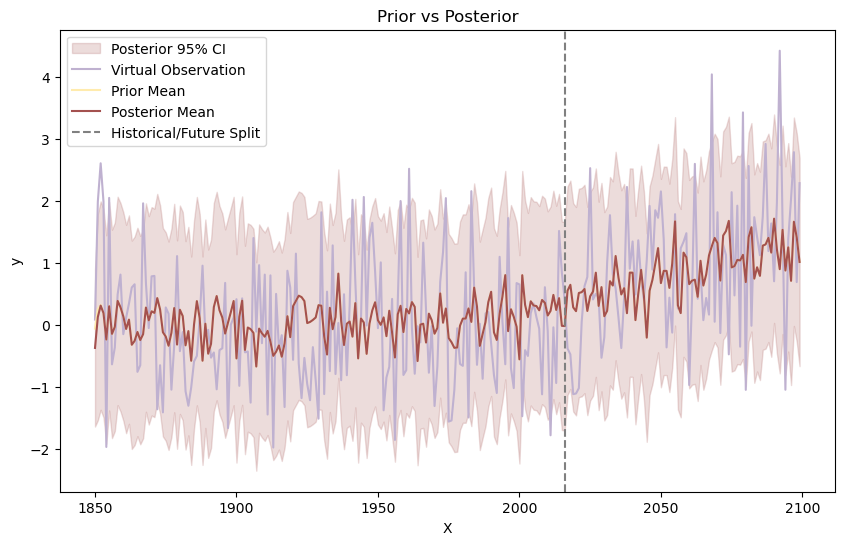

Starting iteration 2 out of 16


Optimization Progress (iteration 2):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -7.427e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -2.055e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.883e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -5.955e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -3.746e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -5.166e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -6.095e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -6.798e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -5.773e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -6.772e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -5.822e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -4.7e+07  |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.487e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -5.917e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 2):   0%|          | 0/100 [00:00<?, ?it/s]

|  47       | -5.206e+0 |  0.2103   |  0.6678   |  4.918    |
|  48       | -3.408e+0 |  0.2483   |  0.6635   |  3.333    |
|  49       | -1.1e+07  |  0.89     |  0.3875   |  2.336    |
|  50       | -6.729e+0 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 2 - Best objective function value: -2068.707242663467
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 2 - test lml: -340.8010628696876


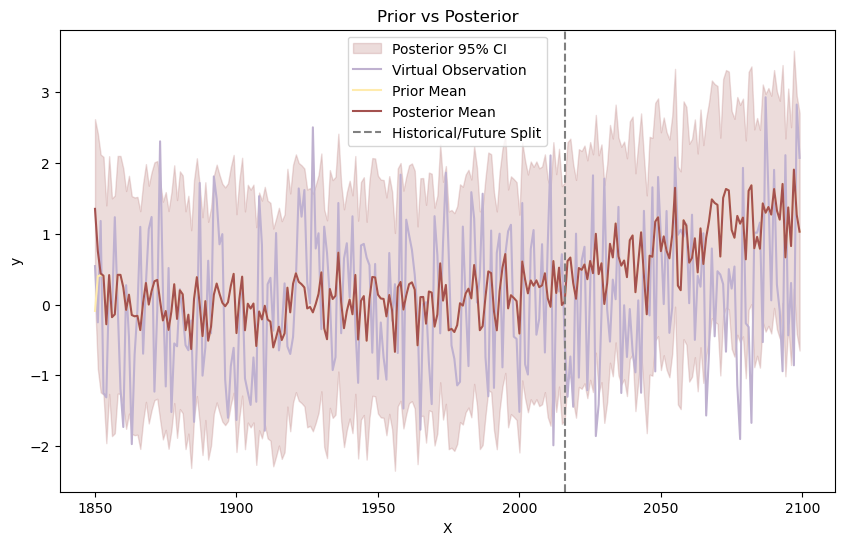

Starting iteration 3 out of 16


Optimization Progress (iteration 3):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -7.281e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -2.005e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.821e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -5.518e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -3.909e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -4.811e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -5.697e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -6.514e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -5.304e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -6.484e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -5.358e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -4.413e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.449e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -5.471e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 3):   0%|          | 0/100 [00:00<?, ?it/s]

|  50       | -6.44e+07 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 3 - Best objective function value: -2061.6736739168405
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 3 - test lml: -229.92210738902713


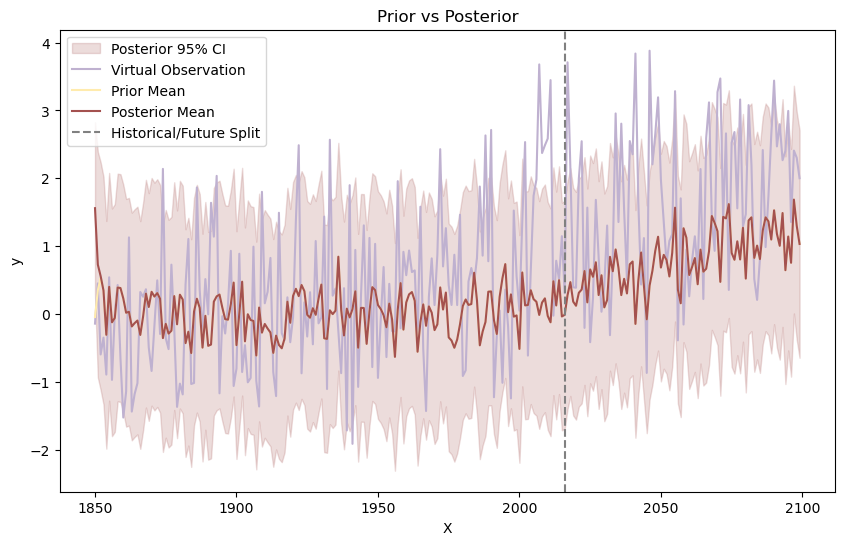

Starting iteration 4 out of 16


Optimization Progress (iteration 4):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -7.494e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -2.111e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.895e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -5.907e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -4.016e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -5.119e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -6.099e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -6.833e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -5.649e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -6.785e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -5.717e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -4.677e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.642e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -5.852e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 4):   0%|          | 0/100 [00:00<?, ?it/s]

|  45       | -6.227e+0 |  0.7792   |  0.304    |  6.62     |
|  46       | -4.134e+0 |  0.3356   |  0.2962   |  3.773    |
|  47       | -5.154e+0 |  0.2103   |  0.6678   |  4.918    |
|  48       | -3.554e+0 |  0.2483   |  0.6635   |  3.333    |
|  49       | -1.146e+0 |  0.89     |  0.3875   |  2.336    |
|  50       | -6.766e+0 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 4 - Best objective function value: -2068.374456050417
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 4 - test lml: -157.75656953498677


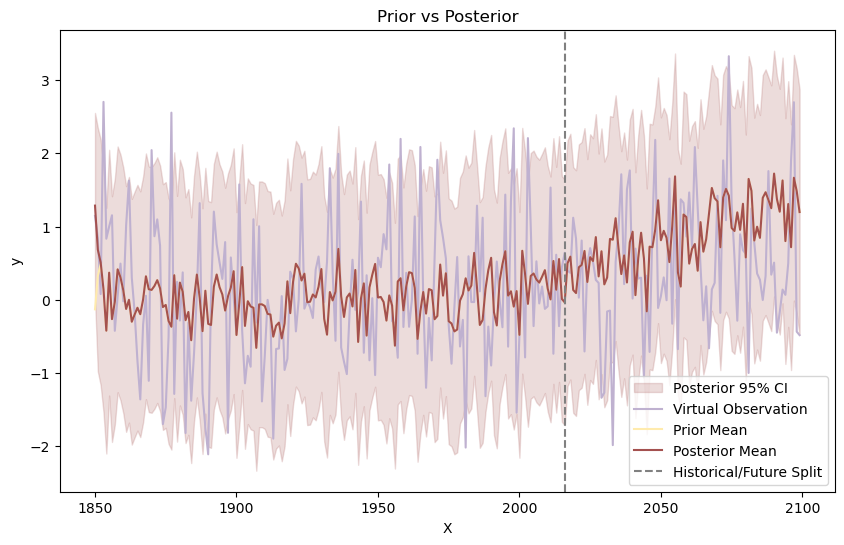

Starting iteration 5 out of 16


Optimization Progress (iteration 5):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -7.079e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -1.968e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.775e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -5.731e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -3.814e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -5.063e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -5.866e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -6.492e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -5.558e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -6.468e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -5.604e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -4.601e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.431e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -5.695e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 5):   0%|          | 0/100 [00:01<?, ?it/s]


Iteration 5 - Best objective function value: -2047.255561208534
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)
Iteration 5 - test lml: -1509.4923984653256


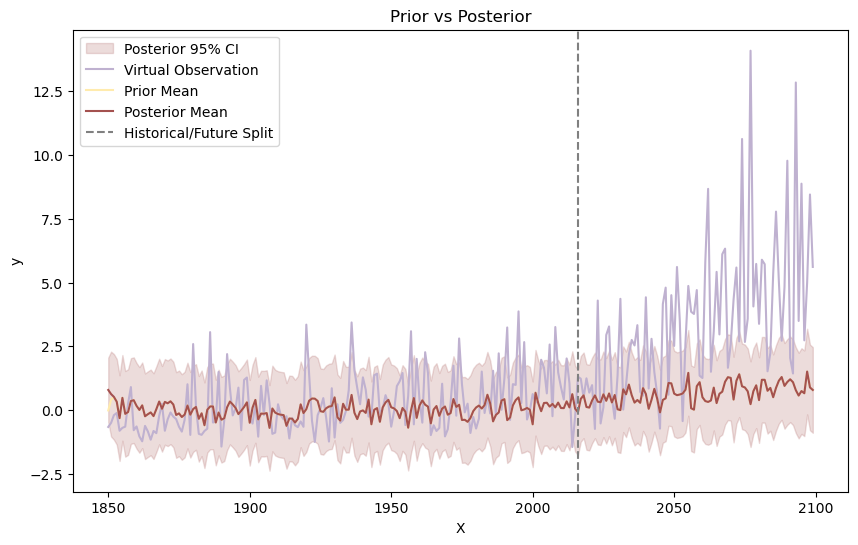

Starting iteration 6 out of 16


Optimization Progress (iteration 6):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -7.493e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -2.053e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.831e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -5.831e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -4.096e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -5.094e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -6.03e+07 |  0.6879   |  0.7595   |  6.427    |
|  8        | -6.921e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -5.607e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -6.887e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -5.663e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -4.663e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.604e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -5.78e+07 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 6):   0%|          | 0/100 [00:00<?, ?it/s]

|  47       | -5.131e+0 |  0.2103   |  0.6678   |  4.918    |
|  48       | -3.582e+0 |  0.2483   |  0.6635   |  3.333    |
|  49       | -1.087e+0 |  0.89     |  0.3875   |  2.336    |
|  50       | -6.843e+0 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 6 - Best objective function value: -2069.673267044973
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 6 - test lml: -539.2903003020341


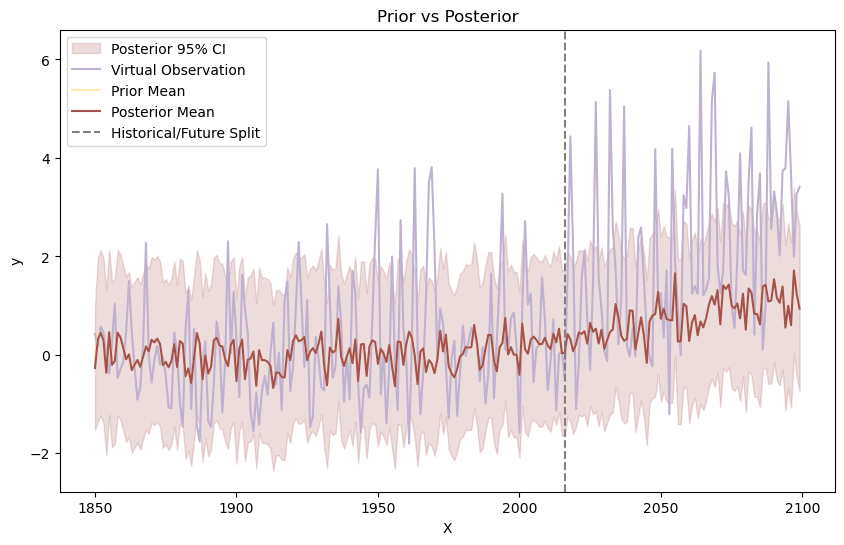

Starting iteration 7 out of 16


Optimization Progress (iteration 7):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -7.446e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -2.047e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.829e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -5.947e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -3.835e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -5.29e+07 |  0.553    |  0.8256   |  5.039    |
|  7        | -6.094e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -6.81e+07 |  0.3856   |  0.0801   |  8.077    |
|  9        | -5.77e+07 |  0.8117   |  0.05083  |  5.947    |
|  10       | -6.785e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -5.816e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -4.829e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.623e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -5.91e+07 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 7):   0%|          | 0/100 [00:00<?, ?it/s]

|  47       | -5.326e+0 |  0.2103   |  0.6678   |  4.918    |
|  48       | -3.682e+0 |  0.2483   |  0.6635   |  3.333    |
|  49       | -1.065e+0 |  0.89     |  0.3875   |  2.336    |
|  50       | -6.745e+0 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 7 - Best objective function value: -2065.3923446896424
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 7 - test lml: -214.31453303897538


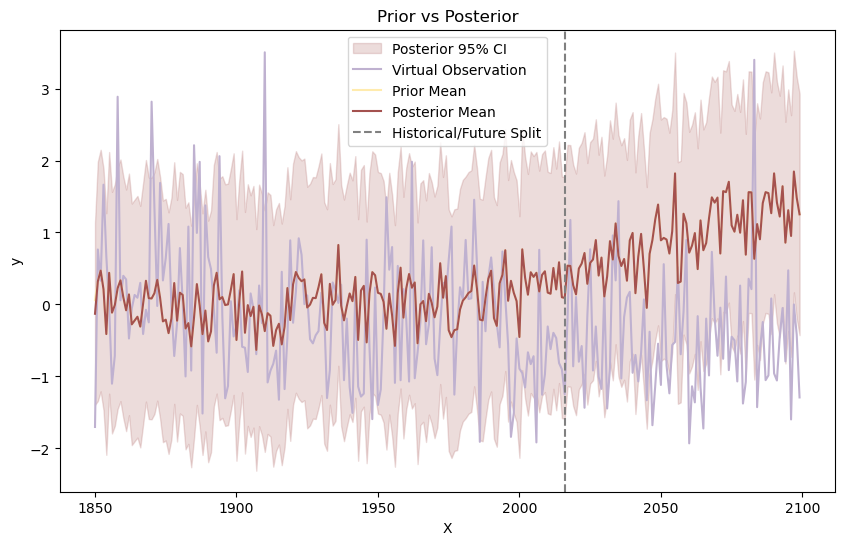

Starting iteration 8 out of 16


Optimization Progress (iteration 8):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -7.993e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -2.494e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -2.221e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -6.255e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -5.806e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -5.506e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -6.427e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -7.179e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -6.044e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -7.147e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -6.098e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -5.221e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -3.204e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -6.207e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 8):   0%|          | 0/100 [00:00<?, ?it/s]

|  49       | -1.389e+0 |  0.89     |  0.3875   |  2.336    |
|  50       | -7.117e+0 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 8 - Best objective function value: -2125.4730255206855
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 8 - test lml: -437.0351860295277


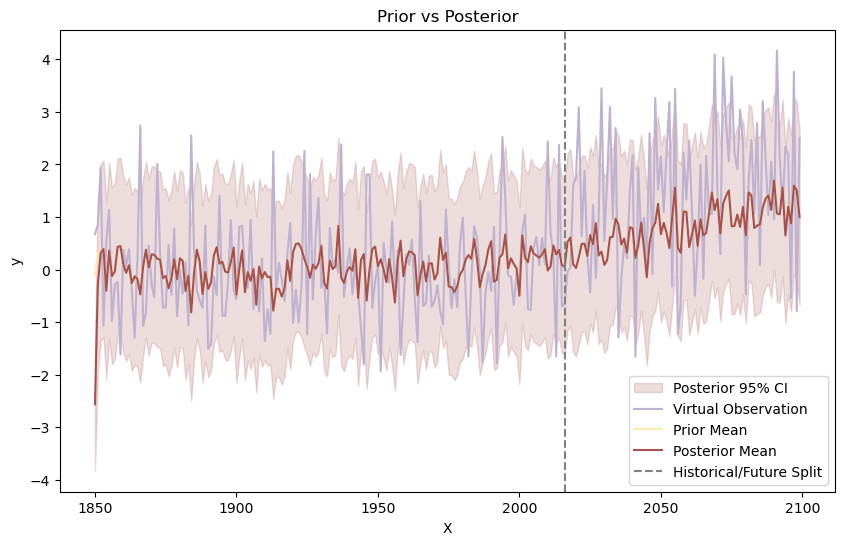

Starting iteration 9 out of 16


Optimization Progress (iteration 9):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -7.047e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -2.049e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.856e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -5.497e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -4.114e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -4.871e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -5.666e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -6.492e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -5.294e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -6.461e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -5.345e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -4.455e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.49e+07 |  0.5482   |  0.9565   |  2.847    |
|  14       | -5.452e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 9):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -1.145e+0 |  0.89     |  0.3875   |  2.336    |
|  50       | -6.406e+0 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 9 - Best objective function value: -2057.8731306662
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)
Iteration 9 - test lml: -249.11673935990956


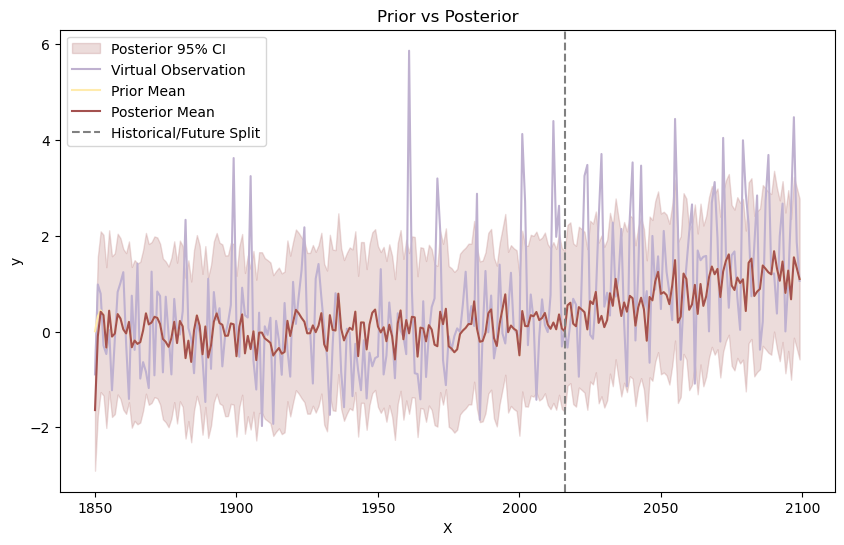

Starting iteration 10 out of 16


Optimization Progress (iteration 10):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -6.991e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -1.958e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.77e+07 |  0.3347   |  0.6446   |  2.522    |
|  4        | -5.52e+07 |  0.6356   |  0.5798   |  6.192    |
|  5        | -3.832e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -4.862e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -5.669e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -6.351e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -5.336e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -6.322e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -5.384e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -4.454e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.425e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -5.48e+07 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 10):   0%|          | 0/100 [00:01<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 10 - Best objective function value: -2049.435332831388
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)
Iteration 10 - test lml: -210.43144393774924

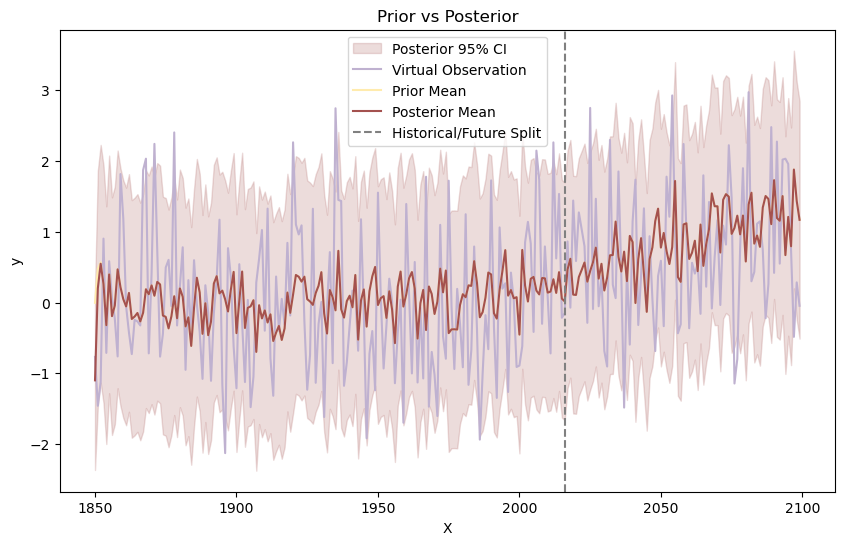

Starting iteration 11 out of 16


Optimization Progress (iteration 11):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -7.183e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -2.003e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.817e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -5.674e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -5.022e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -5.051e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -5.834e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -6.509e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -5.475e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -6.482e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -5.526e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -4.713e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.475e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -5.63e+07 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 11):   0%|          | 0/100 [00:01<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 11 - Best objective function value: -2071.7976338613744
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)
Iteration 11 - test lml: -267.2466089263147


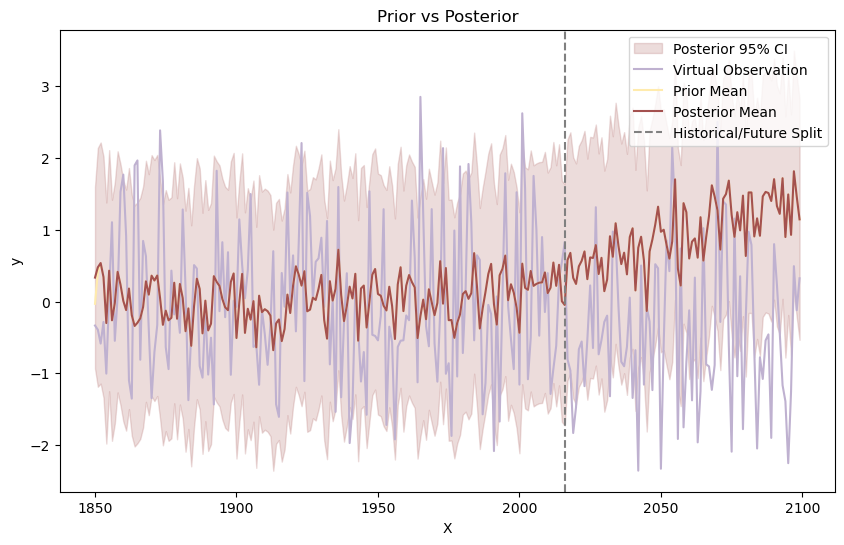

Starting iteration 12 out of 16


Optimization Progress (iteration 12):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -7.136e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -1.983e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.802e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -5.565e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -4.983e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -4.927e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -5.738e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -6.438e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -5.361e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -6.406e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -5.412e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -4.58e+07 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.439e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -5.52e+07 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 12):   0%|          | 0/100 [00:01<?, ?it/s]

|  41       | -6.386e+0 |  0.6023   |  0.5705   |  7.934    |
|  42       | -6.298e+0 |  0.4716   |  0.4767   |  7.423    |
|  43       | -3.238e+0 |  0.6355   |  0.8038   |  3.365    |
|  44       | -1.567e+0 |  0.2861   |  0.1758   |  1.553    |
|  45       | -5.864e+0 |  0.7792   |  0.304    |  6.62     |
|  46       | -4.025e+0 |  0.3356   |  0.2962   |  3.773    |
|  47       | -4.956e+0 |  0.2103   |  0.6678   |  4.918    |
|  48       | -3.39e+07 |  0.2483   |  0.6635   |  3.333    |
|  49       | -1.142e+0 |  0.89     |  0.3875   |  2.336    |
|  50       | -6.374e+0 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.


Iteration 12 - Best objective function value: -2060.9143048505703
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)
Iteration 12 - test lml: -83.08939951134255


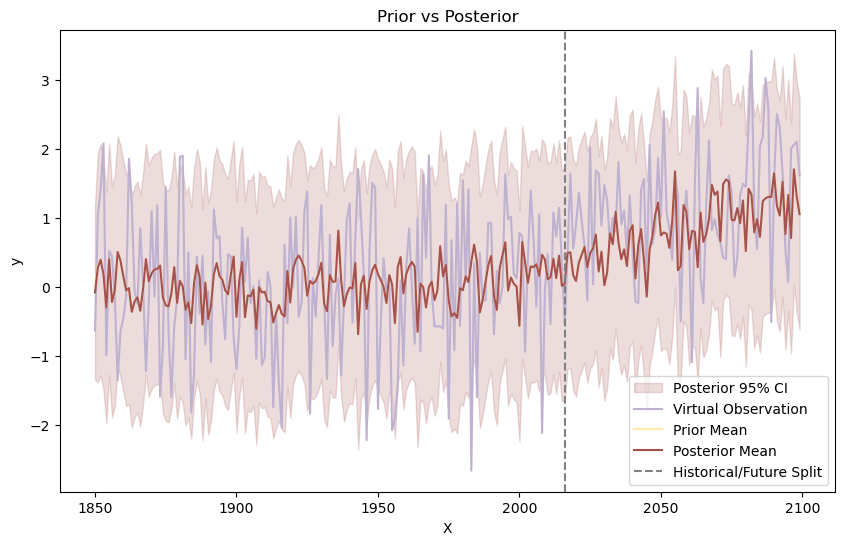

Starting iteration 13 out of 16


Optimization Progress (iteration 13):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -7.43e+07 |  0.1539   |  0.1577   |  9.855    |
|  2        | -2.222e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -2.018e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -6.188e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -3.797e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -5.379e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -6.325e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -6.863e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -6.006e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -6.846e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -6.056e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -4.92e+07 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.715e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -6.148e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 13):   0%|          | 0/100 [00:01<?, ?it/s]

|  47       | -5.417e+0 |  0.2103   |  0.6678   |  4.918    |
|  48       | -3.886e+0 |  0.2483   |  0.6635   |  3.333    |
|  49       | -1.124e+0 |  0.89     |  0.3875   |  2.336    |
|  50       | -6.813e+0 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 13 - Best objective function value: -2071.872437817433
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 13 - test lml: -276.7817680944285


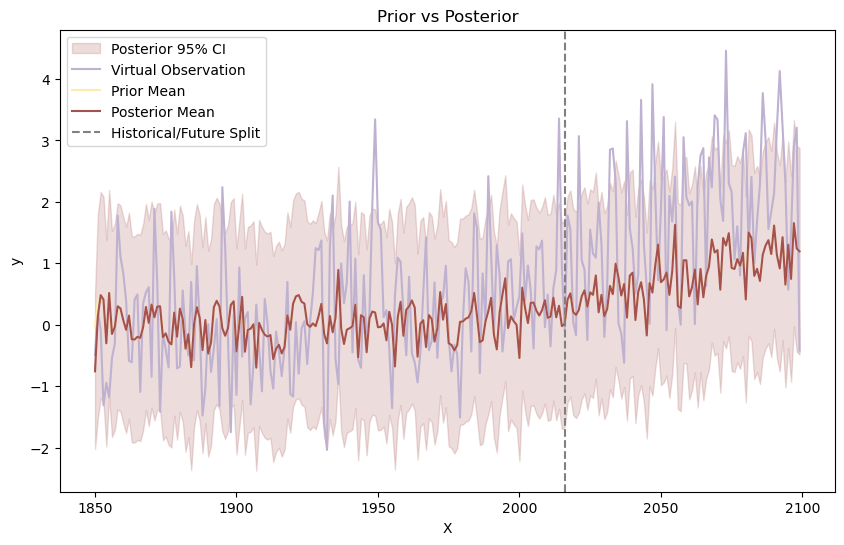

Starting iteration 14 out of 16


Optimization Progress (iteration 14):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -7.143e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -2.011e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.848e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -5.533e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -4.057e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -4.826e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -5.716e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -6.49e+07 |  0.3856   |  0.0801   |  8.077    |
|  9        | -5.312e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -6.458e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -5.368e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -4.47e+07 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.418e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -5.484e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 14):   0%|          | 0/100 [00:01<?, ?it/s]

|  46       | -3.977e+0 |  0.3356   |  0.2962   |  3.773    |
|  47       | -4.858e+0 |  0.2103   |  0.6678   |  4.918    |
|  48       | -3.324e+0 |  0.2483   |  0.6635   |  3.333    |
|  49       | -1.156e+0 |  0.89     |  0.3875   |  2.336    |
|  50       | -6.438e+0 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 14 - Best objective function value: -2067.335918292666
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 14 - test lml: -216.99642263688887


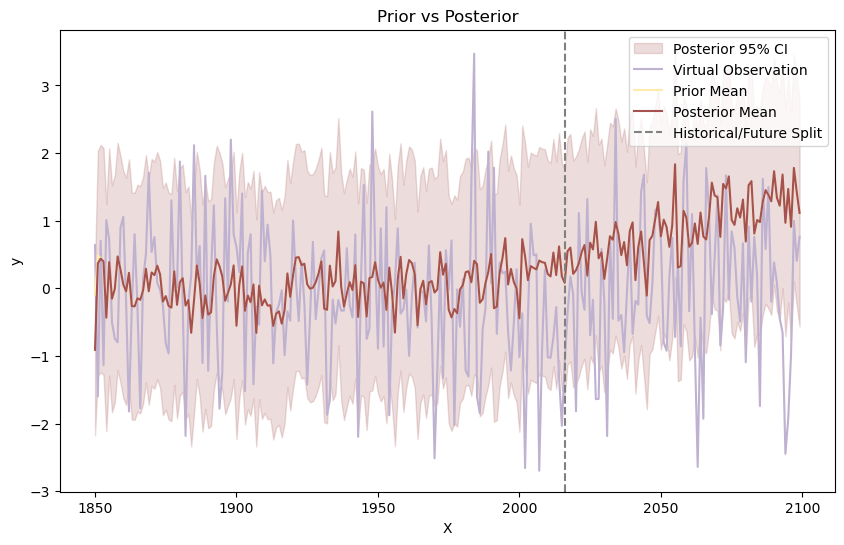

Starting iteration 15 out of 16


Optimization Progress (iteration 15):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -7.367e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -2.131e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.917e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -5.826e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -4.143e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -5.088e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -5.99e+07 |  0.6879   |  0.7595   |  6.427    |
|  8        | -6.759e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -5.615e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -6.725e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -5.672e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -4.703e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.685e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -5.783e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 15):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -1.14e+07 |  0.89     |  0.3875   |  2.336    |
|  50       | -6.67e+07 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 15 - Best objective function value: -2067.9788402098357
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)
Iteration 15 - test lml: -333.9242230330358

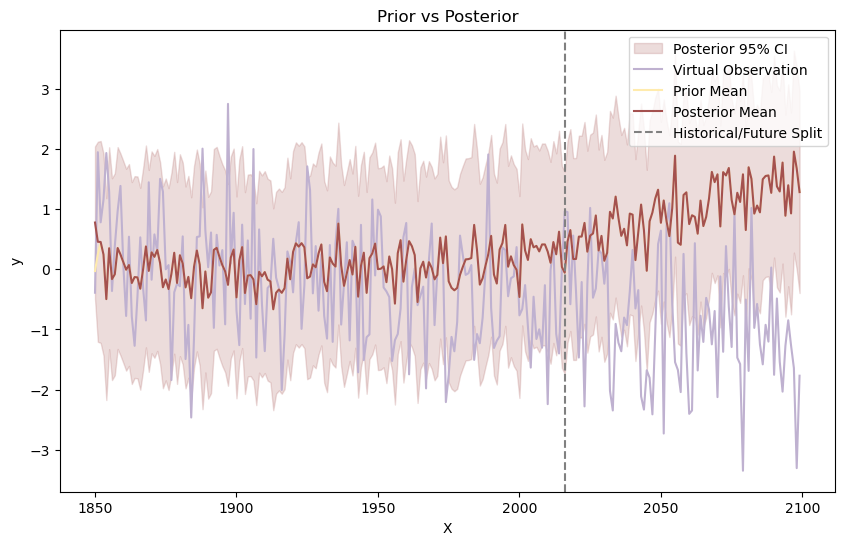

Starting iteration 16 out of 16


Optimization Progress (iteration 16):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -7.551e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -2.001e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.819e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -5.868e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -3.731e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -4.991e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -6.053e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -6.713e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -5.63e+07 |  0.8117   |  0.05083  |  5.947    |
|  10       | -6.681e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -5.692e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -4.467e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.419e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -5.815e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 16):   0%|          | 0/100 [00:01<?, ?it/s]

|  48       | -3.291e+0 |  0.2483   |  0.6635   |  3.333    |
|  49       | -1.059e+0 |  0.89     |  0.3875   |  2.336    |
|  50       | -6.655e+0 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 16 - Best objective function value: -2061.5156342116916
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 16 - test lml: -197.0729958400561


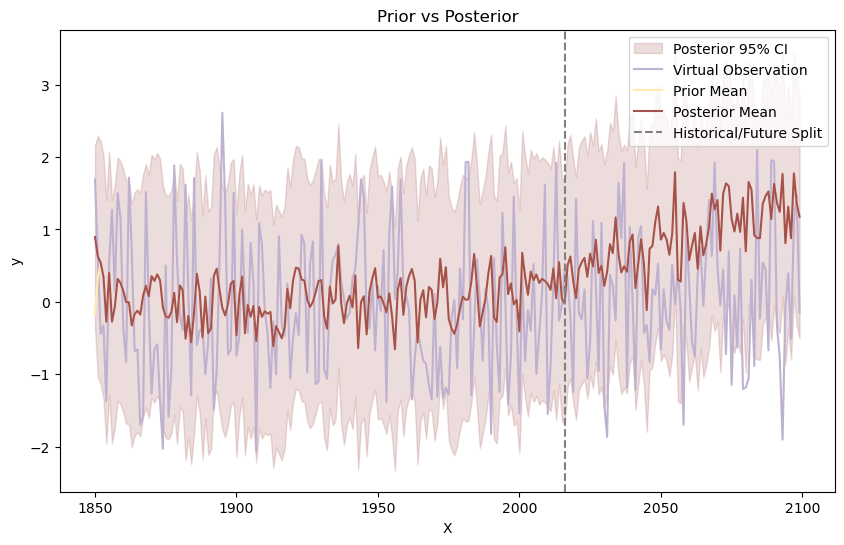

Total log marginal likelihood sum for the kernel structure: -5572.686815834217


-5572.686815834217

In [23]:
def rbf(best_params):
    combined_kernel = (
        C(best_params['constant_rbf']) * RBF(length_scale=best_params['rbf_length']) +
        WhiteKernel(noise_level=best_params['noise_level'])
    )
    return combined_kernel

pbounds = {
    'rbf_length': (1e-2, 10),   
    'noise_level': (1e-6, 1),   
    'constant_rbf': (1e-3, 1),   
}

kernel_selection(mod_ids, Nobs, rainfall_yearly, pbounds, rbf)

-5572.686815834217